## Evaluating how the base parameter affects DTEs performance 

In [35]:
import torch
import torch.nn as nn
import torch.nn.init as init
import random
from tqdm import tqdm
import copy
from sklearn.model_selection import train_test_split
from torch.utils.data import TensorDataset, DataLoader
import numpy as np
import matplotlib.pyplot as plt
import DeepTreeEnsemble
import torch.nn.functional as F
from copy import deepcopy
from DeepTreeEnsemble import DeepTreeEnsemble, create_dataloaders_for_dataset 
# if this ^ doesn't work, try 'pip install -e .' in the root directory of it. Make sure you are in 
# the desired environment. 

create dataloaders

In [36]:
train_dataloader, test_dataloader, input_size, output_size = create_dataloaders_for_dataset('wine', batch_size=32)

add a model

In [1]:
class MLP(nn.Module):
    def __init__(self, input_size, hidden_layers, output_size, dropout=.5):
        super(MLP, self).__init__()
        self.layers = nn.ModuleList()
        self.batch_norms = nn.ModuleList()

        # Create the first hidden layer
        self.layers.append(nn.Linear(input_size, hidden_layers[0]))
        self.batch_norms.append(nn.BatchNorm1d(hidden_layers[0]))

        # Create additional hidden layers
        for i in range(1, len(hidden_layers)):
            self.layers.append(nn.Linear(hidden_layers[i-1], hidden_layers[i]))
            self.batch_norms.append(nn.BatchNorm1d(hidden_layers[i]))

        # Output layer
        self.output = nn.Linear(hidden_layers[-1], output_size)

        # Dropout layer
        self.dropout = nn.Dropout(dropout)


    def forward(self, x):
        i = 0
        for layer, batch_norm in zip(self.layers, self.batch_norms):
            # x = F.relu(batch_norm(layer(x)))
            i=i+1
            x = self.dropout(x)
            # print('Layer dtype: ', layer.weight.dtype)
            x = x.to(torch.float32) # <-- area of concern
            # print('tensor dytpe: ', x.dtype)
            # layer.weight = layer.weight.to(torch.float32)
            x = F.relu(batch_norm(layer(x)))
            
            # print(f'dtype is {x.dtype} after layer {i}')

        x = self.output(x)
        return x

NameError: name 'nn' is not defined

create DTEs and test

In [38]:
# specify model
hidden_layers = [10, 10, 10]
multiLayerPerceptron = MLP(input_size=input_size, hidden_layers=hidden_layers, output_size=output_size+1) #hidden size default at 100

# Fill DTE params
modelSaveDirectory = './saved_models'
coverDTEmlp4b = DeepTreeEnsemble(task_name='multi-classification',
                                model_arch=multiLayerPerceptron,
                                model_dir=modelSaveDirectory, 
                                base_number=4,
                                epochs=100,
                                train_dataloader=train_dataloader, 
                                test_dataloader=test_dataloader,
                                learning_rate=0.001)

coverDTEmlp8b = DeepTreeEnsemble(task_name='multi-classification',
                                model_arch=multiLayerPerceptron,
                                model_dir=modelSaveDirectory, 
                                base_number=8,
                                epochs=100,
                                train_dataloader=train_dataloader, 
                                test_dataloader=test_dataloader,
                                learning_rate=0.0001)

coverDTEmlp16b = DeepTreeEnsemble(task_name='multi-classification',
                                model_arch=multiLayerPerceptron,
                                model_dir=modelSaveDirectory, 
                                base_number=16,
                                epochs=100,
                                train_dataloader=train_dataloader, 
                                test_dataloader=test_dataloader,
                                learning_rate=0.001)

coverDTEmlp32b = DeepTreeEnsemble(task_name='multi-classification',
                                model_arch=multiLayerPerceptron,
                                model_dir=modelSaveDirectory, 
                                base_number=32,
                                epochs=100,
                                train_dataloader=train_dataloader, 
                                test_dataloader=test_dataloader,
                                learning_rate=0.001)

coverDTEmlp64b = DeepTreeEnsemble(task_name='multi-classification',
                                model_arch=multiLayerPerceptron,
                                model_dir=modelSaveDirectory, 
                                base_number=64,
                                epochs=100,
                                train_dataloader=train_dataloader, 
                                test_dataloader=test_dataloader,
                                learning_rate=0.001)

<built-in function iter>


Training Process: 100%|██████████| 200/200 [00:02<00:00, 96.13it/s] 


Total Epochs: 200
Train loss start: 1.4781551361083984, Train loss end: 0.0019838507287204266
Highest Train Accuracy: 16.75
Test loss start: 1.4422615766525269, Test loss end: 1.3708916412724648e-05
Highest Test Accuracy: 12.25


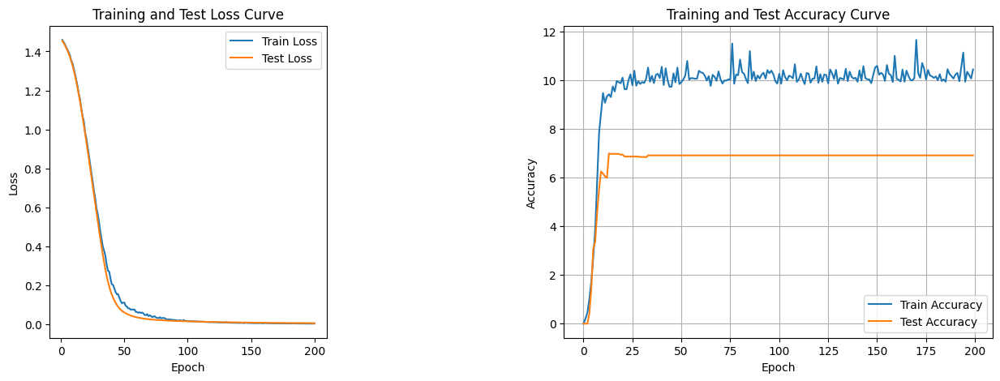

In [40]:
training_loop(deepcopy(multiLayerPerceptron), 200)

# Base: 4

0
1
2
3
model1 and model2 are different.
1


Training Process:   0%|          | 0/100 [00:00<?, ?it/s]

Training Process: 100%|██████████| 100/100 [00:02<00:00, 37.23it/s]


Total Epochs: 100
Train loss start: 2.1331534385681152, Train loss end: 0.8362551331520081
Highest Train Accuracy: 13.125
Test loss start: 1.7250820398330688, Test loss end: 0.551523745059967
Highest Test Accuracy: 11.59375


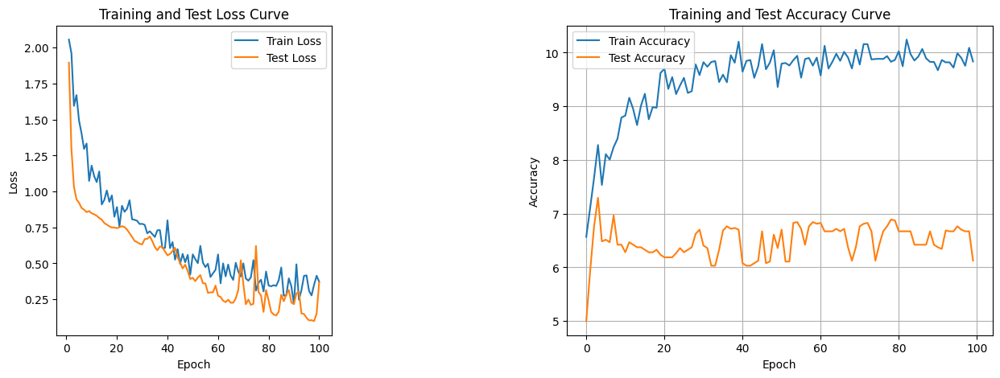

./saved_modelsmodel_1.pth
2


Training Process: 100%|██████████| 100/100 [00:02<00:00, 34.28it/s]


Total Epochs: 100
Train loss start: 1.695227026939392, Train loss end: 0.30554530024528503
Highest Train Accuracy: 13.5
Test loss start: 1.559423804283142, Test loss end: 0.18670158088207245
Highest Test Accuracy: 11.125


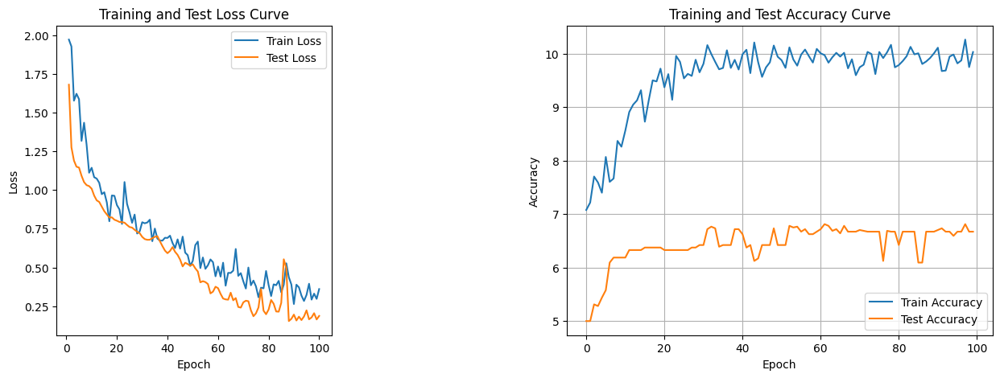

./saved_modelsmodel_2.pth
3


Training Process: 100%|██████████| 100/100 [00:02<00:00, 37.16it/s]


Total Epochs: 100
Train loss start: 1.7305033206939697, Train loss end: 0.3271621763706207
Highest Train Accuracy: 12.65625
Test loss start: 1.1924989223480225, Test loss end: 0.20268261432647705
Highest Test Accuracy: 11.25


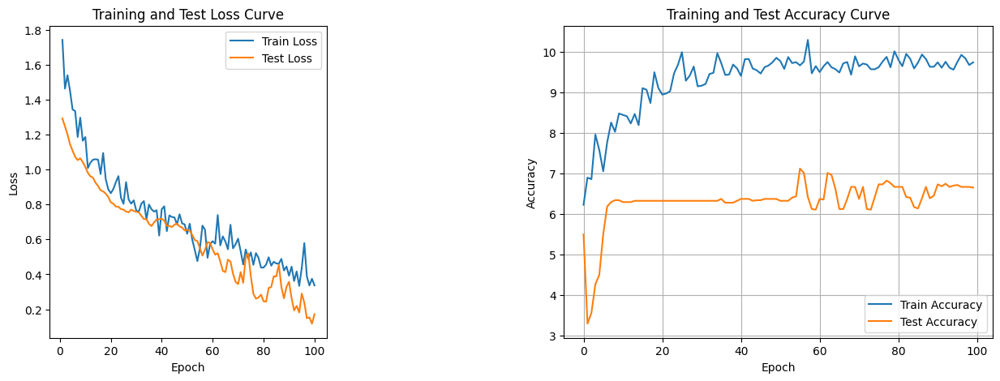

./saved_modelsmodel_3.pth
4


Training Process: 100%|██████████| 100/100 [00:02<00:00, 35.24it/s]


Total Epochs: 100
Train loss start: 1.8455730676651, Train loss end: 0.9037384390830994
Highest Train Accuracy: 12.75
Test loss start: 1.5891550779342651, Test loss end: 0.8413034677505493
Highest Test Accuracy: 11.15625


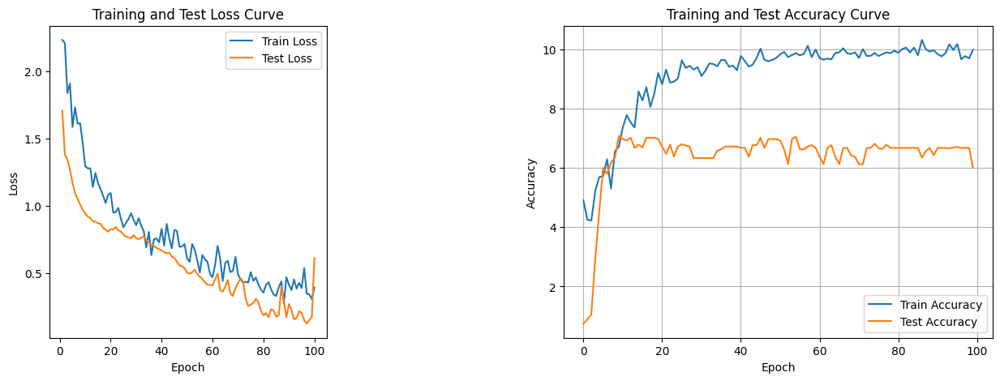

./saved_modelsmodel_4.pth
7


Training Process: 100%|██████████| 100/100 [00:02<00:00, 38.87it/s]


Total Epochs: 100
Train loss start: 0.28544217348098755, Train loss end: 0.20491531491279602
Highest Train Accuracy: 13.28125
Test loss start: 0.16604487597942352, Test loss end: 0.15498508512973785
Highest Test Accuracy: 10.9375


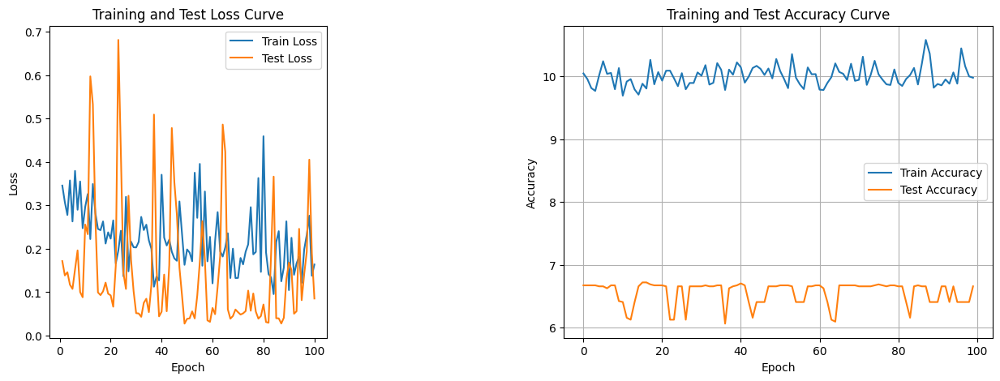

./saved_modelsmodel_7.pth
8


Training Process: 100%|██████████| 100/100 [00:02<00:00, 34.17it/s]


Total Epochs: 100
Train loss start: 0.06052945554256439, Train loss end: 0.05617090314626694
Highest Train Accuracy: 15.0
Test loss start: 0.22891449928283691, Test loss end: 0.009500999003648758
Highest Test Accuracy: 11.03125


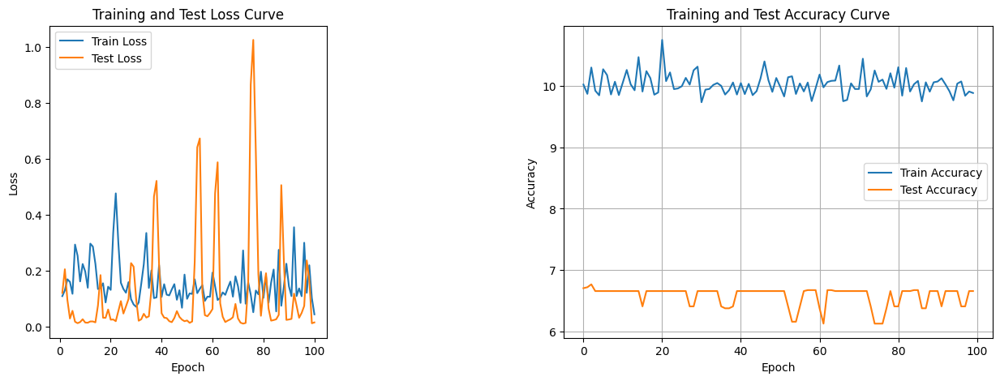

./saved_modelsmodel_8.pth
6


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.56it/s]


Total Epochs: 100
Train loss start: 0.06604122370481491, Train loss end: 0.017694197595119476
Highest Train Accuracy: 14.6875
Test loss start: 0.06736773252487183, Test loss end: 0.012543550692498684
Highest Test Accuracy: 11.09375


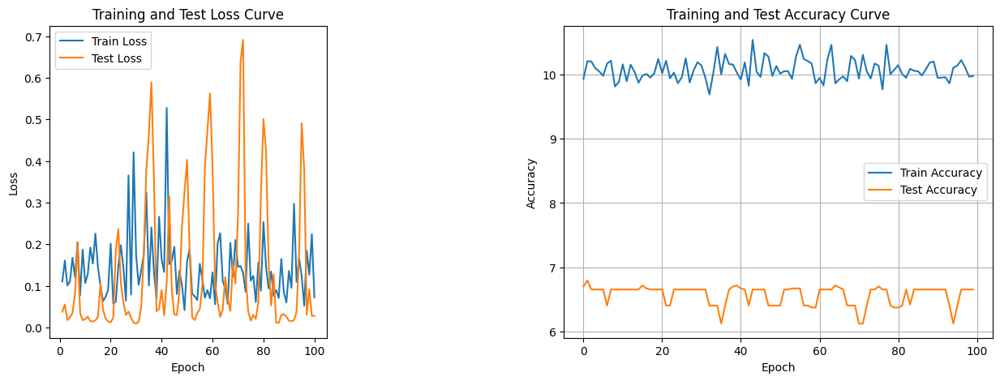

./saved_modelsmodel_6.pth


MLP(
  (layers): ModuleList(
    (0): Linear(in_features=13, out_features=256, bias=True)
    (1): Linear(in_features=256, out_features=128, bias=True)
    (2): Linear(in_features=128, out_features=64, bias=True)
    (3): Linear(in_features=64, out_features=32, bias=True)
  )
  (batch_norms): ModuleList(
    (0): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (output): Linear(in_features=32, out_features=4, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
)

In [6]:
coverDTEmlp4b.train_DTE()

# Base: 8

0
1
2
3
4
5
6
7
model1 and model2 are different.
1


Training Process: 100%|██████████| 100/100 [00:02<00:00, 33.78it/s]


Total Epochs: 100
Train loss start: 2.04006028175354, Train loss end: 1.3700867891311646
Highest Train Accuracy: 10.6875
Test loss start: 1.6628446578979492, Test loss end: 1.12418532371521
Highest Test Accuracy: 9.9375


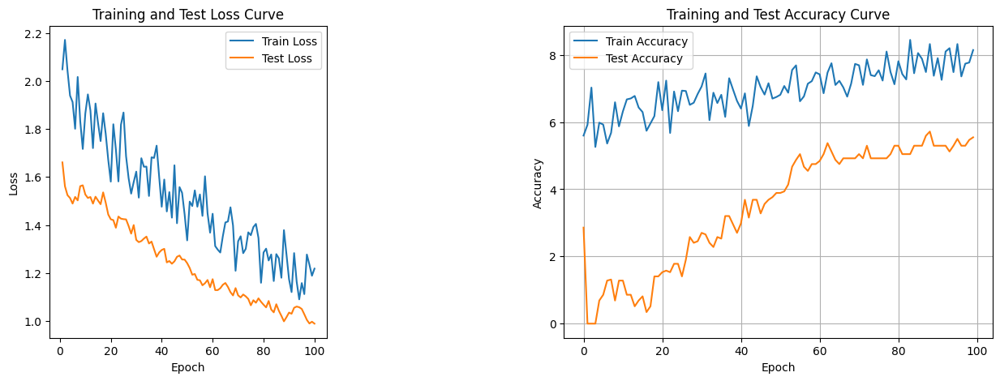

./saved_modelsmodel_1.pth
2


Training Process: 100%|██████████| 100/100 [00:02<00:00, 33.46it/s]


Total Epochs: 100
Train loss start: 2.0650410652160645, Train loss end: 0.9146906733512878
Highest Train Accuracy: 12.375
Test loss start: 1.7463629245758057, Test loss end: 0.8823555707931519
Highest Test Accuracy: 9.34375


KeyboardInterrupt: 

In [76]:
coverDTEmlp8b.train_DTE()

# Base: 16

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
model1 and model2 are different.
1


Training Process: 100%|██████████| 100/100 [00:03<00:00, 27.24it/s]


Total Epochs: 100
Train loss start: 2.5157928466796875, Train loss end: 0.35478177666664124
Highest Train Accuracy: 13.40625
Test loss start: 1.4629403352737427, Test loss end: 0.502726137638092
Highest Test Accuracy: 10.75


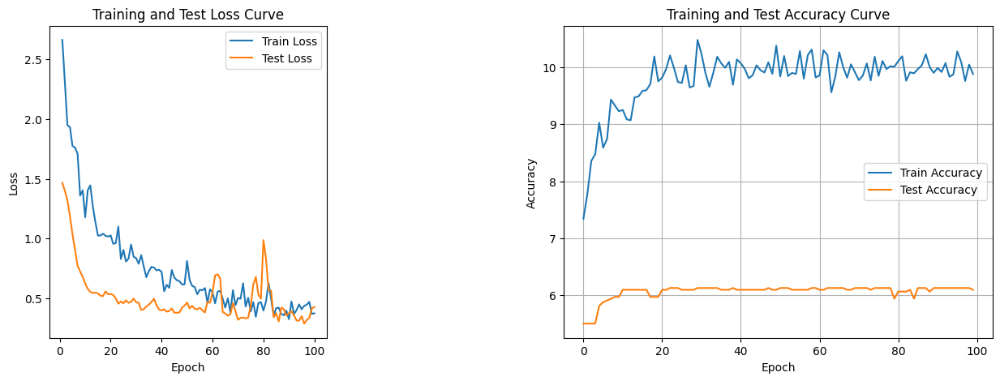

./saved_modelsmodel_1.pth
2


Training Process: 100%|██████████| 100/100 [00:03<00:00, 27.42it/s]


Total Epochs: 100
Train loss start: 2.5620200634002686, Train loss end: 0.1621534675359726
Highest Train Accuracy: 13.28125
Test loss start: 1.3547289371490479, Test loss end: 0.2561352849006653
Highest Test Accuracy: 12.0


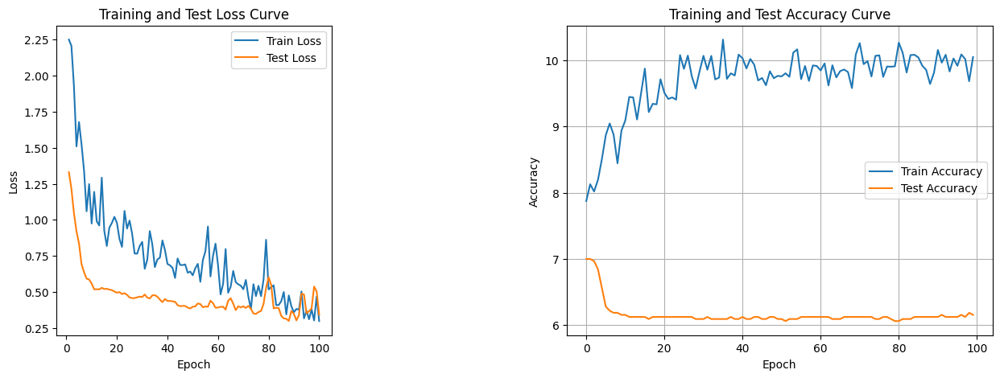

./saved_modelsmodel_2.pth
3


Training Process: 100%|██████████| 100/100 [00:03<00:00, 25.03it/s]


Total Epochs: 100
Train loss start: 4.093227386474609, Train loss end: 0.4955276548862457
Highest Train Accuracy: 15.46875
Test loss start: 1.6402626037597656, Test loss end: 0.3066217601299286
Highest Test Accuracy: 10.8125


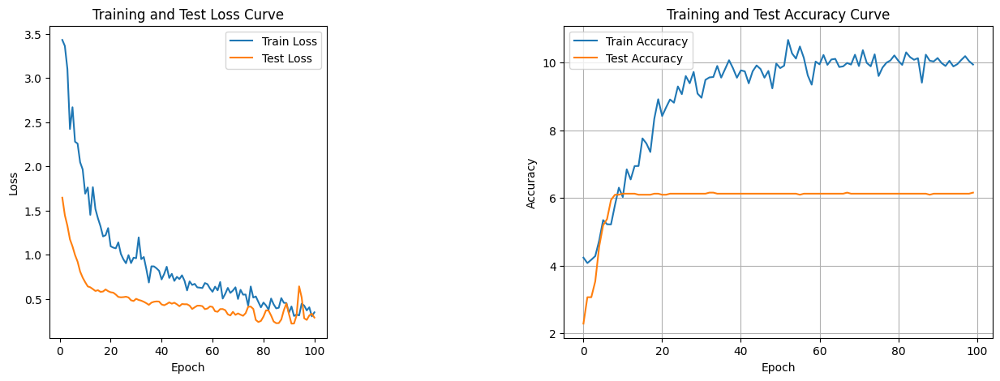

./saved_modelsmodel_3.pth
4


Training Process: 100%|██████████| 100/100 [00:03<00:00, 26.32it/s]


Total Epochs: 100
Train loss start: 3.043003559112549, Train loss end: 0.5513003468513489
Highest Train Accuracy: 12.625
Test loss start: 1.6241294145584106, Test loss end: 1.1042978763580322
Highest Test Accuracy: 10.75


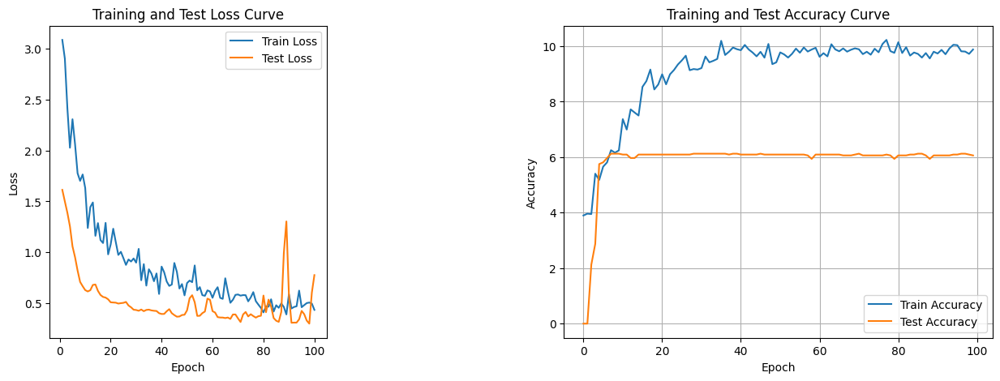

./saved_modelsmodel_4.pth
5


Training Process: 100%|██████████| 100/100 [00:03<00:00, 27.65it/s]


Total Epochs: 100
Train loss start: 2.734457492828369, Train loss end: 0.4043494760990143
Highest Train Accuracy: 14.625
Test loss start: 1.3041155338287354, Test loss end: 1.0565441846847534
Highest Test Accuracy: 11.75


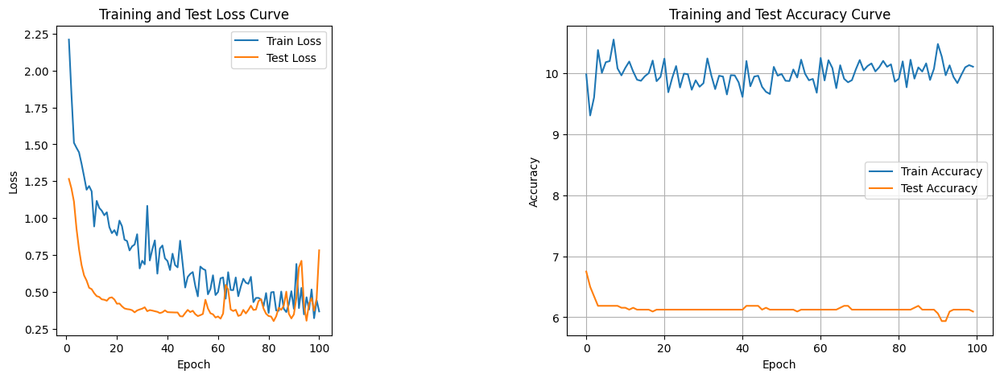

./saved_modelsmodel_5.pth
6


Training Process: 100%|██████████| 100/100 [00:03<00:00, 26.29it/s]


Total Epochs: 100
Train loss start: 2.7973859310150146, Train loss end: 1.5364130735397339
Highest Train Accuracy: 13.5
Test loss start: 1.3962663412094116, Test loss end: 0.3305082321166992
Highest Test Accuracy: 11.6875


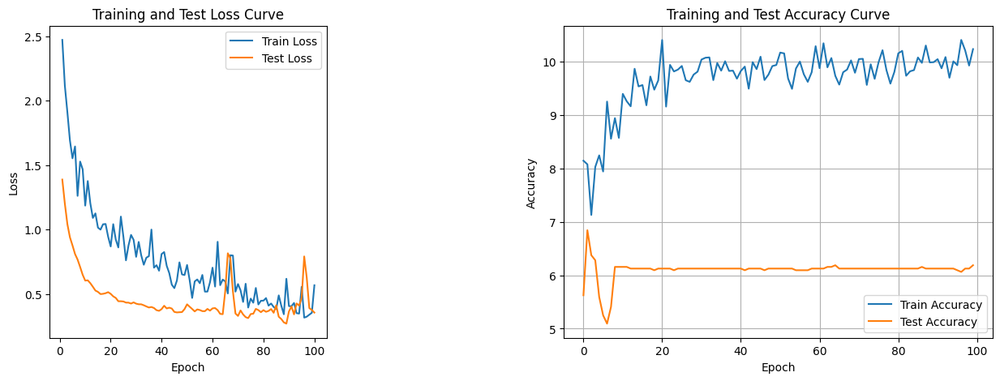

./saved_modelsmodel_6.pth
7


Training Process: 100%|██████████| 100/100 [00:03<00:00, 30.03it/s]


Total Epochs: 100
Train loss start: 2.507338285446167, Train loss end: 0.33700495958328247
Highest Train Accuracy: 14.03125
Test loss start: 1.216161847114563, Test loss end: 0.295699805021286
Highest Test Accuracy: 12.0


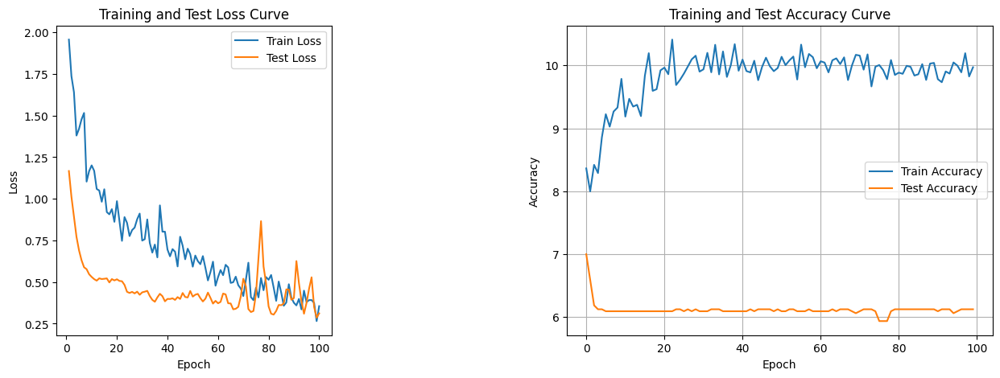

./saved_modelsmodel_7.pth
8


Training Process: 100%|██████████| 100/100 [00:03<00:00, 29.29it/s]


Total Epochs: 100
Train loss start: 3.2129745483398438, Train loss end: 0.2379768043756485
Highest Train Accuracy: 13.125
Test loss start: 1.6253998279571533, Test loss end: 0.2130340337753296
Highest Test Accuracy: 10.875


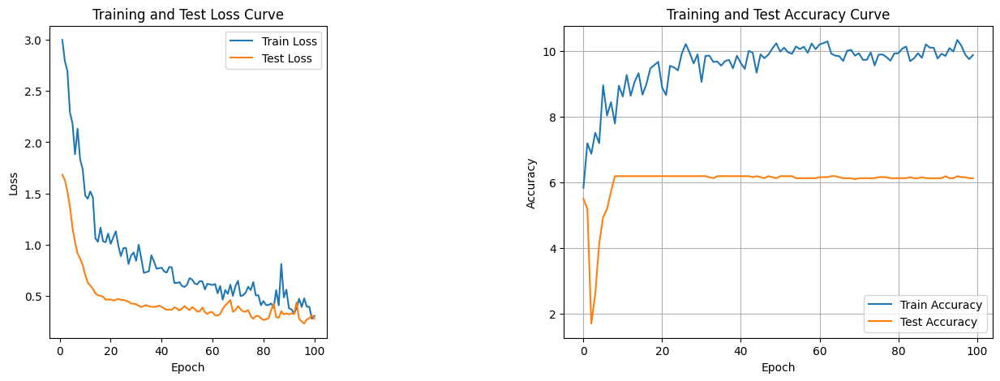

./saved_modelsmodel_8.pth
9


Training Process: 100%|██████████| 100/100 [00:03<00:00, 28.20it/s]


Total Epochs: 100
Train loss start: 2.6050281524658203, Train loss end: 0.42484596371650696
Highest Train Accuracy: 13.5
Test loss start: 1.2986093759536743, Test loss end: 0.5241415500640869
Highest Test Accuracy: 11.875


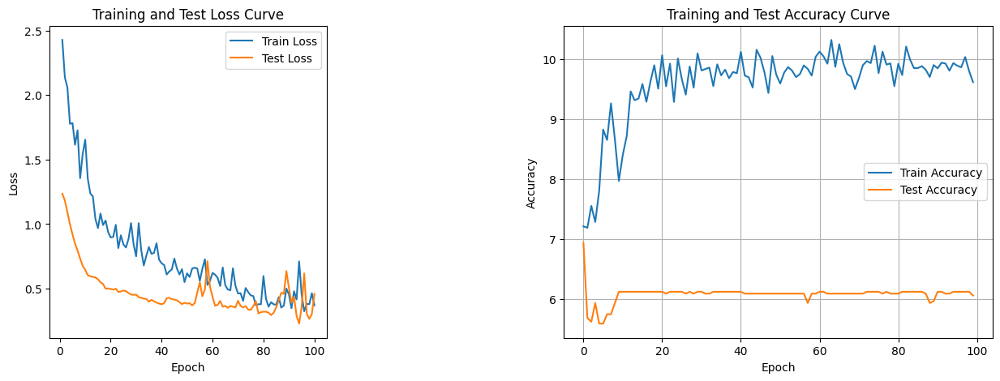

./saved_modelsmodel_9.pth
10


Training Process: 100%|██████████| 100/100 [00:03<00:00, 30.33it/s]


Total Epochs: 100
Train loss start: 2.4180166721343994, Train loss end: 0.7297350168228149
Highest Train Accuracy: 13.46875
Test loss start: 1.4006295204162598, Test loss end: 0.33630964159965515
Highest Test Accuracy: 10.9375


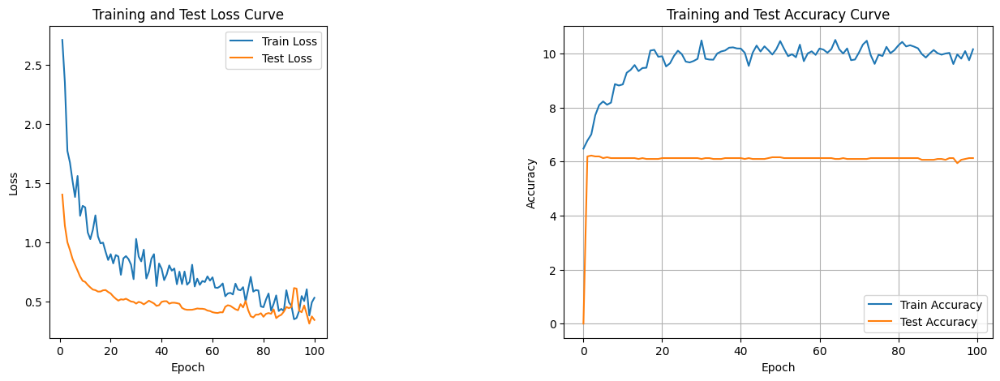

./saved_modelsmodel_10.pth
11


Training Process: 100%|██████████| 100/100 [00:03<00:00, 28.10it/s]


Total Epochs: 100
Train loss start: 3.1611015796661377, Train loss end: 0.1682327687740326
Highest Train Accuracy: 15.5
Test loss start: 1.2985107898712158, Test loss end: 0.08084985613822937
Highest Test Accuracy: 12.0


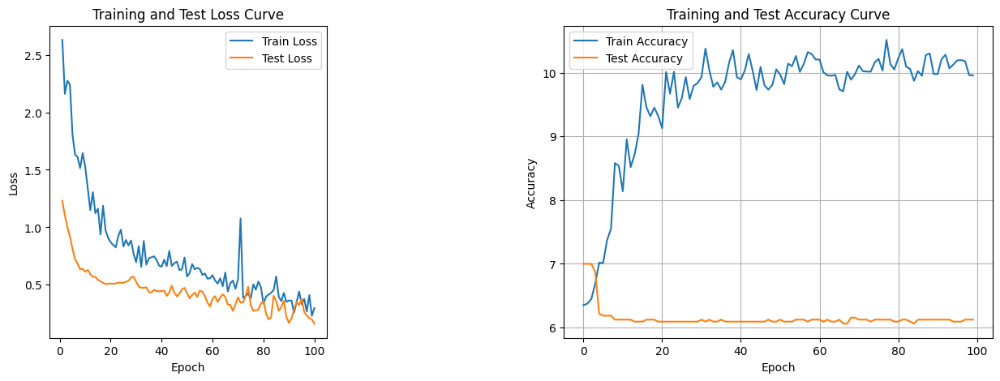

./saved_modelsmodel_11.pth
12


Training Process: 100%|██████████| 100/100 [00:03<00:00, 31.31it/s]


Total Epochs: 100
Train loss start: 2.4102864265441895, Train loss end: 0.5558363199234009
Highest Train Accuracy: 13.875
Test loss start: 1.3000266551971436, Test loss end: 0.2992183268070221
Highest Test Accuracy: 10.9375


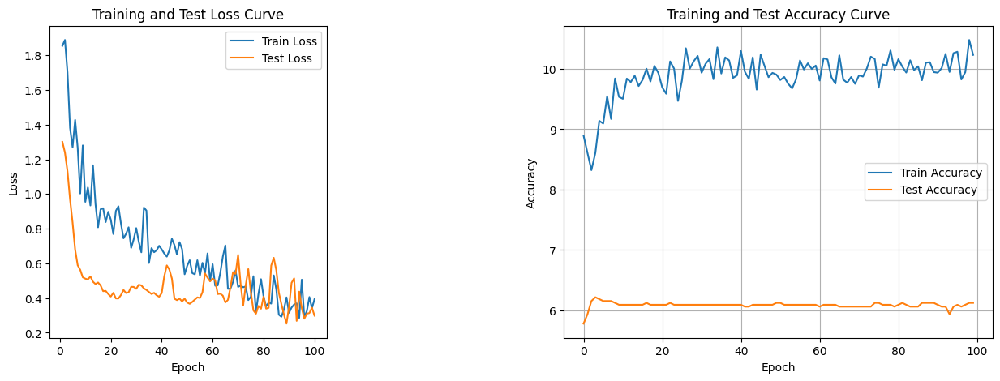

./saved_modelsmodel_12.pth
13


Training Process: 100%|██████████| 100/100 [00:03<00:00, 29.31it/s]


Total Epochs: 100
Train loss start: 2.5074312686920166, Train loss end: 0.3175322115421295
Highest Train Accuracy: 13.375
Test loss start: 1.407493233680725, Test loss end: 0.46542099118232727
Highest Test Accuracy: 10.875


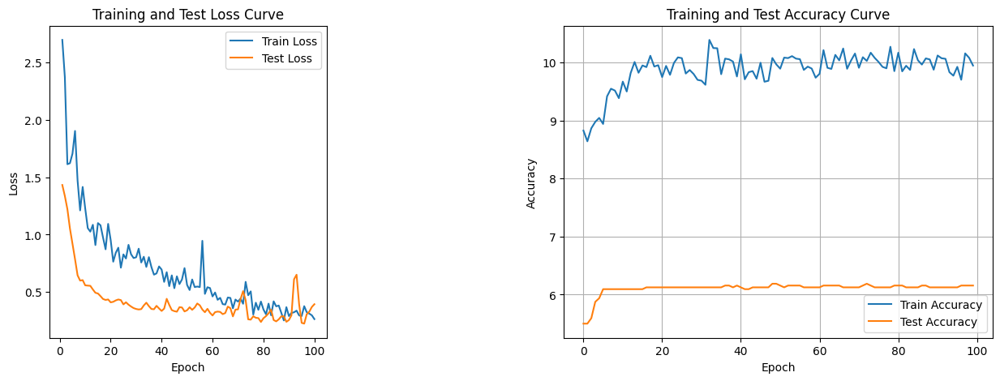

./saved_modelsmodel_13.pth
14


Training Process: 100%|██████████| 100/100 [00:03<00:00, 31.11it/s]


Total Epochs: 100
Train loss start: 2.0348777770996094, Train loss end: 0.4753139019012451
Highest Train Accuracy: 13.125
Test loss start: 1.315475344657898, Test loss end: 0.4101305902004242
Highest Test Accuracy: 11.3125


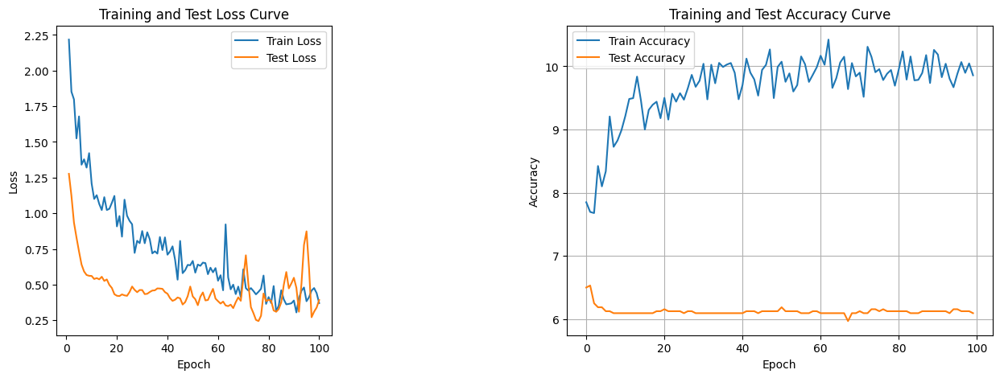

./saved_modelsmodel_14.pth
15


Training Process: 100%|██████████| 100/100 [00:03<00:00, 30.71it/s]


Total Epochs: 100
Train loss start: 3.0459632873535156, Train loss end: 0.3713929057121277
Highest Train Accuracy: 13.5
Test loss start: 1.3666776418685913, Test loss end: 0.25639864802360535
Highest Test Accuracy: 10.875


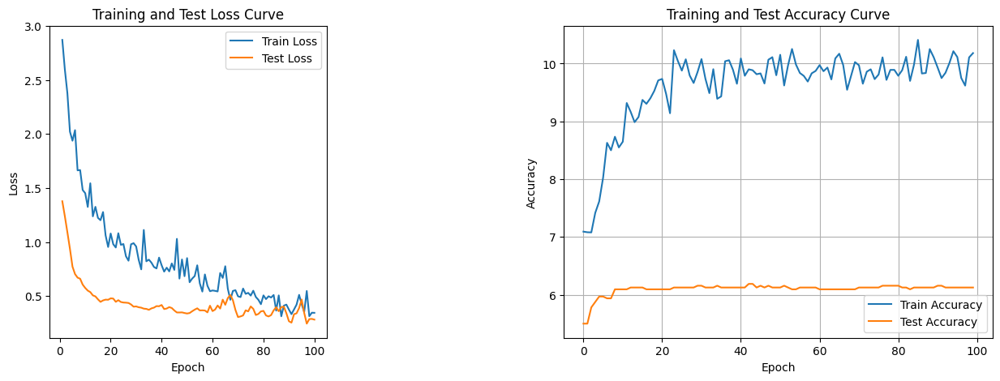

./saved_modelsmodel_15.pth
16


Training Process: 100%|██████████| 100/100 [00:03<00:00, 31.45it/s]


Total Epochs: 100
Train loss start: 3.434016466140747, Train loss end: 0.44745853543281555
Highest Train Accuracy: 15.25
Test loss start: 1.399796485900879, Test loss end: 0.5845496654510498
Highest Test Accuracy: 12.0


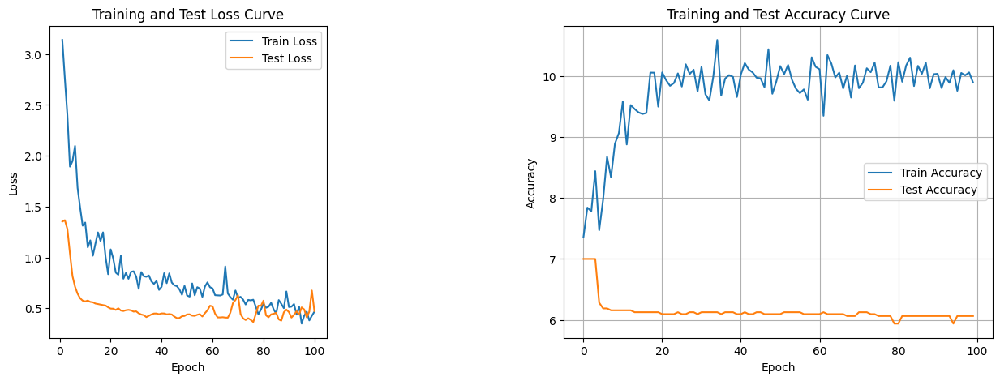

./saved_modelsmodel_16.pth
21


Training Process: 100%|██████████| 100/100 [00:03<00:00, 30.17it/s]


Total Epochs: 100
Train loss start: 0.3058583438396454, Train loss end: 0.09020229429006577
Highest Train Accuracy: 14.0
Test loss start: 0.3929523527622223, Test loss end: 0.3246404826641083
Highest Test Accuracy: 10.875


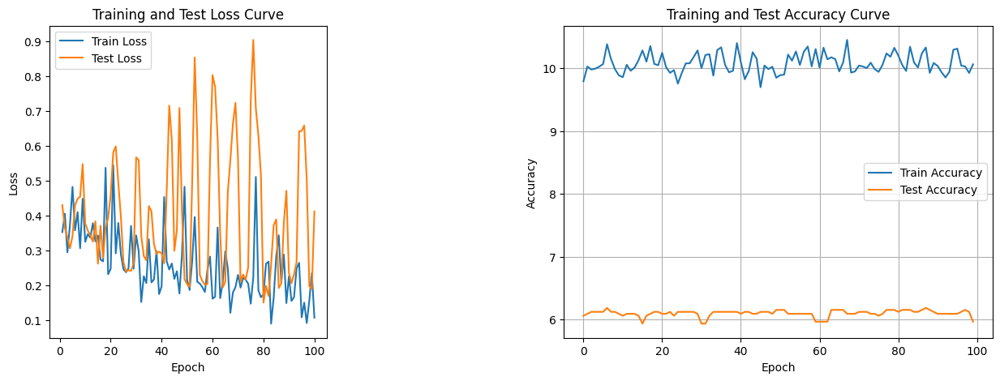

./saved_modelsmodel_21.pth
22


Training Process: 100%|██████████| 100/100 [00:03<00:00, 32.23it/s]


Total Epochs: 100
Train loss start: 0.07436691224575043, Train loss end: 0.45937299728393555
Highest Train Accuracy: 14.3125
Test loss start: 0.3420848250389099, Test loss end: 0.033387068659067154
Highest Test Accuracy: 10.8125


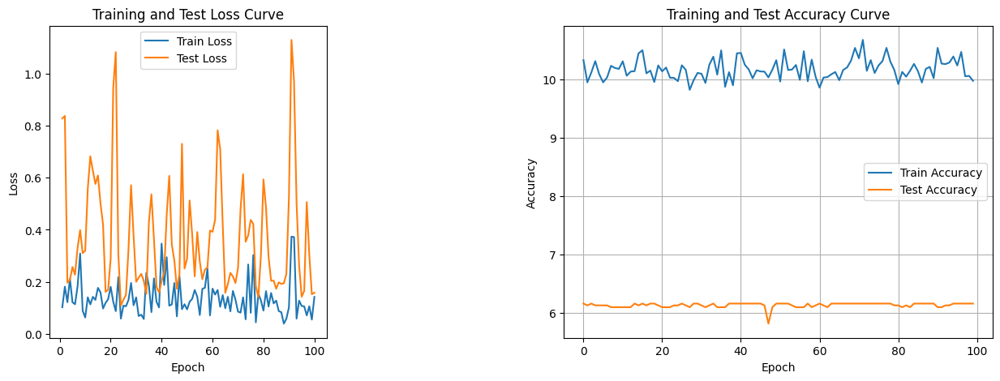

./saved_modelsmodel_22.pth
20


Training Process: 100%|██████████| 100/100 [00:03<00:00, 29.74it/s]


Total Epochs: 100
Train loss start: 0.04720896854996681, Train loss end: 0.14678244292736053
Highest Train Accuracy: 14.5
Test loss start: 0.3901102542877197, Test loss end: 0.4948485493659973
Highest Test Accuracy: 10.8125


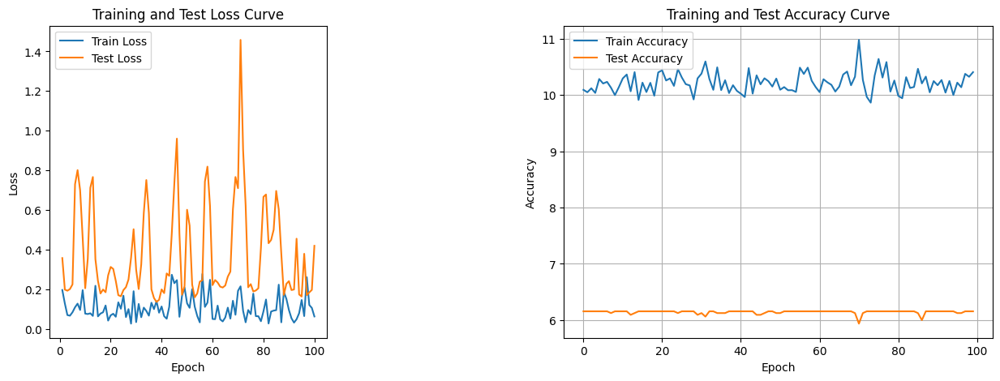

./saved_modelsmodel_20.pth
22


Training Process: 100%|██████████| 100/100 [00:02<00:00, 33.38it/s]


Total Epochs: 100
Train loss start: 0.014418383128941059, Train loss end: 0.5386837720870972
Highest Train Accuracy: 15.0
Test loss start: 0.2889331579208374, Test loss end: 1.1013261079788208
Highest Test Accuracy: 10.875


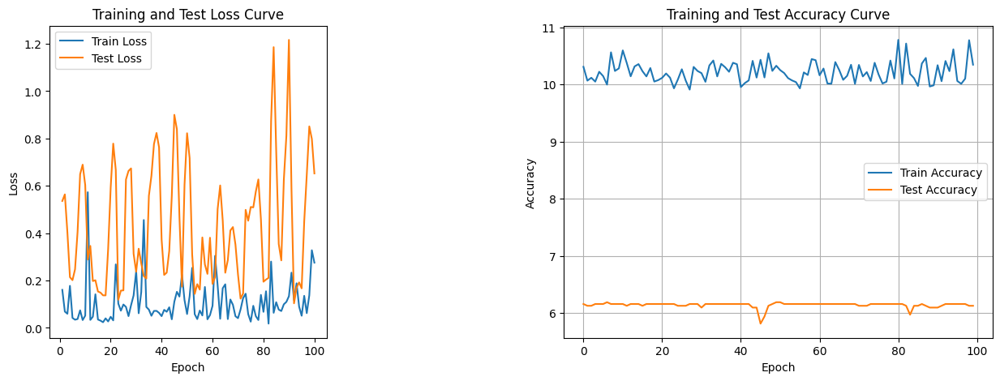

./saved_modelsmodel_22.pth
23


Training Process: 100%|██████████| 100/100 [00:03<00:00, 29.79it/s]


Total Epochs: 100
Train loss start: 0.07699056714773178, Train loss end: 0.5559180974960327
Highest Train Accuracy: 14.75
Test loss start: 0.28967276215553284, Test loss end: 2.0258405208587646
Highest Test Accuracy: 10.875


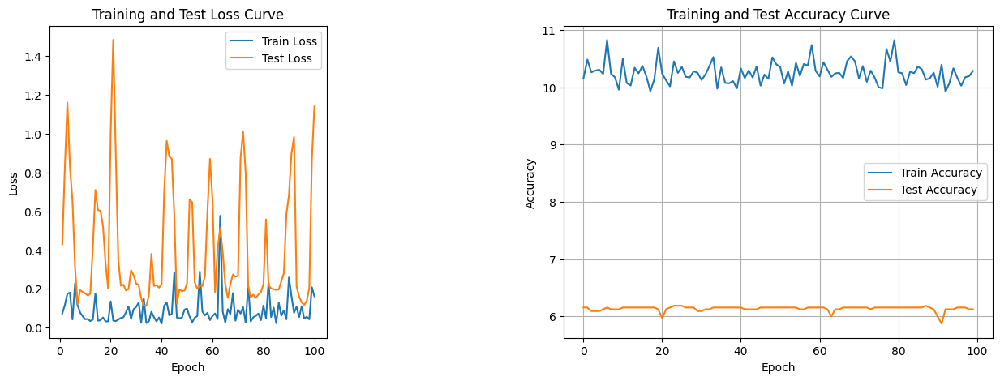

./saved_modelsmodel_23.pth
21


Training Process: 100%|██████████| 100/100 [00:03<00:00, 32.60it/s]


Total Epochs: 100
Train loss start: 0.02267901785671711, Train loss end: 0.07089614123106003
Highest Train Accuracy: 15.5
Test loss start: 0.21021394431591034, Test loss end: 0.511375904083252
Highest Test Accuracy: 10.875


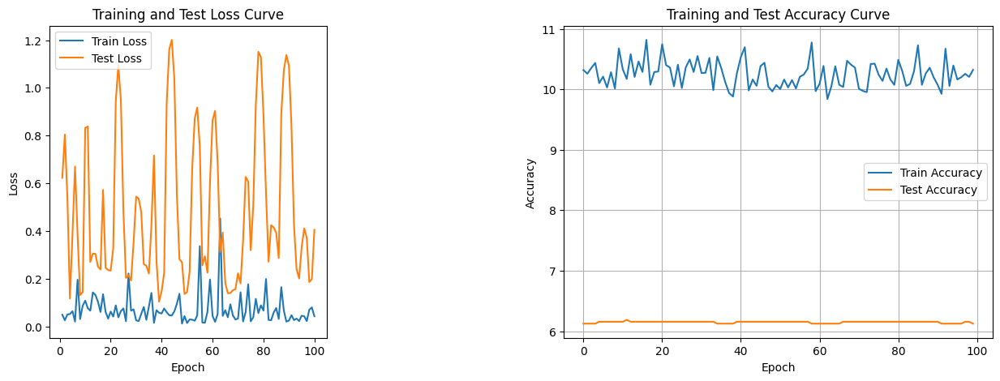

./saved_modelsmodel_21.pth
19


Training Process: 100%|██████████| 100/100 [00:03<00:00, 30.62it/s]


Total Epochs: 100
Train loss start: 0.01295848935842514, Train loss end: 0.19203634560108185
Highest Train Accuracy: 15.0
Test loss start: 0.3384445607662201, Test loss end: 1.469340443611145
Highest Test Accuracy: 10.8125


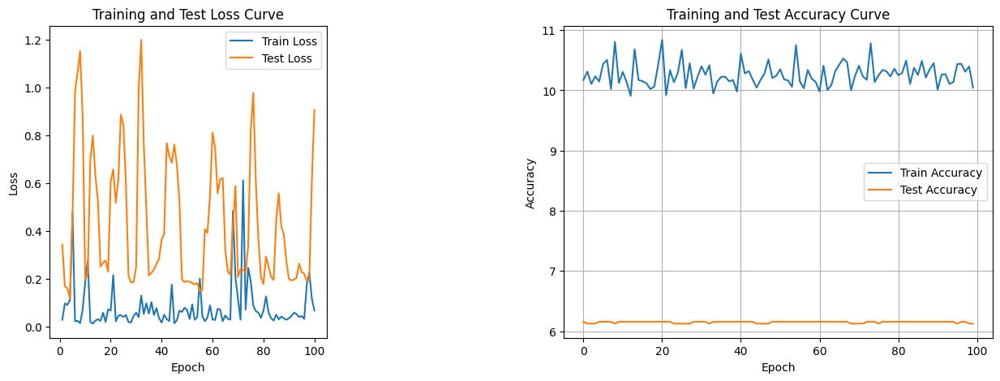

./saved_modelsmodel_19.pth
22


Training Process: 100%|██████████| 100/100 [00:03<00:00, 31.49it/s]


Total Epochs: 100
Train loss start: 0.032132528722286224, Train loss end: 0.0200504120439291
Highest Train Accuracy: 15.6875
Test loss start: 0.4392778277397156, Test loss end: 1.2321209907531738
Highest Test Accuracy: 10.8125


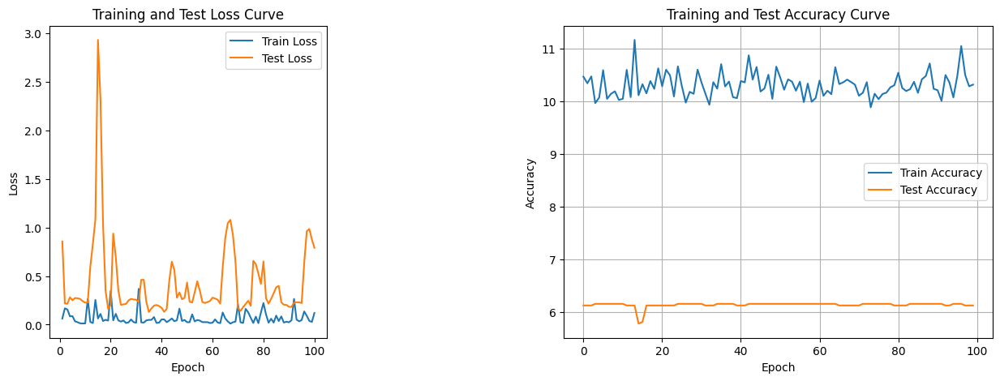

./saved_modelsmodel_22.pth
23


Training Process: 100%|██████████| 100/100 [00:03<00:00, 28.61it/s]


Total Epochs: 100
Train loss start: 0.1049058735370636, Train loss end: 0.030374759808182716
Highest Train Accuracy: 14.6875
Test loss start: 0.3067063093185425, Test loss end: 0.02473919279873371
Highest Test Accuracy: 10.8125


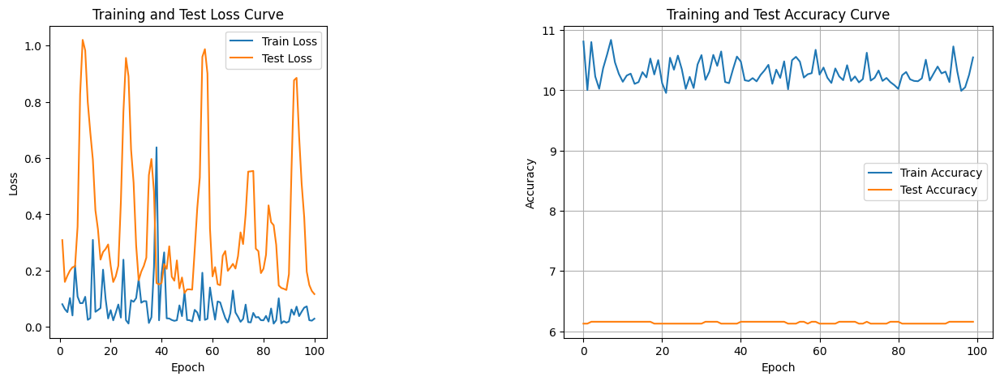

./saved_modelsmodel_23.pth
21


Training Process: 100%|██████████| 100/100 [00:02<00:00, 33.82it/s]


Total Epochs: 100
Train loss start: 0.013058952055871487, Train loss end: 0.002973647555336356
Highest Train Accuracy: 15.625
Test loss start: 0.13772407174110413, Test loss end: 0.038832880556583405
Highest Test Accuracy: 10.875


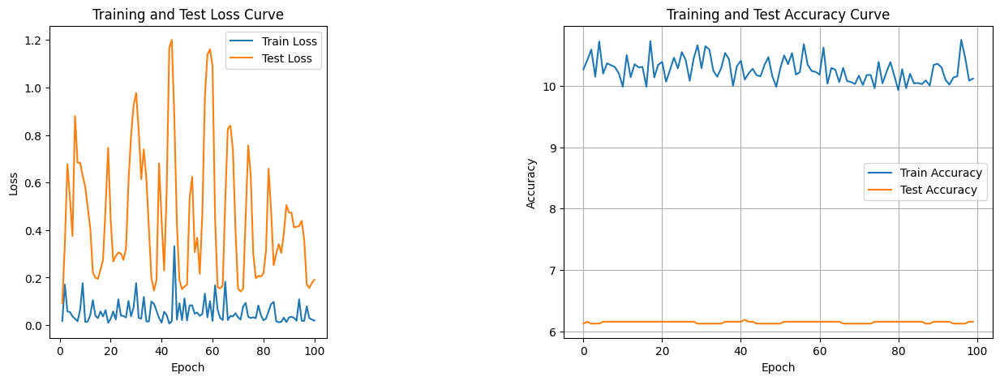

./saved_modelsmodel_21.pth
23


Training Process: 100%|██████████| 100/100 [00:03<00:00, 30.99it/s]


Total Epochs: 100
Train loss start: 0.001918685156852007, Train loss end: 0.9331737160682678
Highest Train Accuracy: 15.6875
Test loss start: 0.24263091385364532, Test loss end: 0.17004425823688507
Highest Test Accuracy: 10.8125


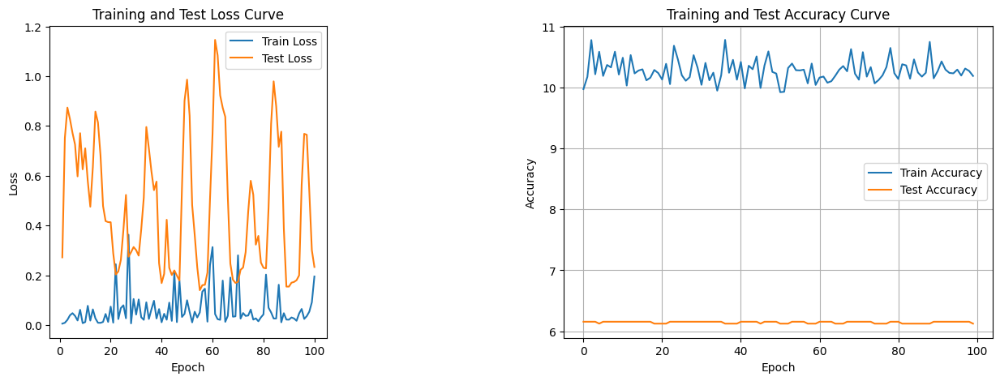

./saved_modelsmodel_23.pth
24


Training Process: 100%|██████████| 100/100 [00:04<00:00, 24.62it/s]


Total Epochs: 100
Train loss start: 0.004166983533650637, Train loss end: 0.029303094372153282
Highest Train Accuracy: 14.75
Test loss start: 0.26136258244514465, Test loss end: 0.39912551641464233
Highest Test Accuracy: 10.875


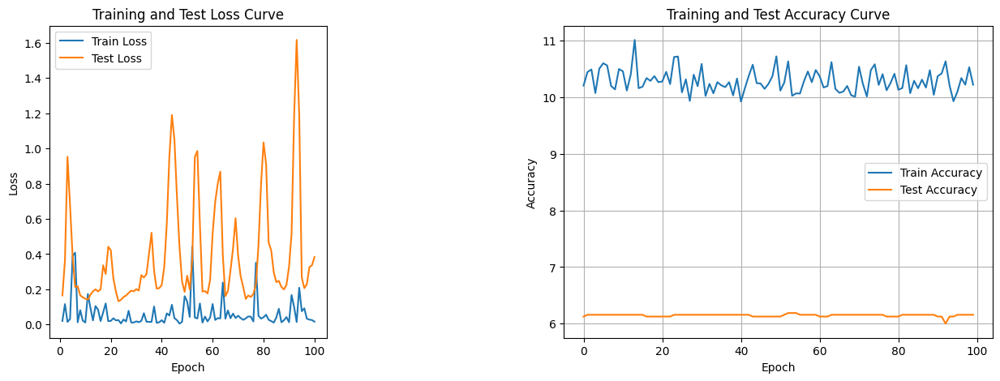

./saved_modelsmodel_24.pth
22


Training Process: 100%|██████████| 100/100 [00:03<00:00, 25.67it/s]


Total Epochs: 100
Train loss start: 0.006315093487501144, Train loss end: 0.014446371234953403
Highest Train Accuracy: 15.3125
Test loss start: 0.32184329628944397, Test loss end: 1.750346064567566
Highest Test Accuracy: 10.875


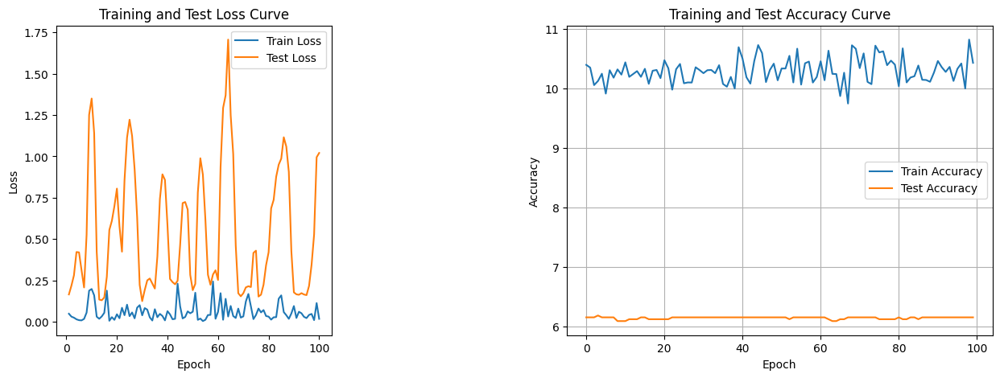

./saved_modelsmodel_22.pth
20


Training Process: 100%|██████████| 100/100 [00:03<00:00, 28.26it/s]


Total Epochs: 100
Train loss start: 0.019206123426556587, Train loss end: 0.003061945317313075
Highest Train Accuracy: 15.0
Test loss start: 0.22321021556854248, Test loss end: 0.888638973236084
Highest Test Accuracy: 10.8125


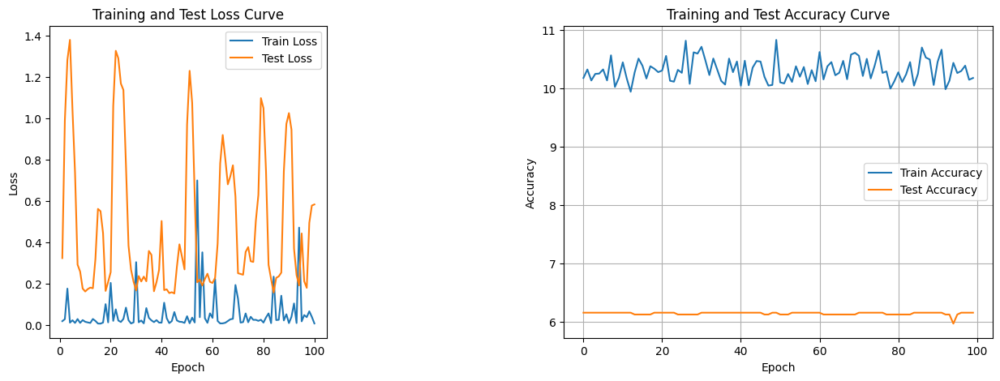

./saved_modelsmodel_20.pth
18


Training Process: 100%|██████████| 100/100 [00:03<00:00, 30.35it/s]


Total Epochs: 100
Train loss start: 0.024154912680387497, Train loss end: 0.006996115203946829
Highest Train Accuracy: 15.0
Test loss start: 0.27708399295806885, Test loss end: 0.02474273182451725
Highest Test Accuracy: 10.875


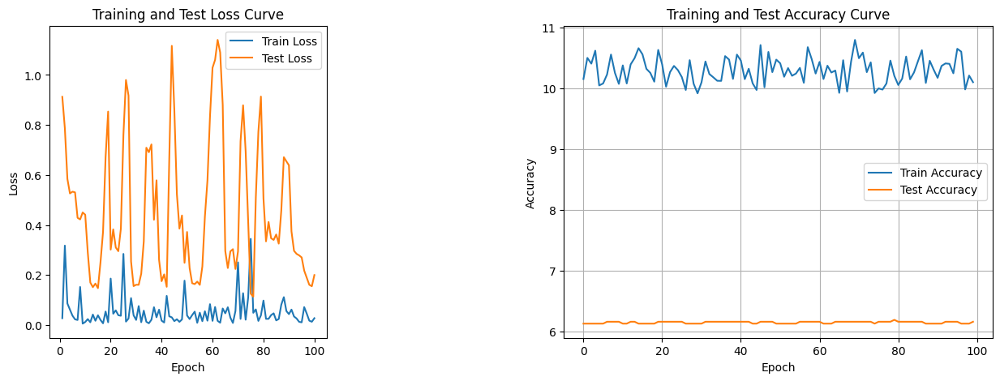

./saved_modelsmodel_18.pth


MLP(
  (layers): ModuleList(
    (0): Linear(in_features=13, out_features=256, bias=True)
    (1): Linear(in_features=256, out_features=128, bias=True)
    (2): Linear(in_features=128, out_features=64, bias=True)
    (3): Linear(in_features=64, out_features=32, bias=True)
  )
  (batch_norms): ModuleList(
    (0): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (output): Linear(in_features=32, out_features=4, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
)

In [ ]:
coverDTEmlp16b.train_DTE()

# Base: 32

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
model1 and model2 are different.
1


Training Process: 100%|██████████| 100/100 [00:03<00:00, 31.92it/s]


Total Epochs: 100
Train loss start: 2.6761631965637207, Train loss end: 0.6339632272720337
Highest Train Accuracy: 14.65625
Test loss start: 1.405447006225586, Test loss end: 0.2979731559753418
Highest Test Accuracy: 12.0


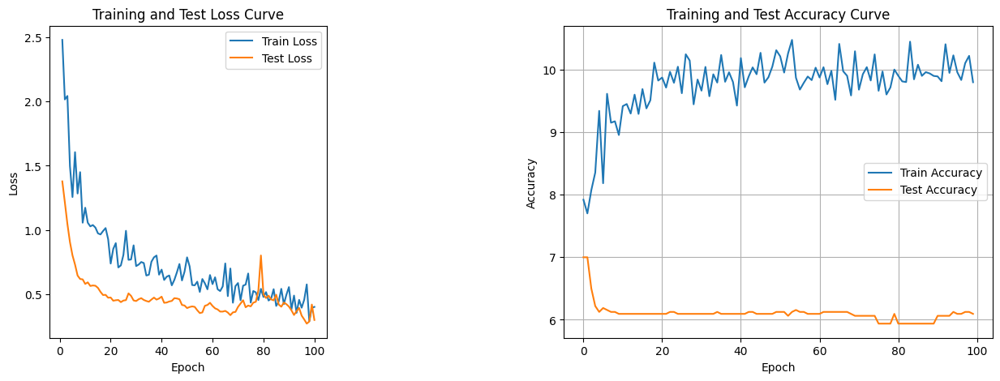

./saved_modelsmodel_1.pth
2


Training Process: 100%|██████████| 100/100 [00:03<00:00, 31.25it/s]


Total Epochs: 100
Train loss start: 2.531540870666504, Train loss end: 0.6986965537071228
Highest Train Accuracy: 13.5
Test loss start: 1.4093060493469238, Test loss end: 0.38735905289649963
Highest Test Accuracy: 12.0


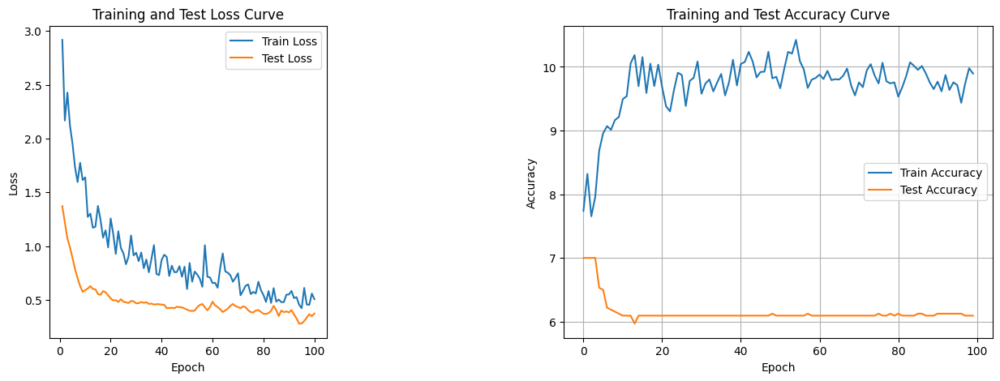

./saved_modelsmodel_2.pth
3


Training Process: 100%|██████████| 100/100 [00:02<00:00, 34.10it/s]


Total Epochs: 100
Train loss start: 2.557828664779663, Train loss end: 0.23395363986492157
Highest Train Accuracy: 14.3125
Test loss start: 1.3255860805511475, Test loss end: 0.2916207015514374
Highest Test Accuracy: 12.0


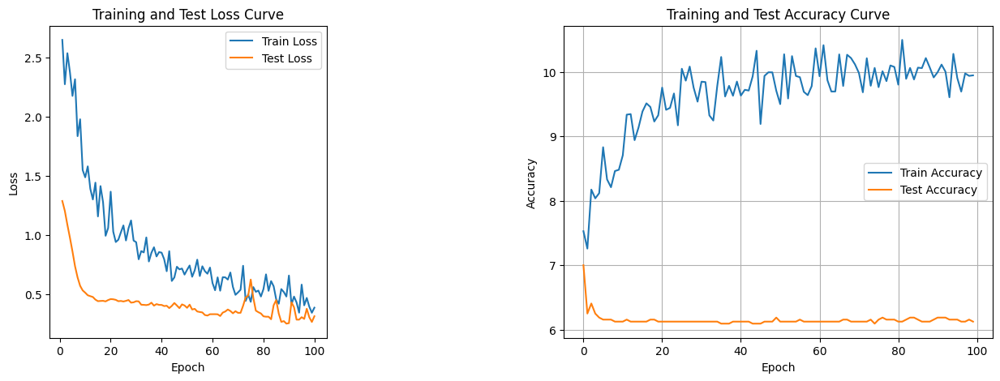

./saved_modelsmodel_3.pth
4


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.81it/s]


Total Epochs: 100
Train loss start: 2.75372576713562, Train loss end: 0.1890668123960495
Highest Train Accuracy: 14.0
Test loss start: 1.6941579580307007, Test loss end: 0.4078899323940277
Highest Test Accuracy: 10.875


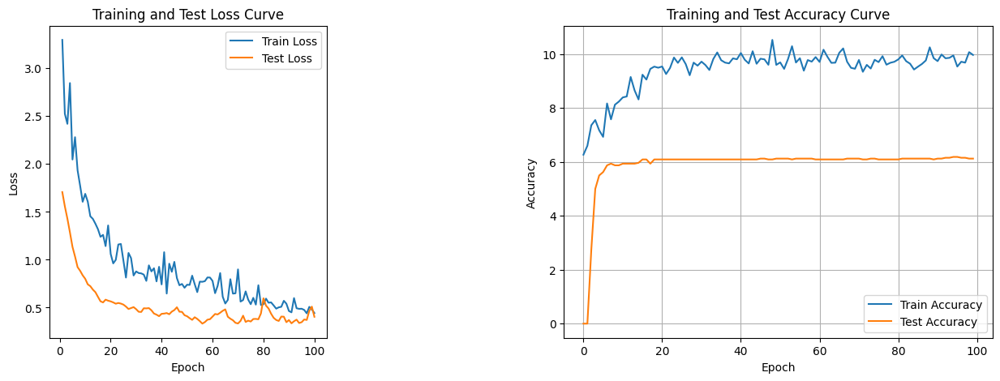

./saved_modelsmodel_4.pth
5


Training Process: 100%|██████████| 100/100 [00:02<00:00, 37.27it/s]


Total Epochs: 100
Train loss start: 3.202024221420288, Train loss end: 0.9707531332969666
Highest Train Accuracy: 13.96875
Test loss start: 1.403734564781189, Test loss end: 0.4638708531856537
Highest Test Accuracy: 12.0


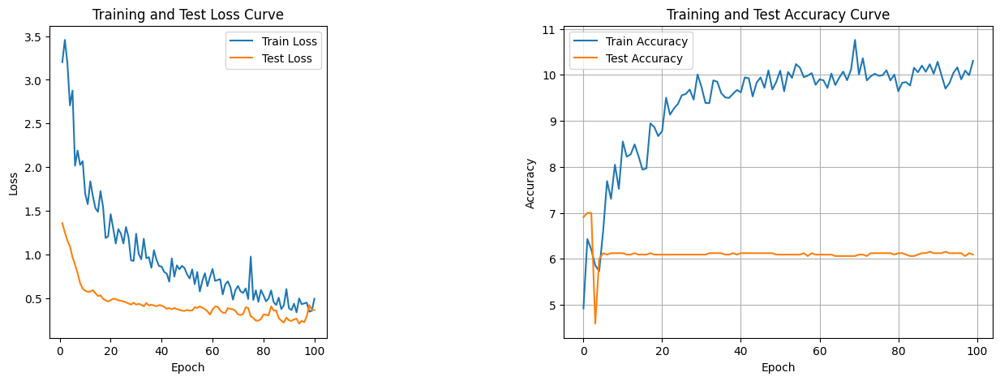

./saved_modelsmodel_5.pth
6


Training Process: 100%|██████████| 100/100 [00:02<00:00, 37.05it/s]


Total Epochs: 100
Train loss start: 2.5305304527282715, Train loss end: 0.33905819058418274
Highest Train Accuracy: 13.28125
Test loss start: 1.356953740119934, Test loss end: 1.1425933837890625
Highest Test Accuracy: 11.6875


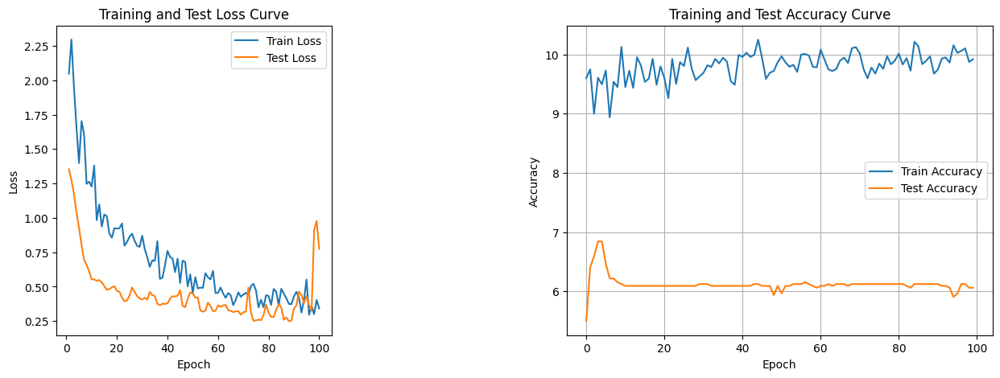

./saved_modelsmodel_6.pth
7


Training Process: 100%|██████████| 100/100 [00:02<00:00, 34.68it/s]


Total Epochs: 100
Train loss start: 2.253305196762085, Train loss end: 0.5581408143043518
Highest Train Accuracy: 13.84375
Test loss start: 1.3034982681274414, Test loss end: 0.3559766113758087
Highest Test Accuracy: 11.6875


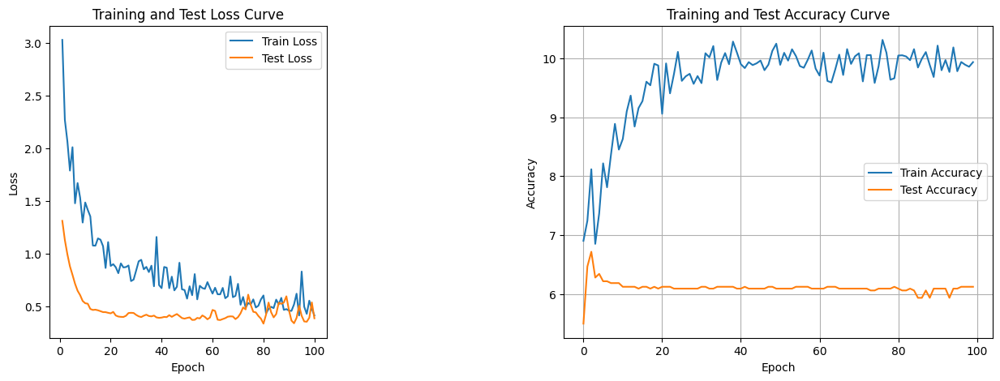

./saved_modelsmodel_7.pth
8


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.81it/s]


Total Epochs: 100
Train loss start: 2.511550188064575, Train loss end: 1.0944007635116577
Highest Train Accuracy: 13.375
Test loss start: 1.3610725402832031, Test loss end: 0.41165679693222046
Highest Test Accuracy: 11.25


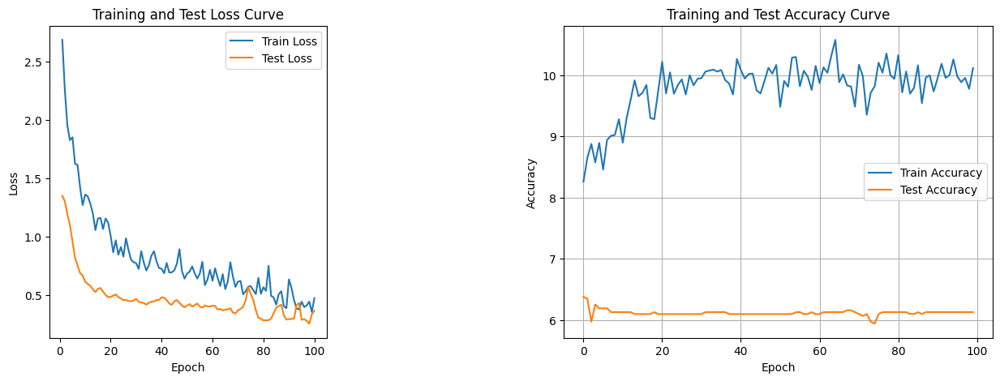

./saved_modelsmodel_8.pth
9


Training Process: 100%|██████████| 100/100 [00:02<00:00, 37.27it/s]


Total Epochs: 100
Train loss start: 2.886794090270996, Train loss end: 0.5872769951820374
Highest Train Accuracy: 13.34375
Test loss start: 1.1599527597427368, Test loss end: 0.5825759768486023
Highest Test Accuracy: 12.0


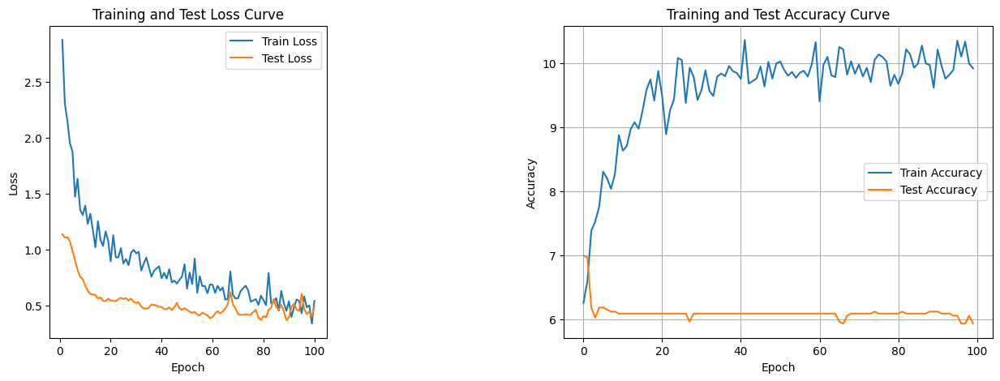

./saved_modelsmodel_9.pth
10


Training Process: 100%|██████████| 100/100 [00:02<00:00, 38.00it/s]


Total Epochs: 100
Train loss start: 2.384814977645874, Train loss end: 0.17481721937656403
Highest Train Accuracy: 14.0
Test loss start: 1.3424361944198608, Test loss end: 1.3275188207626343
Highest Test Accuracy: 10.875


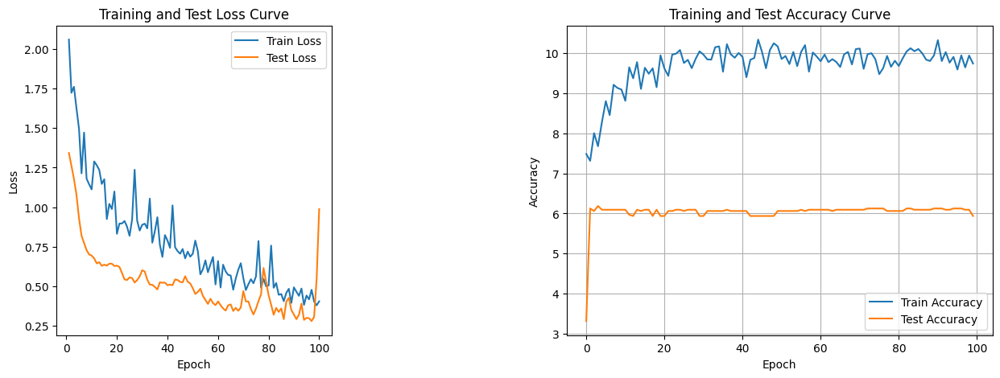

./saved_modelsmodel_10.pth
11


Training Process: 100%|██████████| 100/100 [00:02<00:00, 37.80it/s]


Total Epochs: 100
Train loss start: 1.843480110168457, Train loss end: 0.4650581479072571
Highest Train Accuracy: 13.71875
Test loss start: 1.3075345754623413, Test loss end: 0.24539519846439362
Highest Test Accuracy: 10.9375


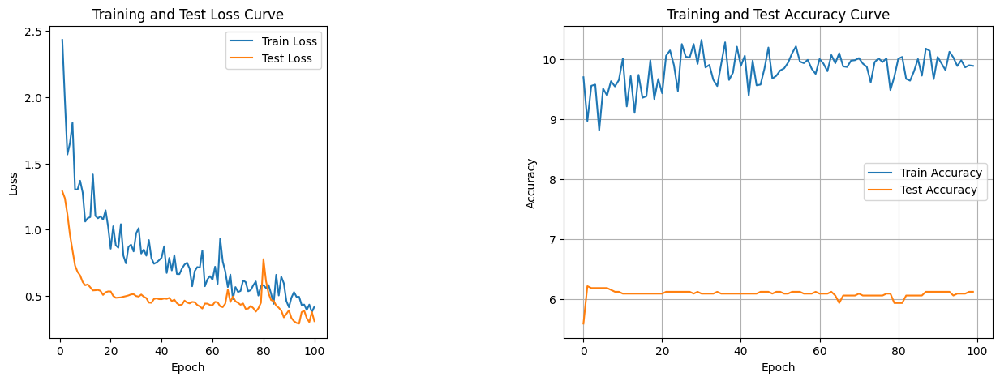

./saved_modelsmodel_11.pth
12


Training Process: 100%|██████████| 100/100 [00:02<00:00, 34.21it/s]


Total Epochs: 100
Train loss start: 3.7626922130584717, Train loss end: 0.45408037304878235
Highest Train Accuracy: 14.1875
Test loss start: 1.4571113586425781, Test loss end: 0.1467805951833725
Highest Test Accuracy: 10.8125


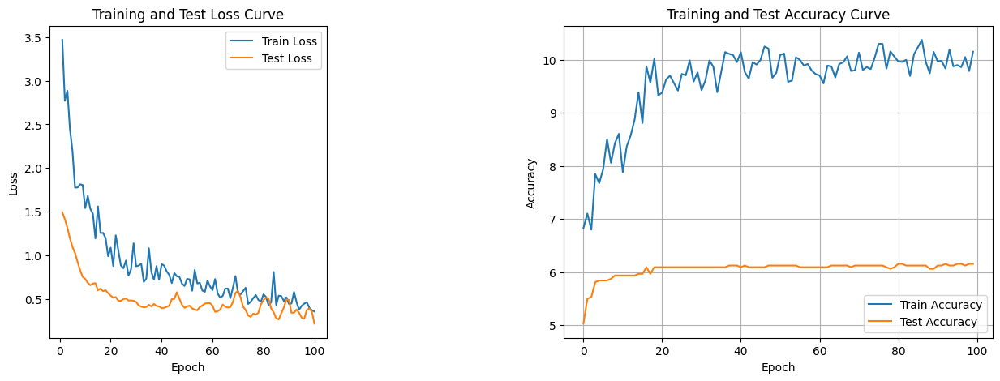

./saved_modelsmodel_12.pth
13


Training Process: 100%|██████████| 100/100 [00:03<00:00, 25.43it/s]


Total Epochs: 100
Train loss start: 2.3211350440979004, Train loss end: 0.3694998621940613
Highest Train Accuracy: 14.40625
Test loss start: 1.3156368732452393, Test loss end: 0.35852304100990295
Highest Test Accuracy: 10.75


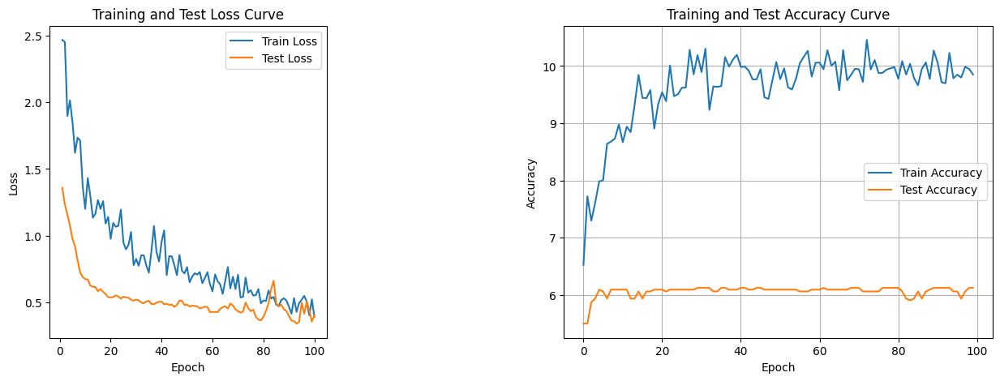

./saved_modelsmodel_13.pth
14


Training Process: 100%|██████████| 100/100 [00:03<00:00, 28.25it/s]


Total Epochs: 100
Train loss start: 2.0308260917663574, Train loss end: 0.5771926641464233
Highest Train Accuracy: 14.34375
Test loss start: 1.294655442237854, Test loss end: 0.2668425738811493
Highest Test Accuracy: 12.0


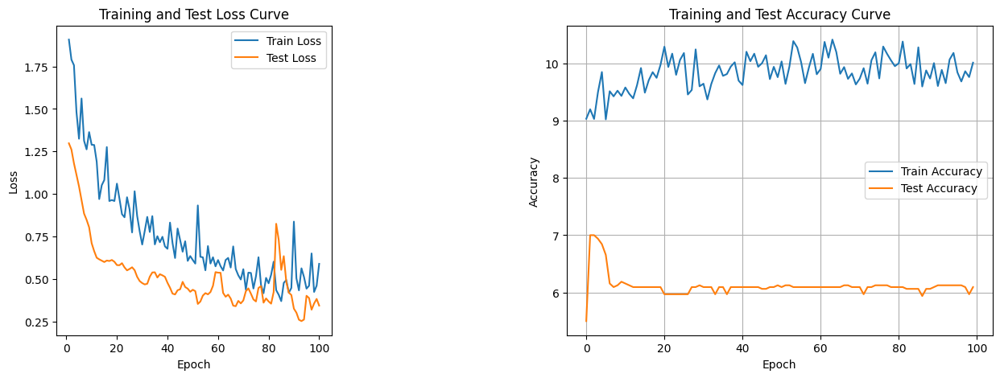

./saved_modelsmodel_14.pth
15


Training Process: 100%|██████████| 100/100 [00:04<00:00, 24.70it/s]


Total Epochs: 100
Train loss start: 3.5470359325408936, Train loss end: 0.31075286865234375
Highest Train Accuracy: 13.375
Test loss start: 1.3618593215942383, Test loss end: 0.3902010917663574
Highest Test Accuracy: 12.0


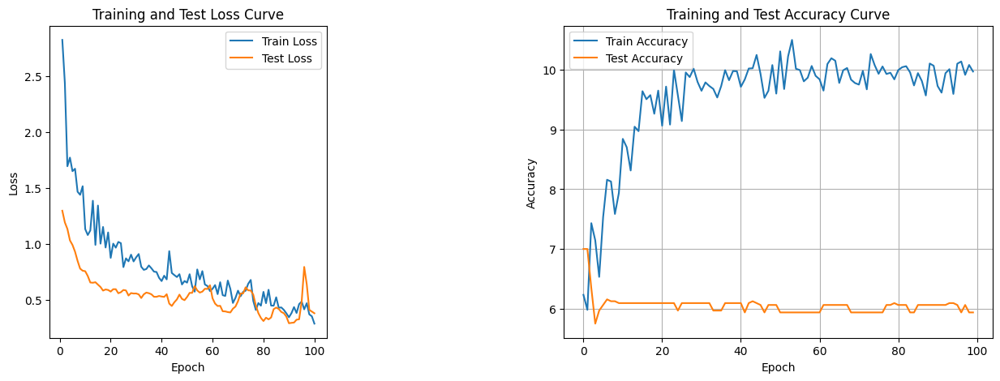

./saved_modelsmodel_15.pth
16


Training Process: 100%|██████████| 100/100 [00:03<00:00, 25.83it/s]


Total Epochs: 100
Train loss start: 3.143265724182129, Train loss end: 0.2559187114238739
Highest Train Accuracy: 13.1875
Test loss start: 1.5683727264404297, Test loss end: 0.9188433289527893
Highest Test Accuracy: 10.875


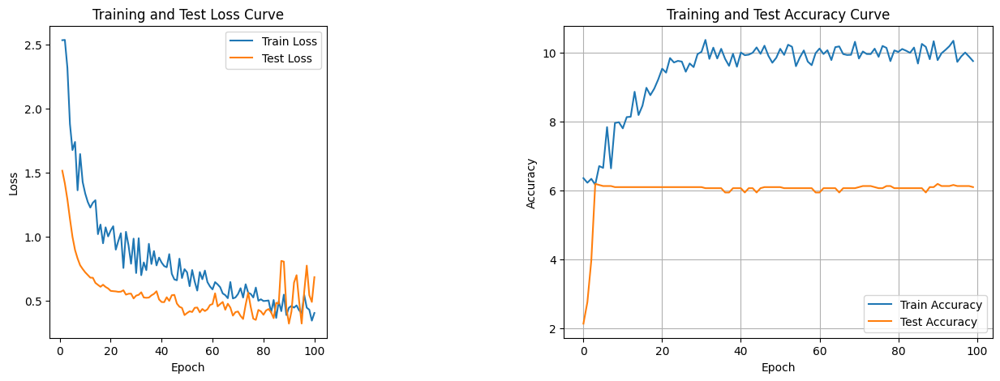

./saved_modelsmodel_16.pth
17


Training Process: 100%|██████████| 100/100 [00:03<00:00, 26.67it/s]


Total Epochs: 100
Train loss start: 2.3191916942596436, Train loss end: 0.7562863230705261
Highest Train Accuracy: 13.71875
Test loss start: 1.2727500200271606, Test loss end: 0.15916872024536133
Highest Test Accuracy: 10.8125


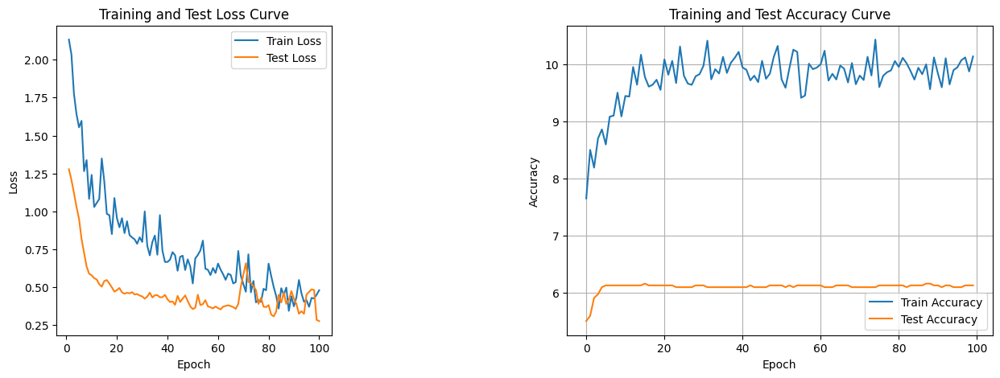

./saved_modelsmodel_17.pth
18


Training Process: 100%|██████████| 100/100 [00:03<00:00, 27.58it/s]


Total Epochs: 100
Train loss start: 2.9844930171966553, Train loss end: 0.14559884369373322
Highest Train Accuracy: 13.5625
Test loss start: 1.3604556322097778, Test loss end: 0.4299619793891907
Highest Test Accuracy: 10.8125


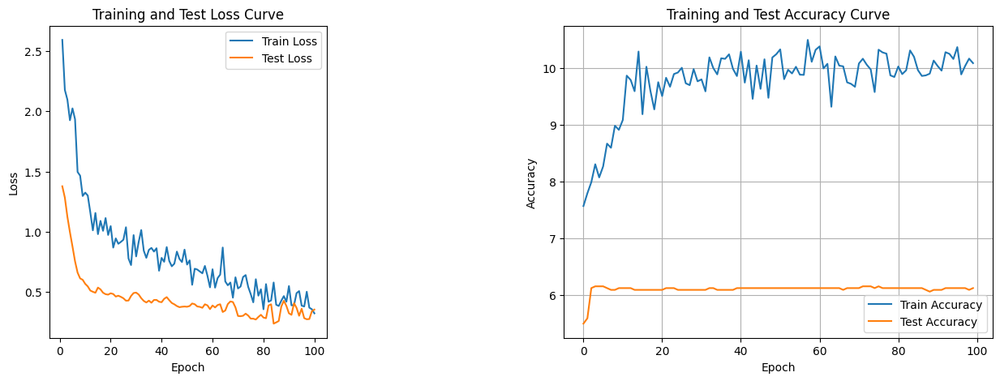

./saved_modelsmodel_18.pth
19


Training Process: 100%|██████████| 100/100 [00:03<00:00, 28.84it/s]


Total Epochs: 100
Train loss start: 2.991783857345581, Train loss end: 0.4528951346874237
Highest Train Accuracy: 13.1875
Test loss start: 1.509047031402588, Test loss end: 0.3373875319957733
Highest Test Accuracy: 10.875


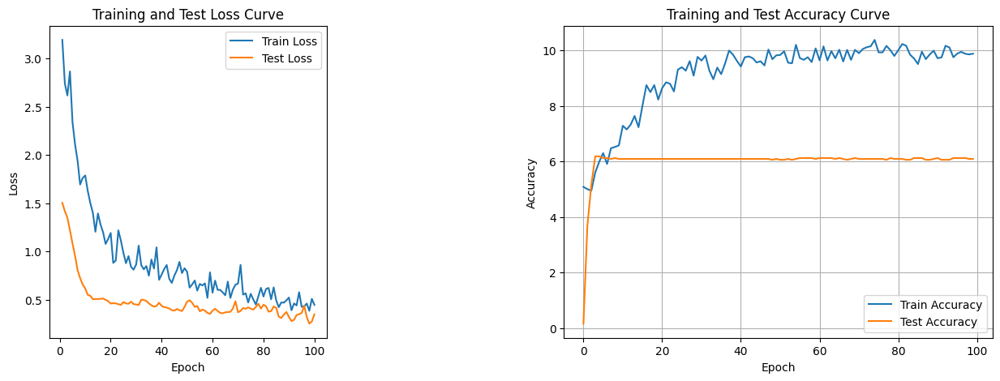

./saved_modelsmodel_19.pth
20


Training Process: 100%|██████████| 100/100 [00:03<00:00, 29.06it/s]


Total Epochs: 100
Train loss start: 2.1188745498657227, Train loss end: 0.521909773349762
Highest Train Accuracy: 15.46875
Test loss start: 1.2608691453933716, Test loss end: 0.3091902434825897
Highest Test Accuracy: 11.8125


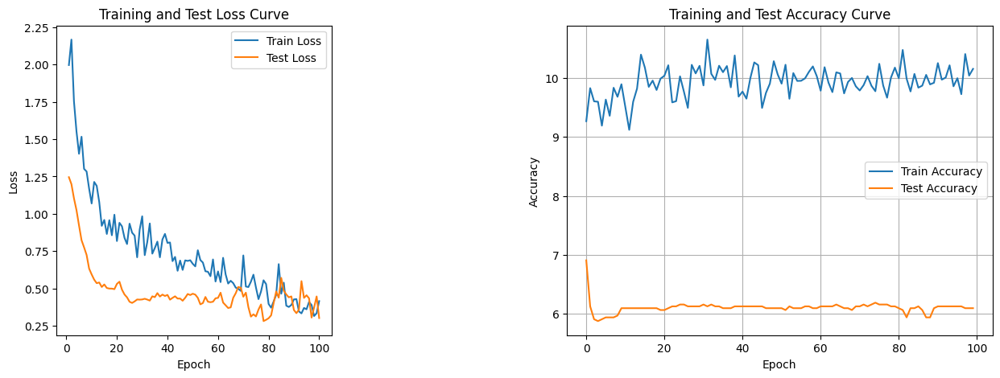

./saved_modelsmodel_20.pth
21


Training Process: 100%|██████████| 100/100 [00:03<00:00, 26.84it/s]


Total Epochs: 100
Train loss start: 2.5312395095825195, Train loss end: 0.8013224601745605
Highest Train Accuracy: 12.9375
Test loss start: 1.3446625471115112, Test loss end: 0.3748020529747009
Highest Test Accuracy: 12.0


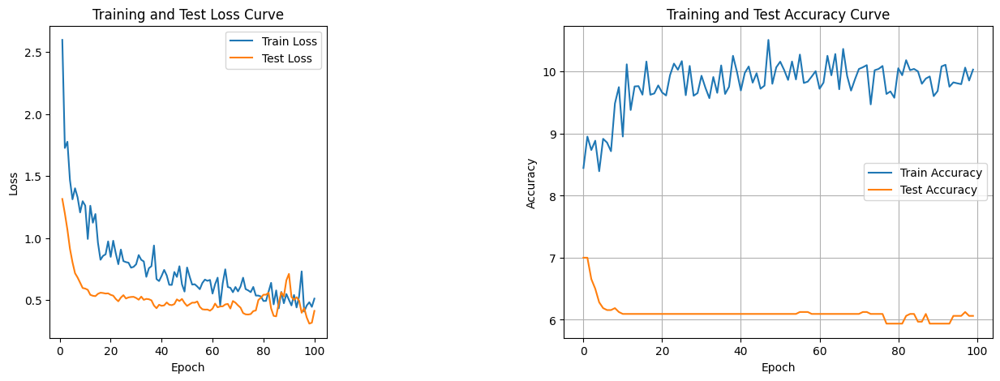

./saved_modelsmodel_21.pth
22


Training Process: 100%|██████████| 100/100 [00:03<00:00, 32.90it/s]


Total Epochs: 100
Train loss start: 3.0535776615142822, Train loss end: 0.658919632434845
Highest Train Accuracy: 12.78125
Test loss start: 1.3115730285644531, Test loss end: 0.17615079879760742
Highest Test Accuracy: 12.0


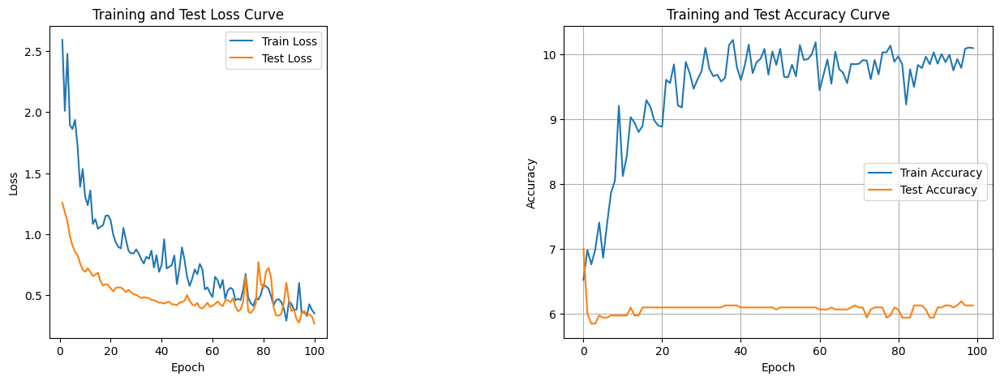

./saved_modelsmodel_22.pth
23


Training Process: 100%|██████████| 100/100 [00:03<00:00, 32.95it/s]


Total Epochs: 100
Train loss start: 3.8031258583068848, Train loss end: 0.5195040106773376
Highest Train Accuracy: 14.0
Test loss start: 1.4719033241271973, Test loss end: 0.27249717712402344
Highest Test Accuracy: 10.8125


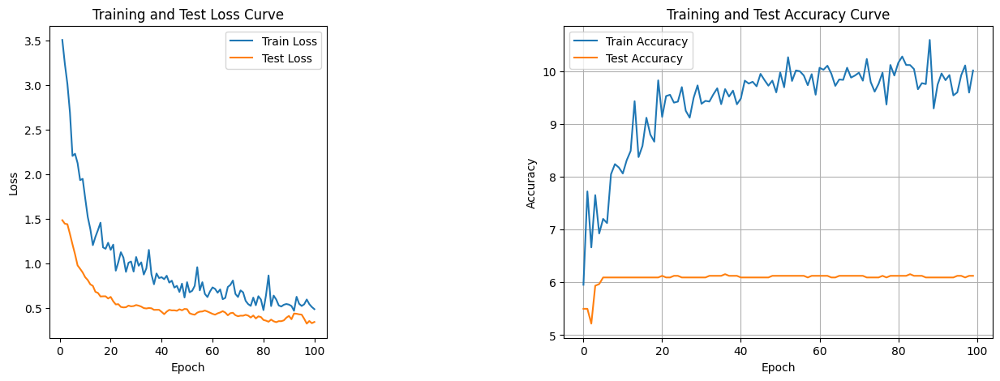

./saved_modelsmodel_23.pth
24


Training Process: 100%|██████████| 100/100 [00:03<00:00, 25.96it/s]


Total Epochs: 100
Train loss start: 3.1585495471954346, Train loss end: 0.3794194161891937
Highest Train Accuracy: 13.90625
Test loss start: 1.3382723331451416, Test loss end: 0.21177856624126434
Highest Test Accuracy: 12.0


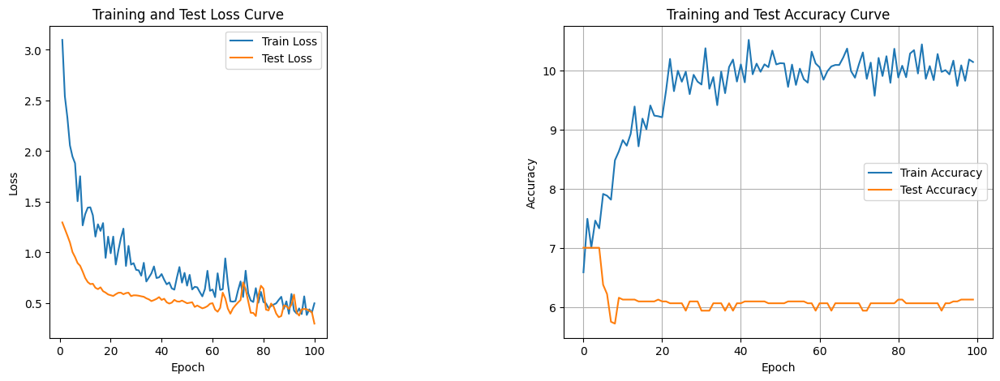

./saved_modelsmodel_24.pth
25


Training Process: 100%|██████████| 100/100 [00:03<00:00, 28.37it/s]


Total Epochs: 100
Train loss start: 3.008419990539551, Train loss end: 0.2908402383327484
Highest Train Accuracy: 13.625
Test loss start: 1.3516196012496948, Test loss end: 0.40311577916145325
Highest Test Accuracy: 10.875


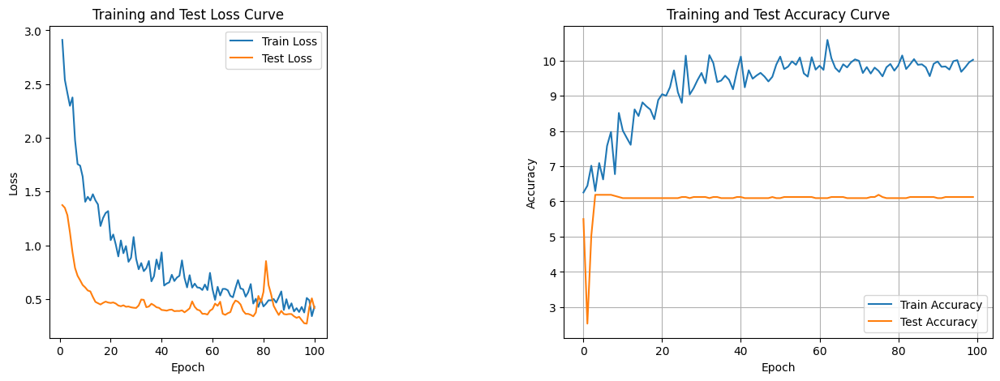

./saved_modelsmodel_25.pth
26


Training Process: 100%|██████████| 100/100 [00:03<00:00, 28.40it/s]


Total Epochs: 100
Train loss start: 2.885953187942505, Train loss end: 0.23549190163612366
Highest Train Accuracy: 14.21875
Test loss start: 1.354676604270935, Test loss end: 0.13418832421302795
Highest Test Accuracy: 12.0


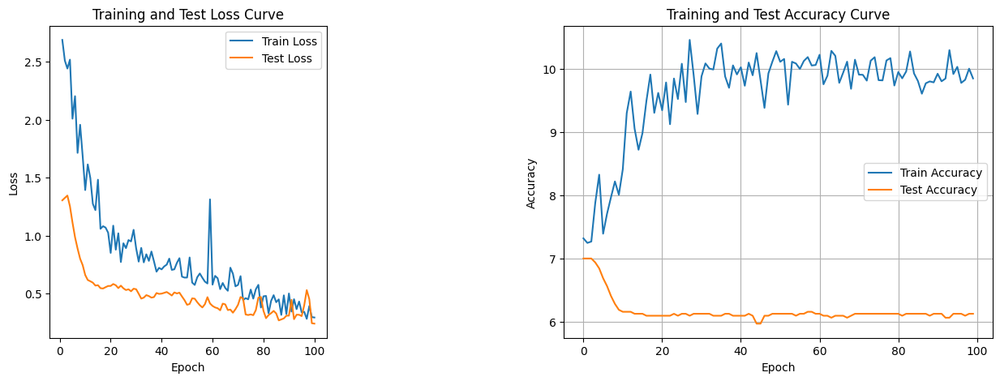

./saved_modelsmodel_26.pth
27


Training Process: 100%|██████████| 100/100 [00:03<00:00, 30.52it/s]


Total Epochs: 100
Train loss start: 2.249805212020874, Train loss end: 0.4517565369606018
Highest Train Accuracy: 14.25
Test loss start: 1.2743083238601685, Test loss end: 0.3724544942378998
Highest Test Accuracy: 12.0


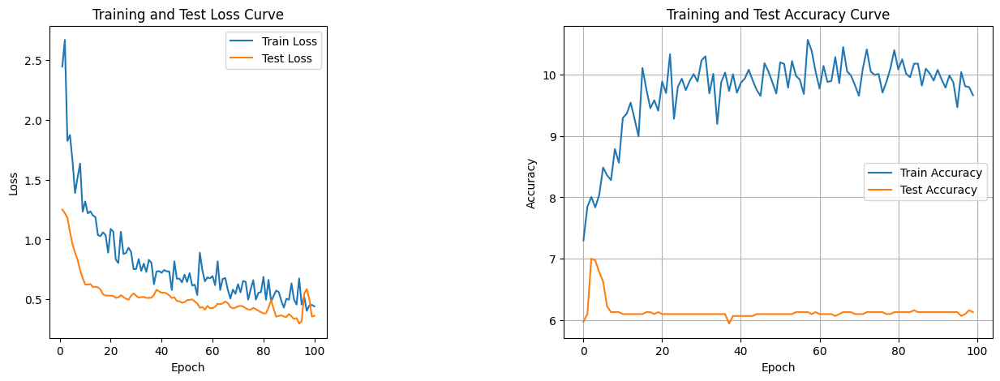

./saved_modelsmodel_27.pth
28


Training Process: 100%|██████████| 100/100 [00:03<00:00, 31.35it/s]


Total Epochs: 100
Train loss start: 3.087294816970825, Train loss end: 0.4317750632762909
Highest Train Accuracy: 14.25
Test loss start: 1.353325605392456, Test loss end: 0.11239437013864517
Highest Test Accuracy: 11.875


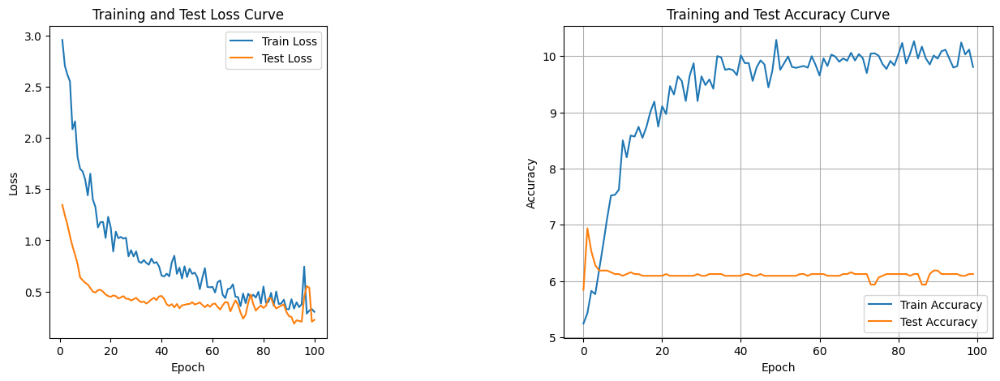

./saved_modelsmodel_28.pth
29


Training Process: 100%|██████████| 100/100 [00:02<00:00, 35.20it/s]


Total Epochs: 100
Train loss start: 1.9415613412857056, Train loss end: 0.19964779913425446
Highest Train Accuracy: 13.6875
Test loss start: 1.2944687604904175, Test loss end: 0.2344810962677002
Highest Test Accuracy: 10.875


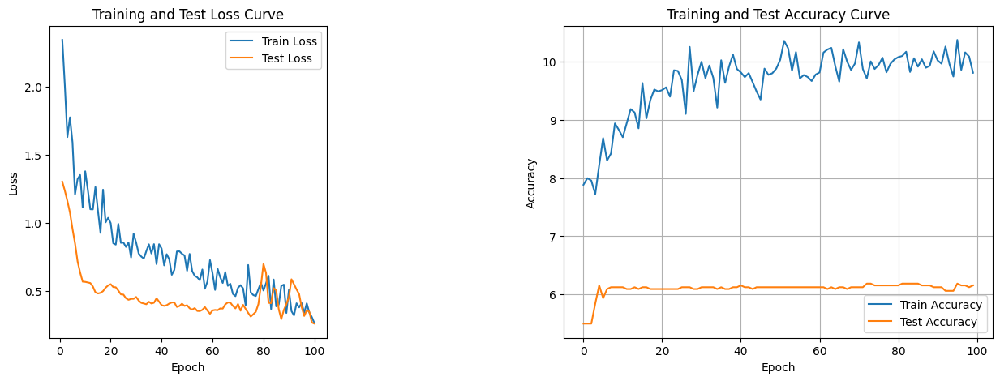

./saved_modelsmodel_29.pth
30


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.82it/s]


Total Epochs: 100
Train loss start: 2.7362899780273438, Train loss end: 0.4667396545410156
Highest Train Accuracy: 14.0
Test loss start: 1.2715256214141846, Test loss end: 0.2735608220100403
Highest Test Accuracy: 11.3125


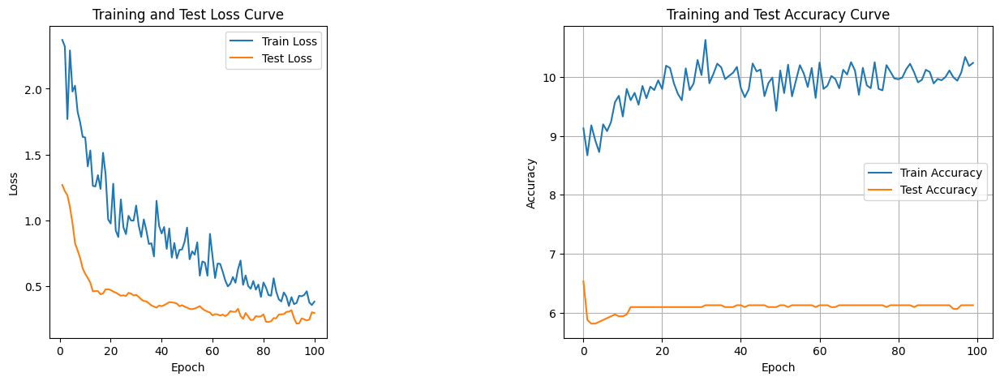

./saved_modelsmodel_30.pth
31


Training Process: 100%|██████████| 100/100 [00:02<00:00, 34.32it/s]


Total Epochs: 100
Train loss start: 2.935633420944214, Train loss end: 0.8484853506088257
Highest Train Accuracy: 13.84375
Test loss start: 1.634689450263977, Test loss end: 0.7030658721923828
Highest Test Accuracy: 10.875


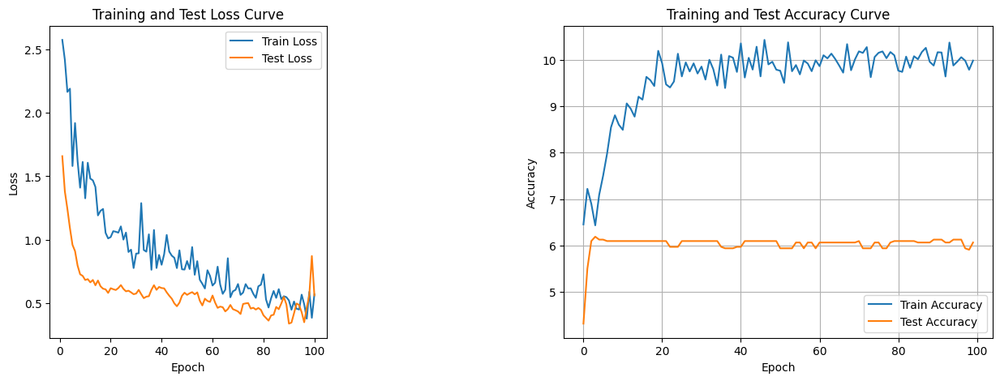

./saved_modelsmodel_31.pth
32


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.36it/s]


Total Epochs: 100
Train loss start: 3.019559860229492, Train loss end: 0.5165206789970398
Highest Train Accuracy: 13.5
Test loss start: 1.4159380197525024, Test loss end: 0.47059518098831177
Highest Test Accuracy: 10.875


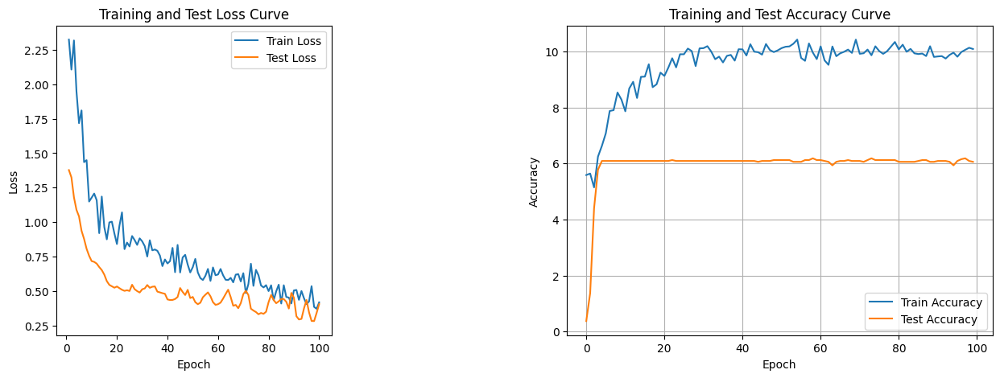

./saved_modelsmodel_32.pth
38


Training Process: 100%|██████████| 100/100 [00:02<00:00, 37.95it/s]


Total Epochs: 100
Train loss start: 0.2307516485452652, Train loss end: 0.03916994854807854
Highest Train Accuracy: 14.09375
Test loss start: 0.2911982238292694, Test loss end: 0.068069688975811
Highest Test Accuracy: 10.9375


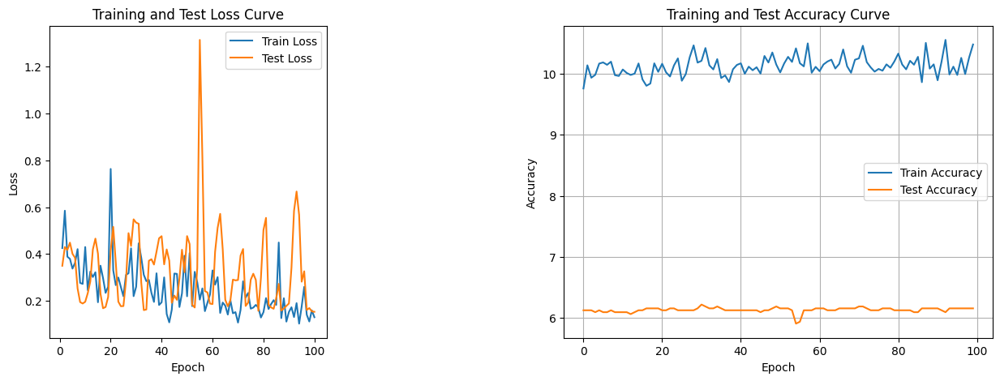

./saved_modelsmodel_38.pth
39


Training Process: 100%|██████████| 100/100 [00:02<00:00, 37.08it/s]


Total Epochs: 100
Train loss start: 0.18813185393810272, Train loss end: 0.03526676818728447
Highest Train Accuracy: 14.375
Test loss start: 0.18861594796180725, Test loss end: 0.6672796010971069
Highest Test Accuracy: 10.875


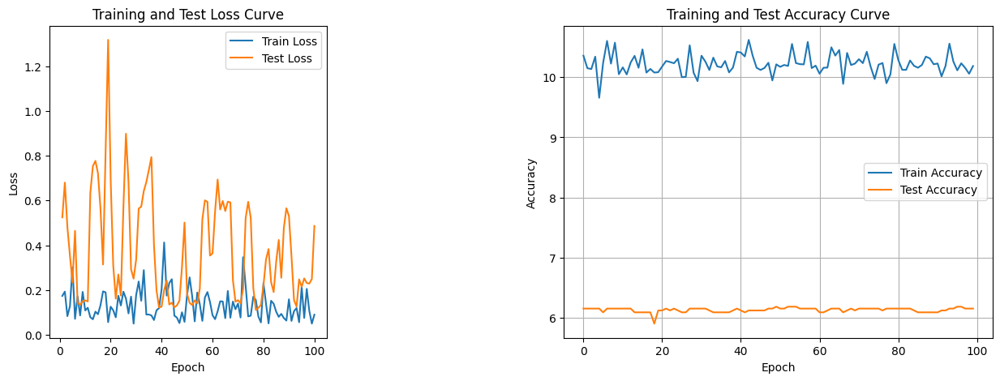

./saved_modelsmodel_39.pth
37


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.59it/s]


Total Epochs: 100
Train loss start: 0.20036150515079498, Train loss end: 0.09263797849416733
Highest Train Accuracy: 14.25
Test loss start: 0.30899038910865784, Test loss end: 0.8343542218208313
Highest Test Accuracy: 10.875


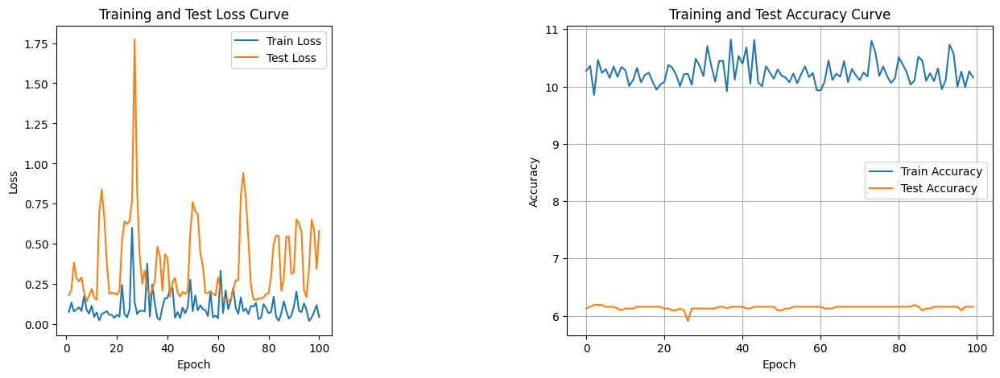

./saved_modelsmodel_37.pth
39


Training Process: 100%|██████████| 100/100 [00:02<00:00, 35.71it/s]


Total Epochs: 100
Train loss start: 0.013774698600172997, Train loss end: 0.04573126882314682
Highest Train Accuracy: 15.75
Test loss start: 0.2199714034795761, Test loss end: 1.1070181131362915
Highest Test Accuracy: 10.8125


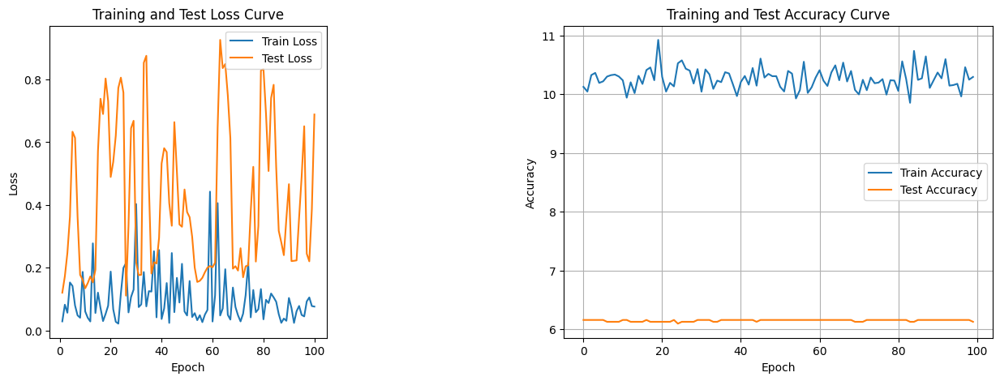

./saved_modelsmodel_39.pth
40


Training Process: 100%|██████████| 100/100 [00:02<00:00, 37.27it/s]


Total Epochs: 100
Train loss start: 0.013222899287939072, Train loss end: 0.0033990219235420227
Highest Train Accuracy: 15.8125
Test loss start: 0.279423326253891, Test loss end: 0.8222432732582092
Highest Test Accuracy: 10.8125


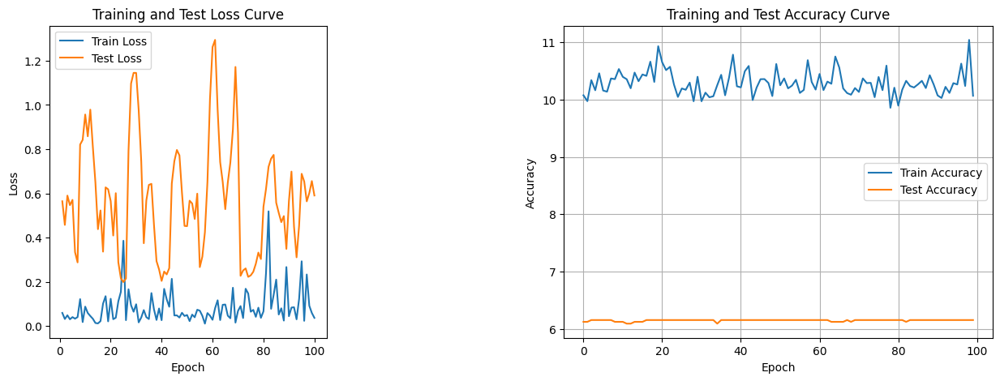

./saved_modelsmodel_40.pth
38


Training Process: 100%|██████████| 100/100 [00:02<00:00, 37.51it/s]


Total Epochs: 100
Train loss start: 0.043905772268772125, Train loss end: 0.029981696978211403
Highest Train Accuracy: 14.8125
Test loss start: 0.3148011863231659, Test loss end: 0.8097074627876282
Highest Test Accuracy: 10.875


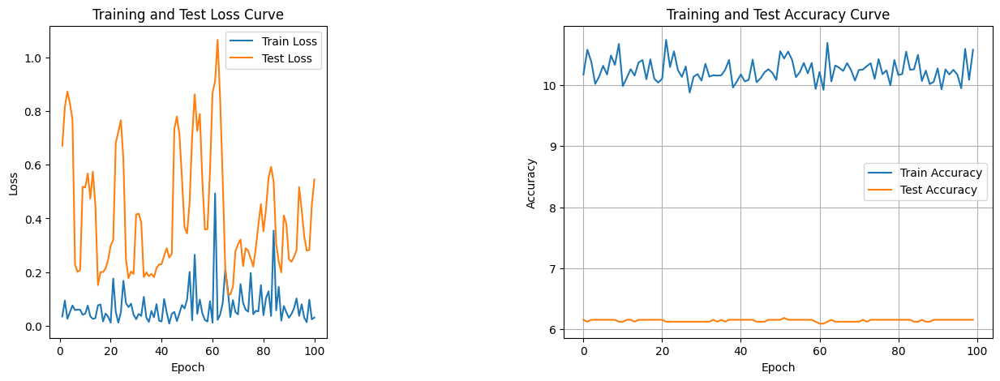

./saved_modelsmodel_38.pth
36


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.21it/s]


Total Epochs: 100
Train loss start: 0.05996707081794739, Train loss end: 0.01118630450218916
Highest Train Accuracy: 14.6875
Test loss start: 0.20412354171276093, Test loss end: 2.0400121212005615
Highest Test Accuracy: 10.8125


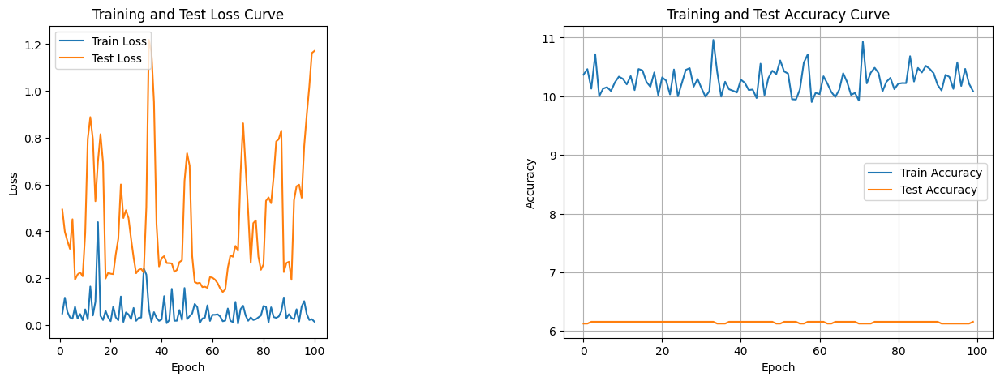

./saved_modelsmodel_36.pth
39


Training Process: 100%|██████████| 100/100 [00:02<00:00, 37.04it/s]


Total Epochs: 100
Train loss start: 0.010155322961509228, Train loss end: 0.4581943452358246
Highest Train Accuracy: 14.8125
Test loss start: 0.26572027802467346, Test loss end: 1.4965744018554688
Highest Test Accuracy: 10.8125


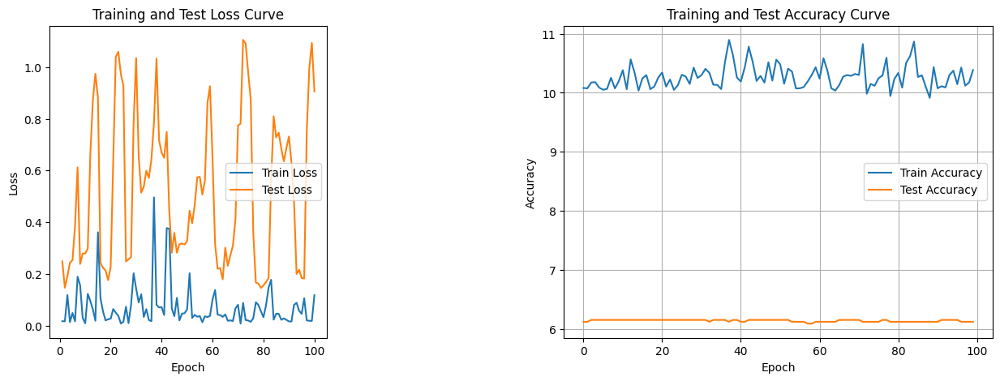

./saved_modelsmodel_39.pth
40


Training Process: 100%|██████████| 100/100 [00:03<00:00, 32.12it/s]


Total Epochs: 100
Train loss start: 0.17385001480579376, Train loss end: 0.14172586798667908
Highest Train Accuracy: 14.8125
Test loss start: 0.4166550040245056, Test loss end: 0.8381150960922241
Highest Test Accuracy: 10.875


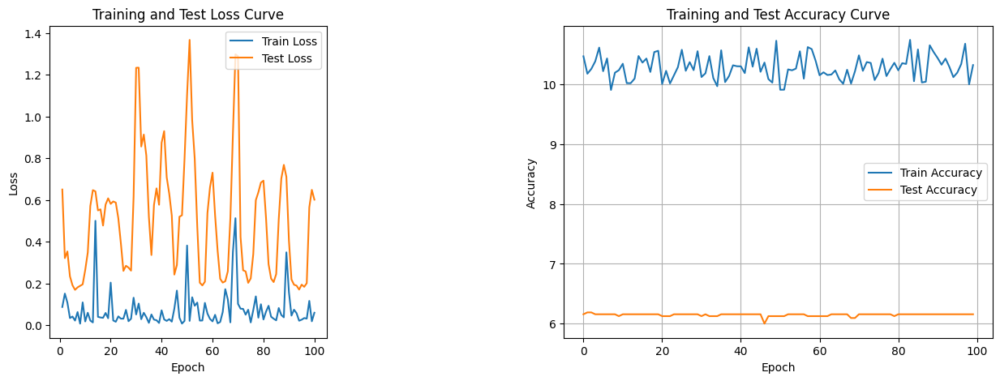

./saved_modelsmodel_40.pth
38


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.92it/s]


Total Epochs: 100
Train loss start: 0.021428128704428673, Train loss end: 0.004176303278654814
Highest Train Accuracy: 15.0
Test loss start: 0.2508174479007721, Test loss end: 1.0075849294662476
Highest Test Accuracy: 10.8125


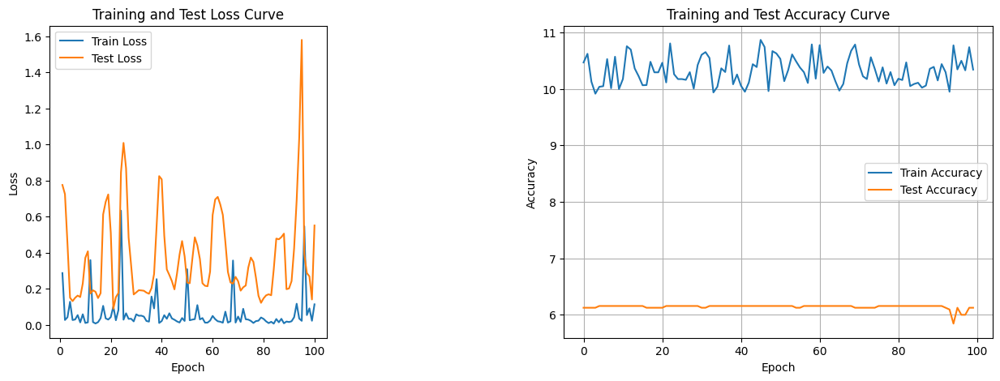

./saved_modelsmodel_38.pth
40


Training Process: 100%|██████████| 100/100 [00:02<00:00, 34.07it/s]


Total Epochs: 100
Train loss start: 0.025838468223810196, Train loss end: 0.016749946400523186
Highest Train Accuracy: 15.28125
Test loss start: 0.21232393383979797, Test loss end: 0.6826040744781494
Highest Test Accuracy: 10.875


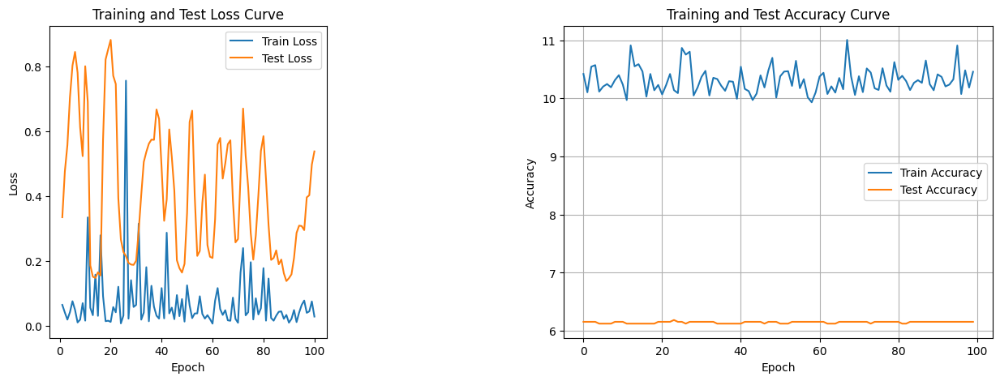

./saved_modelsmodel_40.pth
41


Training Process: 100%|██████████| 100/100 [00:02<00:00, 38.20it/s]


Total Epochs: 100
Train loss start: 0.00516099575906992, Train loss end: 0.013442366383969784
Highest Train Accuracy: 14.96875
Test loss start: 0.37604743242263794, Test loss end: 0.10530391335487366
Highest Test Accuracy: 10.8125


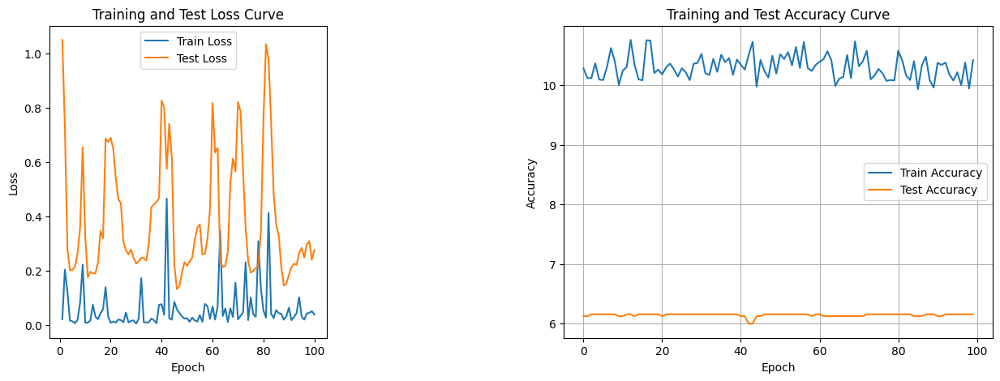

./saved_modelsmodel_41.pth
39


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.71it/s]


Total Epochs: 100
Train loss start: 0.0012712571769952774, Train loss end: 1.5793430805206299
Highest Train Accuracy: 17.75
Test loss start: 0.38959965109825134, Test loss end: 0.011386777274310589
Highest Test Accuracy: 10.8125


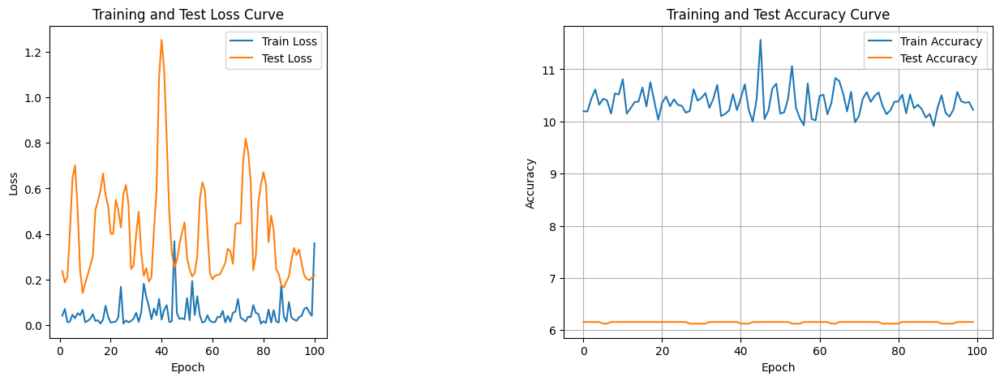

./saved_modelsmodel_39.pth
37


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.94it/s]


Total Epochs: 100
Train loss start: 0.05138980224728584, Train loss end: 0.30217400193214417
Highest Train Accuracy: 14.34375
Test loss start: 0.31455886363983154, Test loss end: 0.11654312163591385
Highest Test Accuracy: 10.875


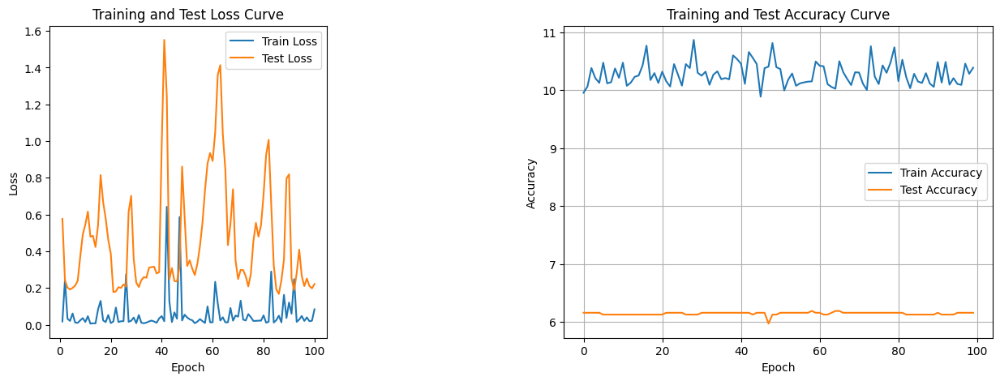

./saved_modelsmodel_37.pth
35


Training Process: 100%|██████████| 100/100 [00:02<00:00, 37.95it/s]


Total Epochs: 100
Train loss start: 0.0043931943364441395, Train loss end: 0.010528497397899628
Highest Train Accuracy: 15.3125
Test loss start: 0.22348518669605255, Test loss end: 0.5545326471328735
Highest Test Accuracy: 10.8125


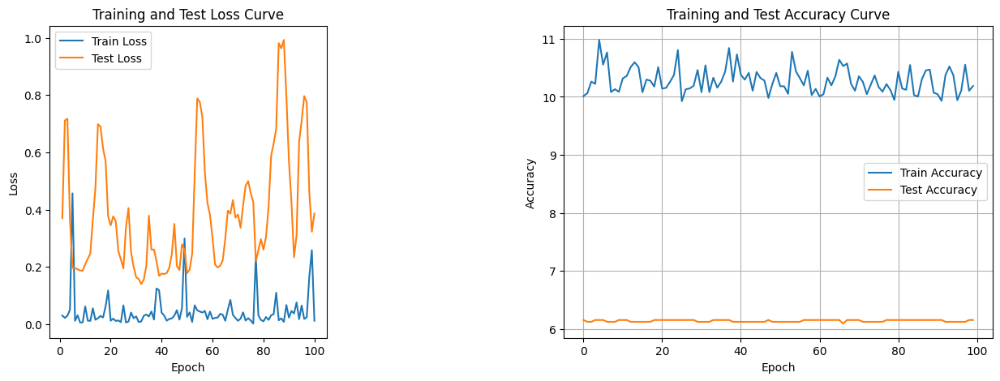

./saved_modelsmodel_35.pth
39


Training Process: 100%|██████████| 100/100 [00:02<00:00, 33.42it/s]


Total Epochs: 100
Train loss start: 0.027761101722717285, Train loss end: 0.00883337203413248
Highest Train Accuracy: 14.75
Test loss start: 0.32355380058288574, Test loss end: 0.7722812294960022
Highest Test Accuracy: 10.8125


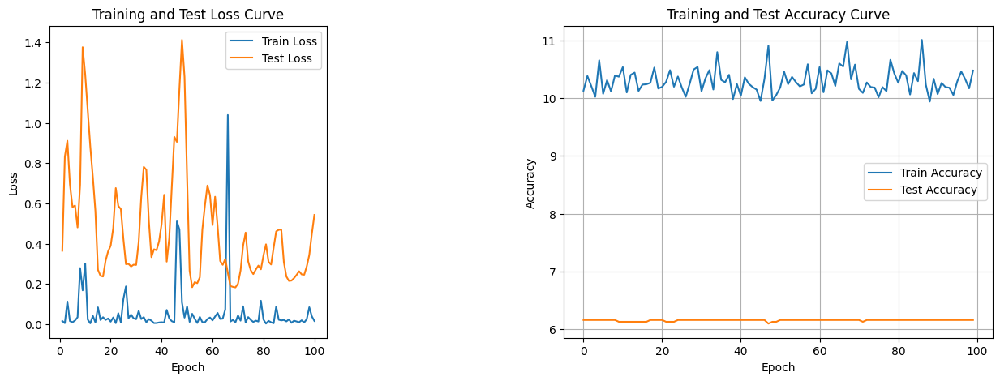

./saved_modelsmodel_39.pth
40


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.81it/s]


Total Epochs: 100
Train loss start: 0.02503812313079834, Train loss end: 0.008785330690443516
Highest Train Accuracy: 14.6875
Test loss start: 0.38613077998161316, Test loss end: 0.3533589541912079
Highest Test Accuracy: 10.875


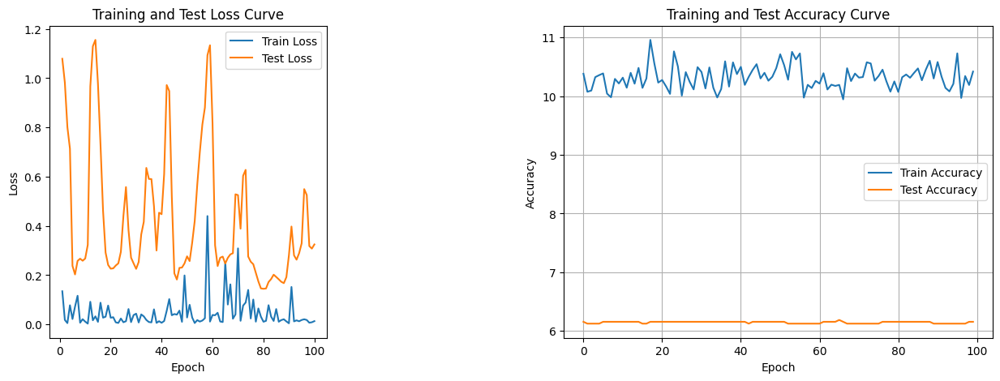

./saved_modelsmodel_40.pth
38


Training Process: 100%|██████████| 100/100 [00:02<00:00, 35.89it/s]


Total Epochs: 100
Train loss start: 0.007178836036473513, Train loss end: 0.9504339098930359
Highest Train Accuracy: 15.21875
Test loss start: 0.33472320437431335, Test loss end: 0.3431454598903656
Highest Test Accuracy: 10.875


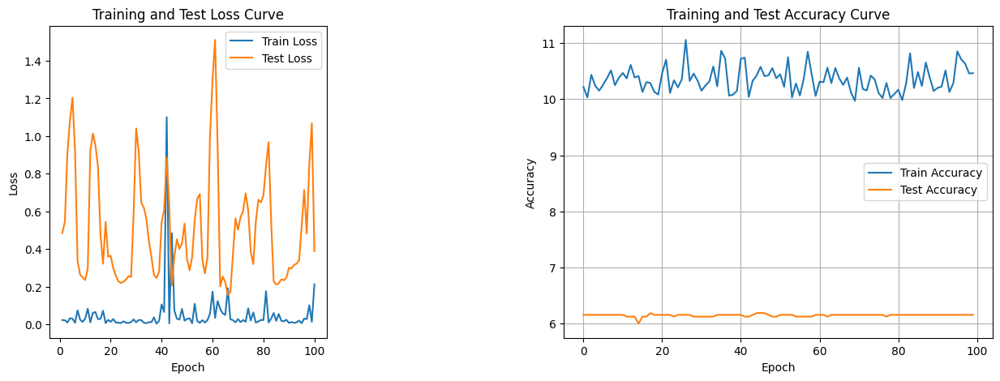

./saved_modelsmodel_38.pth
40


Training Process: 100%|██████████| 100/100 [00:02<00:00, 35.16it/s]


Total Epochs: 100
Train loss start: 0.05716630071401596, Train loss end: 0.050951745361089706
Highest Train Accuracy: 14.8125
Test loss start: 0.4732891023159027, Test loss end: 0.035125184804201126
Highest Test Accuracy: 10.8125


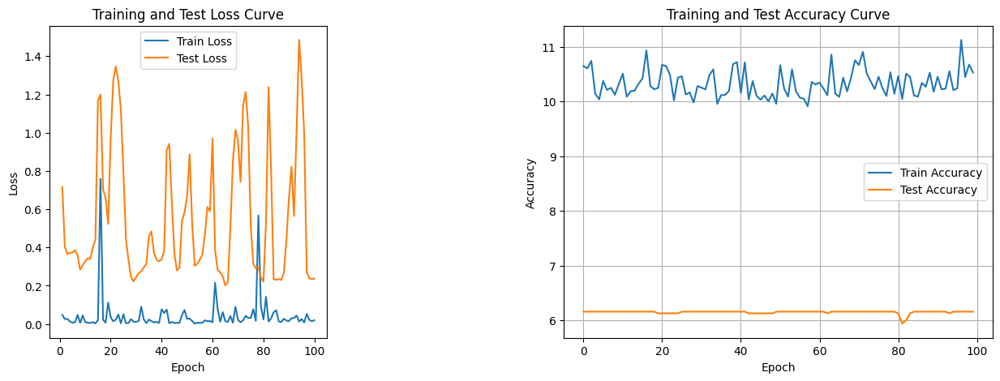

./saved_modelsmodel_40.pth
41


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.46it/s]


Total Epochs: 100
Train loss start: 0.011023292317986488, Train loss end: 0.6384425163269043
Highest Train Accuracy: 15.0
Test loss start: 0.5214226841926575, Test loss end: 0.5621301531791687
Highest Test Accuracy: 10.8125


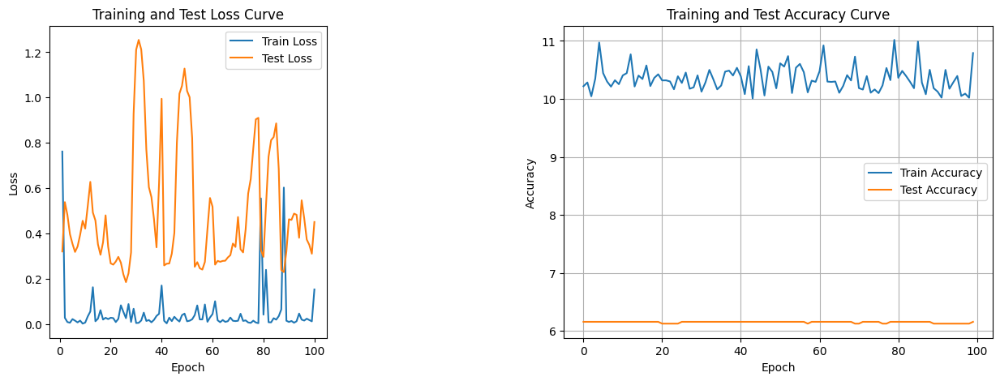

./saved_modelsmodel_41.pth
39


Training Process: 100%|██████████| 100/100 [00:02<00:00, 35.71it/s]


Total Epochs: 100
Train loss start: 0.0465821847319603, Train loss end: 9.455538383917883e-05
Highest Train Accuracy: 14.8125
Test loss start: 0.26916593313217163, Test loss end: 1.1120105981826782
Highest Test Accuracy: 10.8125


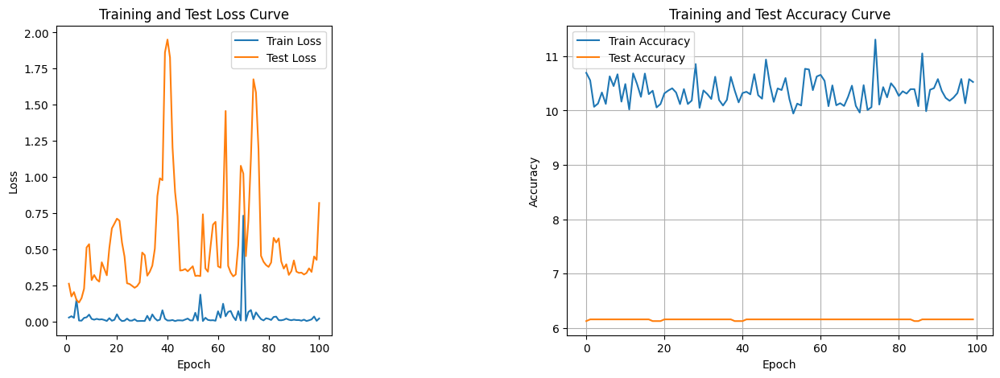

./saved_modelsmodel_39.pth
37


Training Process: 100%|██████████| 100/100 [00:02<00:00, 34.54it/s]


Total Epochs: 100
Train loss start: 0.001710987533442676, Train loss end: 0.058455150574445724
Highest Train Accuracy: 15.5
Test loss start: 0.5993649959564209, Test loss end: 0.6130387187004089
Highest Test Accuracy: 10.8125


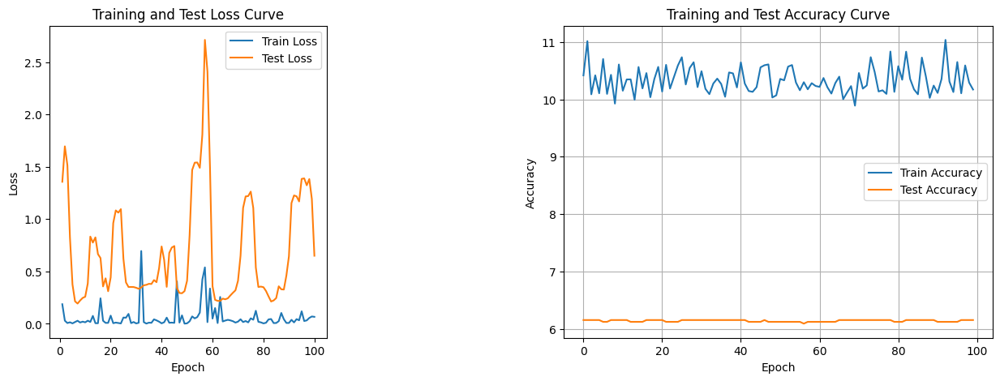

./saved_modelsmodel_37.pth
40


Training Process: 100%|██████████| 100/100 [00:02<00:00, 35.72it/s]


Total Epochs: 100
Train loss start: 0.1435738354921341, Train loss end: 0.00912890862673521
Highest Train Accuracy: 14.8125
Test loss start: 0.5463098883628845, Test loss end: 0.48329704999923706
Highest Test Accuracy: 10.8125


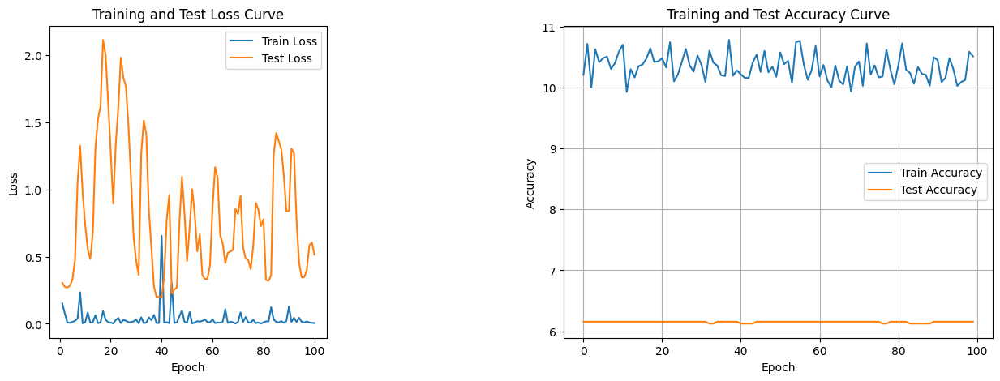

./saved_modelsmodel_40.pth
41


Training Process: 100%|██████████| 100/100 [00:02<00:00, 37.26it/s]


Total Epochs: 100
Train loss start: 0.003212555078789592, Train loss end: 0.0006003871676512063
Highest Train Accuracy: 15.8125
Test loss start: 0.4879448711872101, Test loss end: 0.8188729286193848
Highest Test Accuracy: 10.875


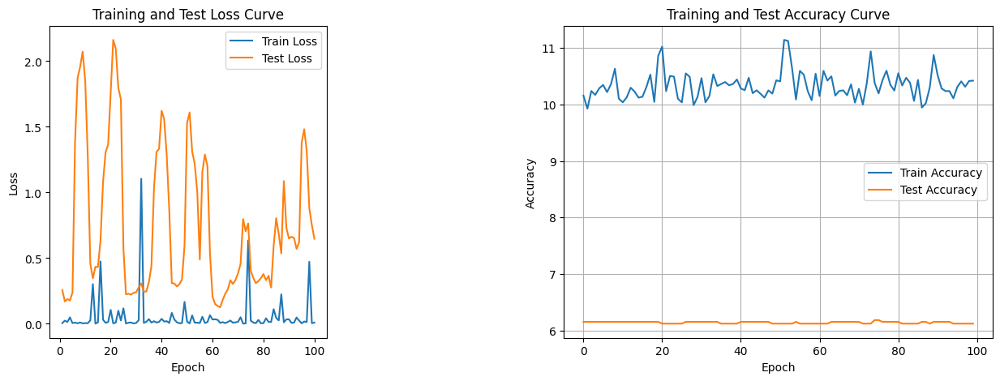

./saved_modelsmodel_41.pth
39


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.00it/s]


Total Epochs: 100
Train loss start: 0.2420186847448349, Train loss end: 0.007950407452881336
Highest Train Accuracy: 14.3125
Test loss start: 0.49467039108276367, Test loss end: 0.2336367666721344
Highest Test Accuracy: 10.875


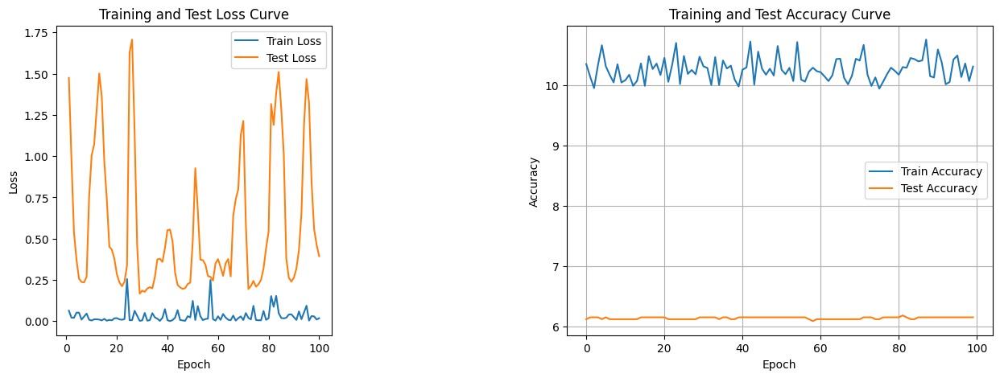

./saved_modelsmodel_39.pth
41


Training Process: 100%|██████████| 100/100 [00:02<00:00, 35.50it/s]


Total Epochs: 100
Train loss start: 0.022593749687075615, Train loss end: 0.0021980616729706526
Highest Train Accuracy: 15.8125
Test loss start: 0.44778943061828613, Test loss end: 0.4691176116466522
Highest Test Accuracy: 10.8125


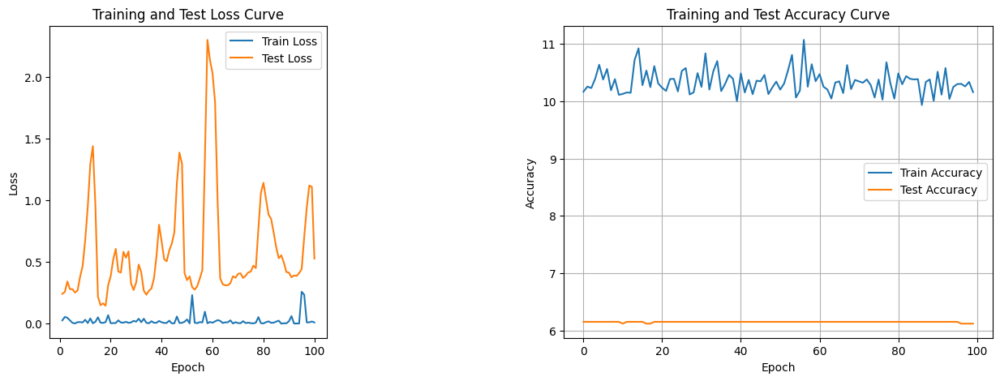

./saved_modelsmodel_41.pth
42


Training Process: 100%|██████████| 100/100 [00:02<00:00, 34.68it/s]


Total Epochs: 100
Train loss start: 0.0005139578133821487, Train loss end: 0.07043088227510452
Highest Train Accuracy: 16.75
Test loss start: 0.48429447412490845, Test loss end: 0.1515798717737198
Highest Test Accuracy: 10.8125


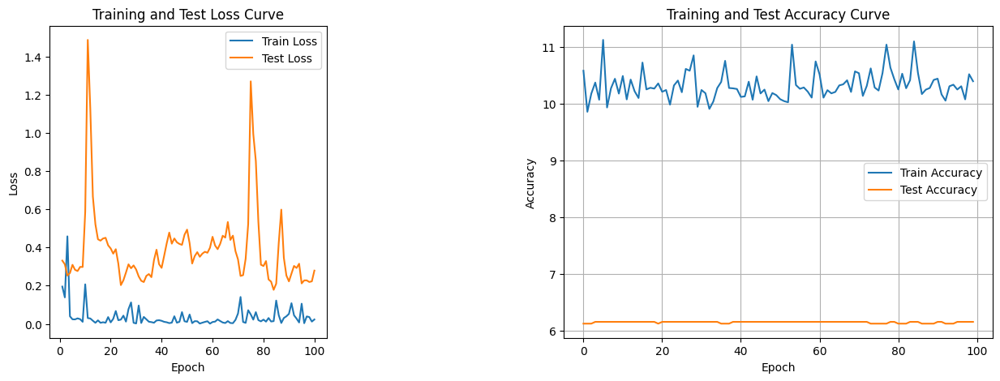

./saved_modelsmodel_42.pth
40


Training Process: 100%|██████████| 100/100 [00:02<00:00, 35.93it/s]


Total Epochs: 100
Train loss start: 0.004506661090999842, Train loss end: 0.014924361370503902
Highest Train Accuracy: 15.0
Test loss start: 0.3048468232154846, Test loss end: 0.08278489112854004
Highest Test Accuracy: 10.8125


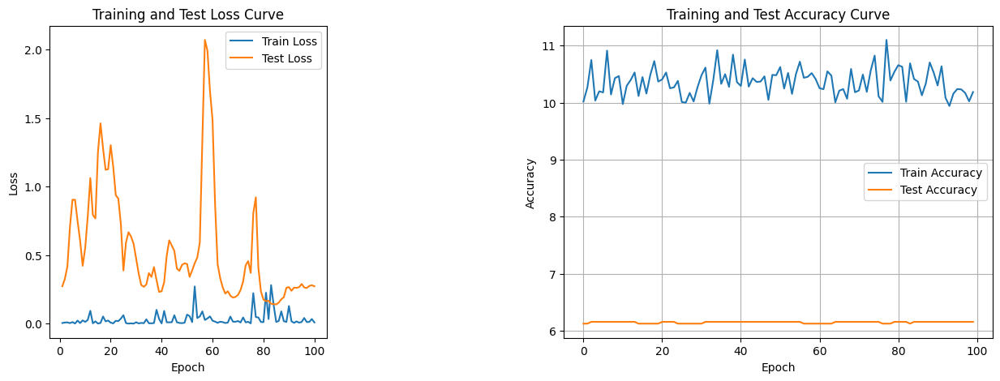

./saved_modelsmodel_40.pth
38


Training Process: 100%|██████████| 100/100 [00:02<00:00, 33.52it/s]


Total Epochs: 100
Train loss start: 0.0034913106355816126, Train loss end: 0.000672987662255764
Highest Train Accuracy: 16.75
Test loss start: 0.34050995111465454, Test loss end: 1.7352169752120972
Highest Test Accuracy: 10.875


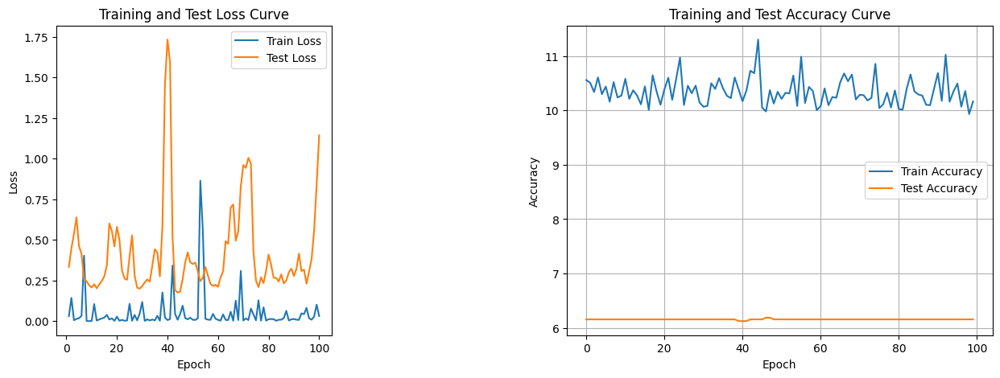

./saved_modelsmodel_38.pth
36


Training Process: 100%|██████████| 100/100 [00:02<00:00, 34.58it/s]


Total Epochs: 100
Train loss start: 0.010682991705834866, Train loss end: 0.18383193016052246
Highest Train Accuracy: 16.25
Test loss start: 0.4042896330356598, Test loss end: 0.8671720623970032
Highest Test Accuracy: 10.8125


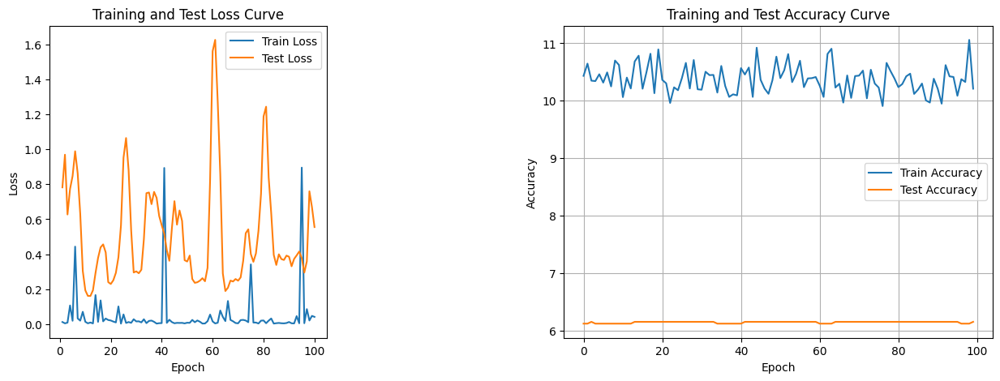

./saved_modelsmodel_36.pth
34


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.31it/s]


Total Epochs: 100
Train loss start: 0.005251397378742695, Train loss end: 0.7049919366836548
Highest Train Accuracy: 16.6875
Test loss start: 0.3549361824989319, Test loss end: 3.779132604598999
Highest Test Accuracy: 10.8125


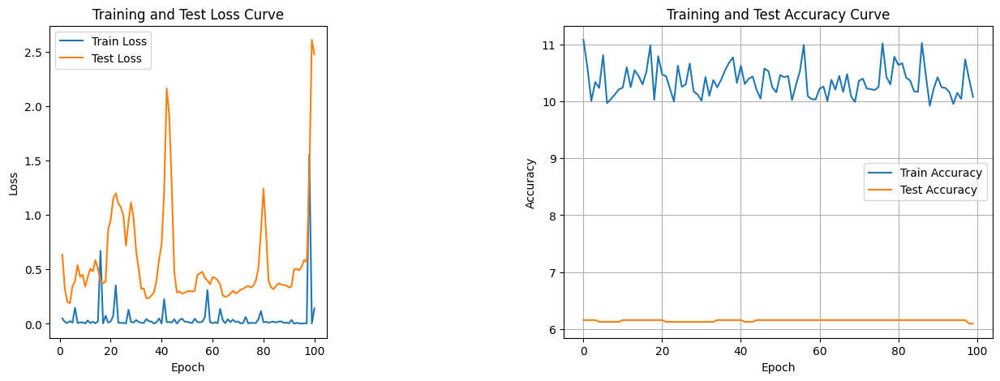

./saved_modelsmodel_34.pth


MLP(
  (layers): ModuleList(
    (0): Linear(in_features=13, out_features=256, bias=True)
    (1): Linear(in_features=256, out_features=128, bias=True)
    (2): Linear(in_features=128, out_features=64, bias=True)
    (3): Linear(in_features=64, out_features=32, bias=True)
  )
  (batch_norms): ModuleList(
    (0): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (output): Linear(in_features=32, out_features=4, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
)

In [ ]:
coverDTEmlp32b.train_DTE()

# Base: 64

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
model1 and model2 are different.
1


Training Process: 100%|██████████| 100/100 [00:02<00:00, 38.46it/s]


Total Epochs: 100
Train loss start: 3.395456075668335, Train loss end: 0.40261292457580566
Highest Train Accuracy: 14.6875
Test loss start: 1.472738265991211, Test loss end: 0.5080194473266602
Highest Test Accuracy: 10.6875


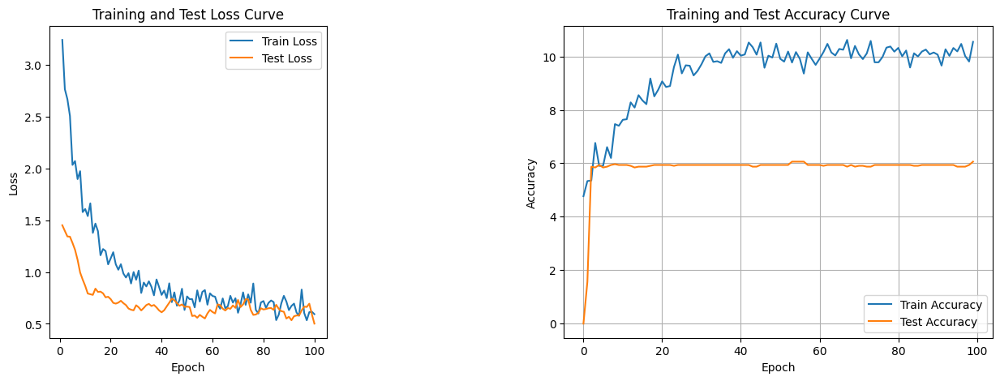

./saved_modelsmodel_1.pth
2


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.59it/s]


Total Epochs: 100
Train loss start: 2.4365499019622803, Train loss end: 0.919826090335846
Highest Train Accuracy: 14.34375
Test loss start: 1.436065673828125, Test loss end: 0.4167577028274536
Highest Test Accuracy: 12.0


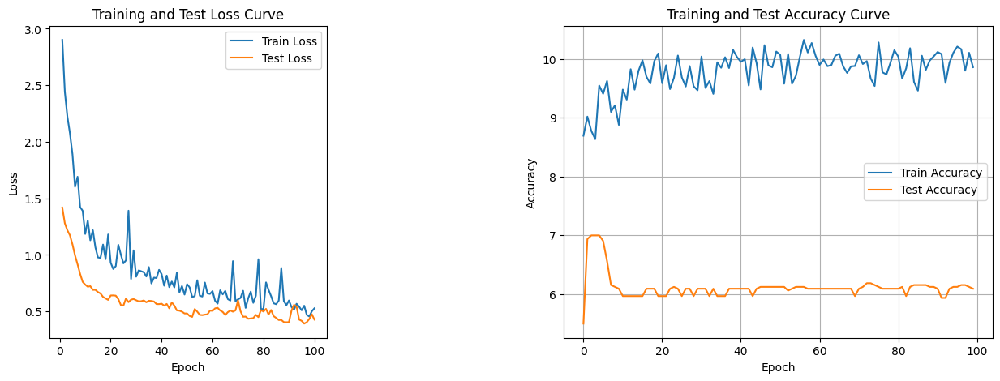

./saved_modelsmodel_2.pth
3


Training Process: 100%|██████████| 100/100 [00:02<00:00, 39.20it/s]


Total Epochs: 100
Train loss start: 3.797133684158325, Train loss end: 0.6316887140274048
Highest Train Accuracy: 14.09375
Test loss start: 1.6232599020004272, Test loss end: 0.3179609477519989
Highest Test Accuracy: 10.75


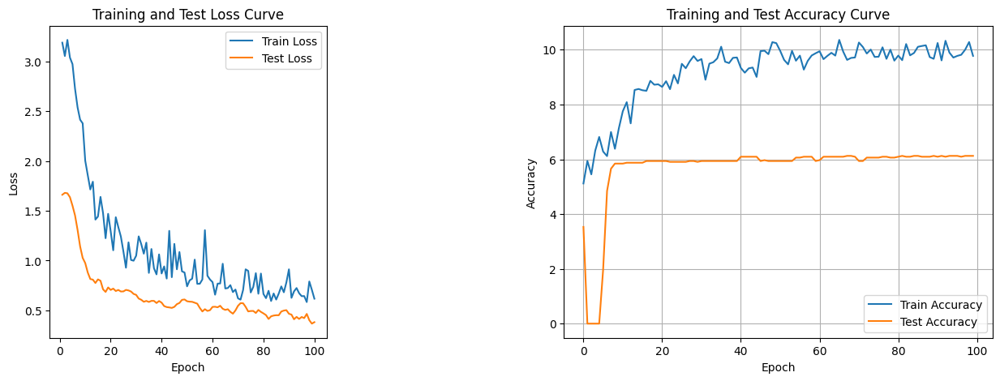

./saved_modelsmodel_3.pth
4


Training Process: 100%|██████████| 100/100 [00:02<00:00, 35.71it/s]


Total Epochs: 100
Train loss start: 2.4809322357177734, Train loss end: 0.7983774542808533
Highest Train Accuracy: 14.6875
Test loss start: 1.4280815124511719, Test loss end: 0.726958692073822
Highest Test Accuracy: 10.625


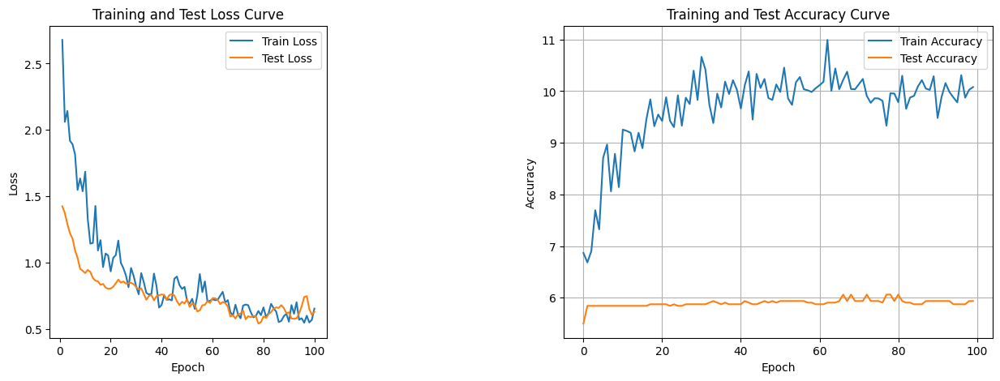

./saved_modelsmodel_4.pth
5


Training Process: 100%|██████████| 100/100 [00:02<00:00, 37.73it/s]


Total Epochs: 100
Train loss start: 2.8042943477630615, Train loss end: 0.8911746144294739
Highest Train Accuracy: 16.3125
Test loss start: 1.4070554971694946, Test loss end: 0.5160204768180847
Highest Test Accuracy: 10.6875


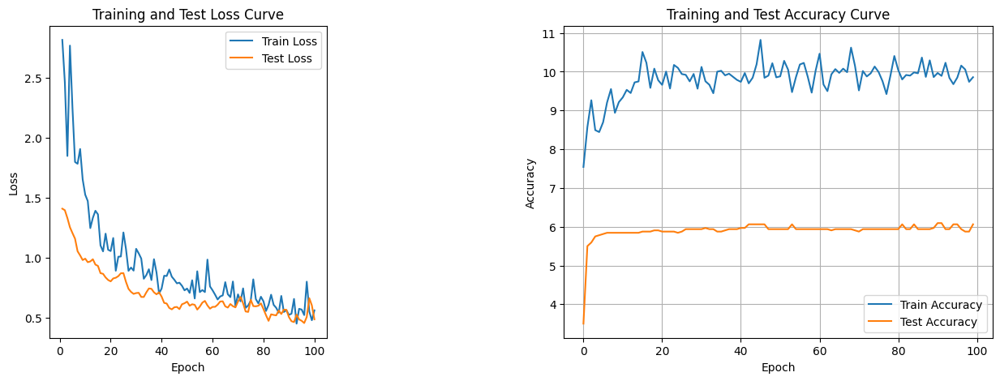

./saved_modelsmodel_5.pth
6


Training Process: 100%|██████████| 100/100 [00:02<00:00, 37.20it/s]


Total Epochs: 100
Train loss start: 2.951822280883789, Train loss end: 0.4031597077846527
Highest Train Accuracy: 14.71875
Test loss start: 1.7266812324523926, Test loss end: 0.5551548600196838
Highest Test Accuracy: 10.6875


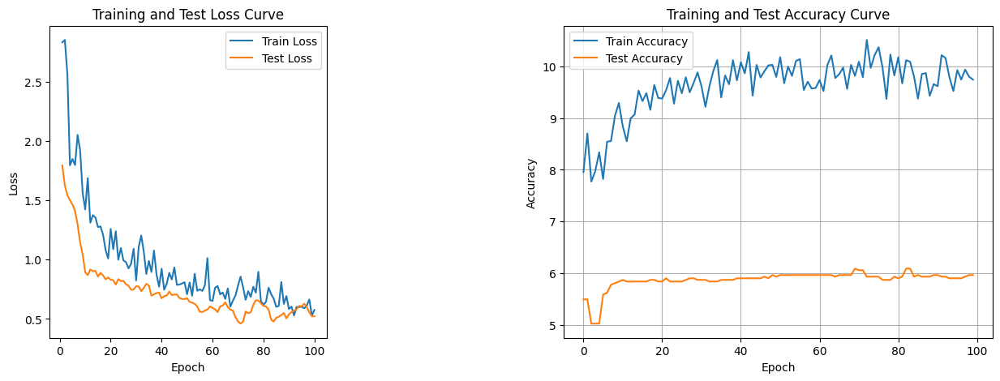

./saved_modelsmodel_6.pth
7


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.57it/s]


Total Epochs: 100
Train loss start: 2.761500358581543, Train loss end: 0.38880929350852966
Highest Train Accuracy: 14.90625
Test loss start: 1.3052304983139038, Test loss end: 0.3222161531448364
Highest Test Accuracy: 12.0


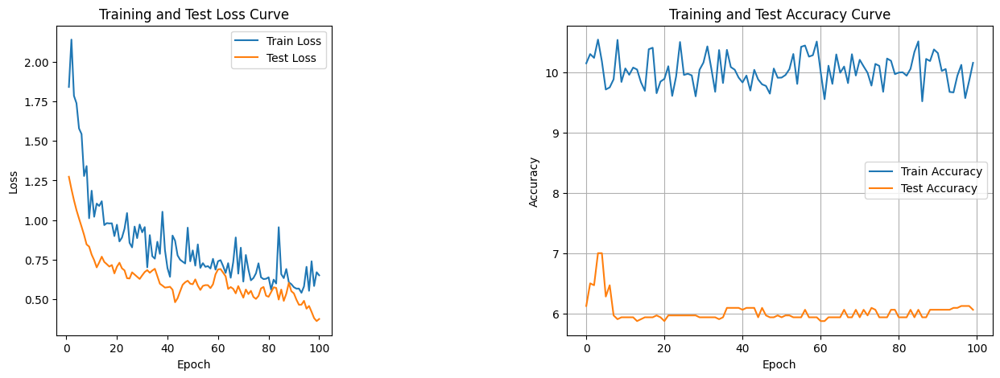

./saved_modelsmodel_7.pth
8


Training Process: 100%|██████████| 100/100 [00:02<00:00, 38.07it/s]


Total Epochs: 100
Train loss start: 2.95306396484375, Train loss end: 0.46074509620666504
Highest Train Accuracy: 13.5625
Test loss start: 1.2792348861694336, Test loss end: 0.5359271168708801
Highest Test Accuracy: 10.75


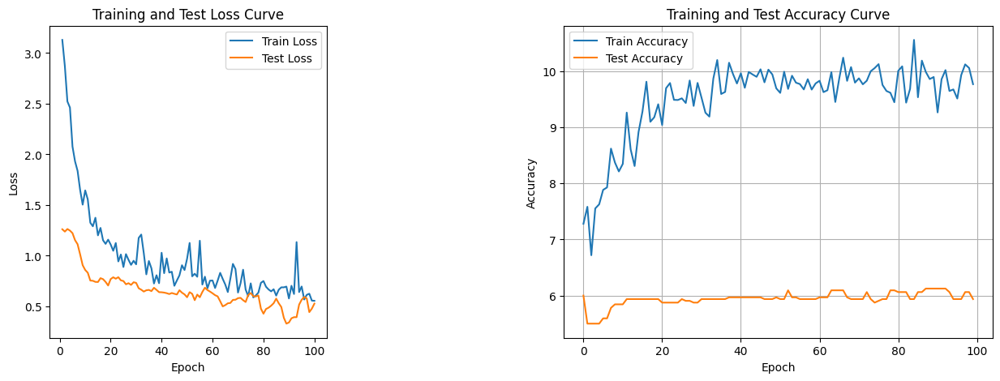

./saved_modelsmodel_8.pth
9


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.59it/s]


Total Epochs: 100
Train loss start: 2.741154909133911, Train loss end: 0.6084041595458984
Highest Train Accuracy: 15.28125
Test loss start: 1.3107575178146362, Test loss end: 0.5245797634124756
Highest Test Accuracy: 12.0


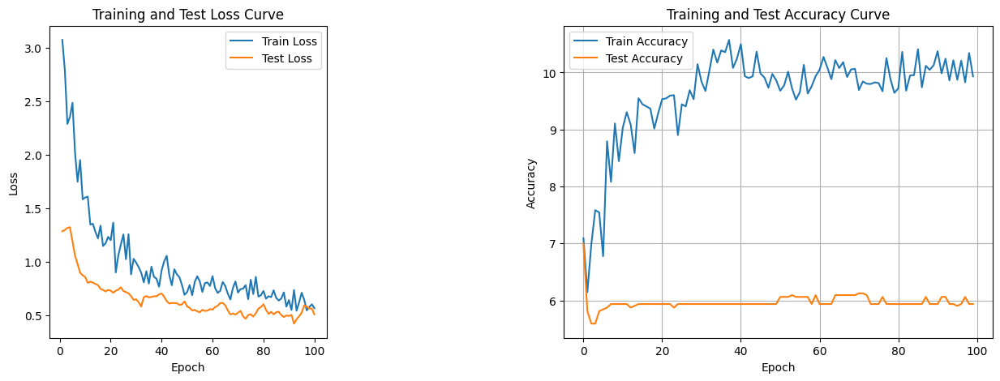

./saved_modelsmodel_9.pth
10


Training Process: 100%|██████████| 100/100 [00:02<00:00, 37.96it/s]


Total Epochs: 100
Train loss start: 3.401130199432373, Train loss end: 0.7198008298873901
Highest Train Accuracy: 13.5
Test loss start: 1.9531168937683105, Test loss end: 0.5379477143287659
Highest Test Accuracy: 10.6875


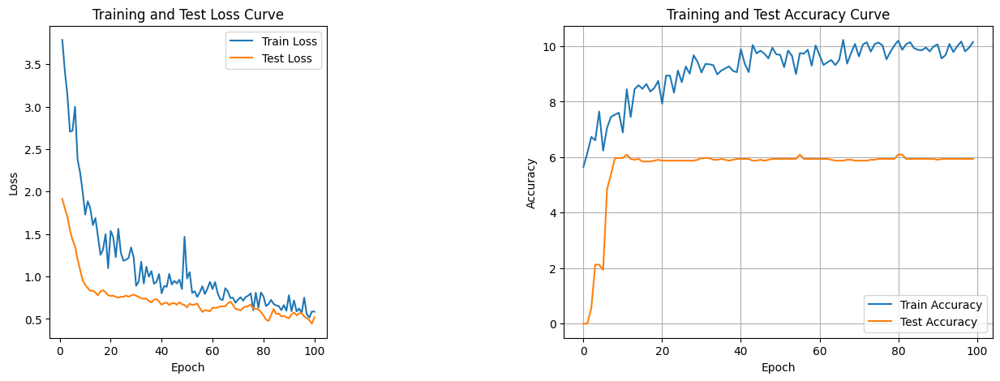

./saved_modelsmodel_10.pth
11


Training Process: 100%|██████████| 100/100 [00:02<00:00, 40.29it/s]


Total Epochs: 100
Train loss start: 2.3893353939056396, Train loss end: 0.4425032436847687
Highest Train Accuracy: 13.9375
Test loss start: 1.5352863073349, Test loss end: 0.47699424624443054
Highest Test Accuracy: 10.75


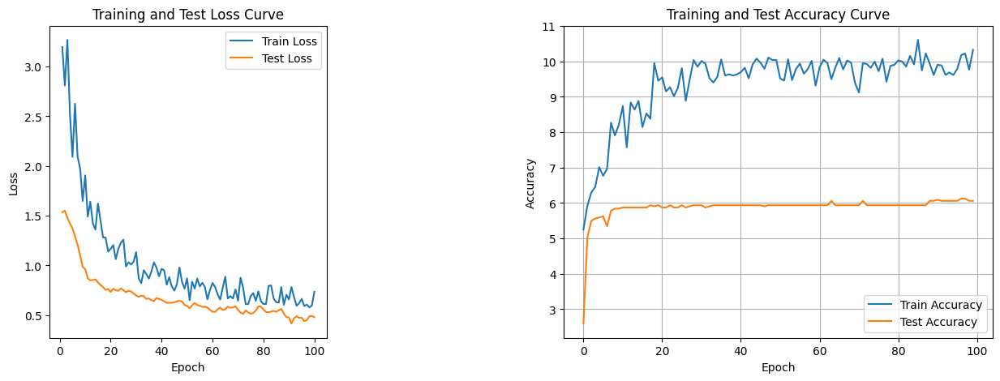

./saved_modelsmodel_11.pth
12


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.58it/s]


Total Epochs: 100
Train loss start: 3.303914785385132, Train loss end: 0.9161720871925354
Highest Train Accuracy: 13.53125
Test loss start: 1.5318471193313599, Test loss end: 0.38495463132858276
Highest Test Accuracy: 10.75


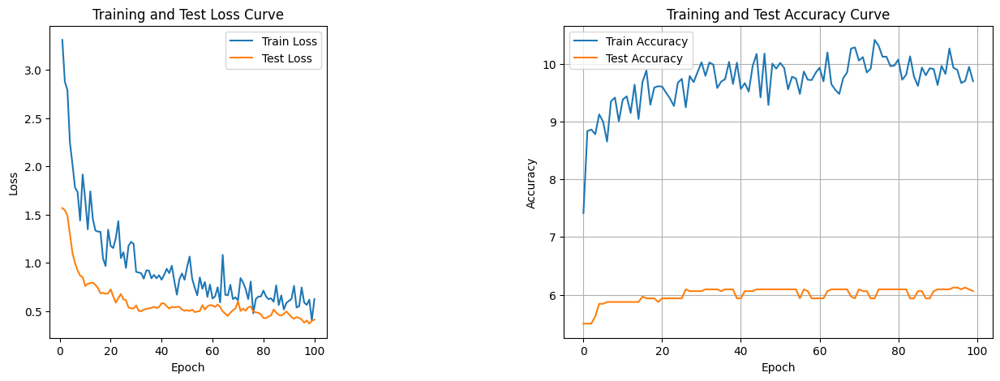

./saved_modelsmodel_12.pth
13


Training Process: 100%|██████████| 100/100 [00:02<00:00, 38.46it/s]


Total Epochs: 100
Train loss start: 3.013842821121216, Train loss end: 0.42331749200820923
Highest Train Accuracy: 13.84375
Test loss start: 1.338871717453003, Test loss end: 0.8604879975318909
Highest Test Accuracy: 10.8125


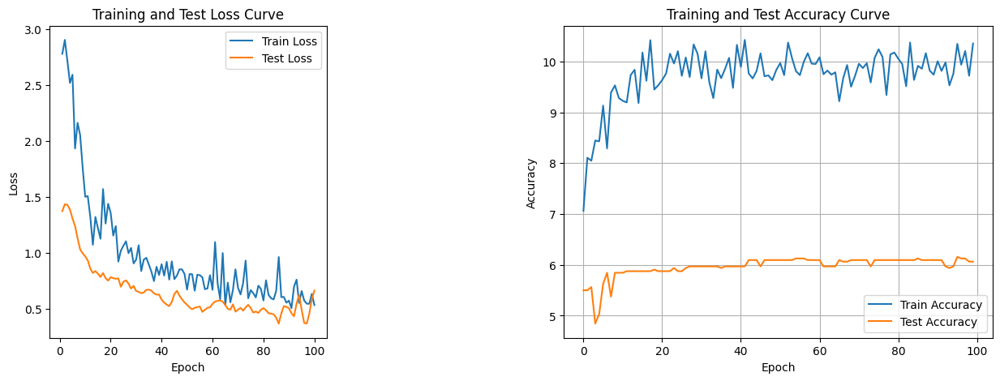

./saved_modelsmodel_13.pth
14


Training Process: 100%|██████████| 100/100 [00:02<00:00, 37.17it/s]


Total Epochs: 100
Train loss start: 3.486229181289673, Train loss end: 0.4048590064048767
Highest Train Accuracy: 13.96875
Test loss start: 1.2302262783050537, Test loss end: 0.43577444553375244
Highest Test Accuracy: 11.9375


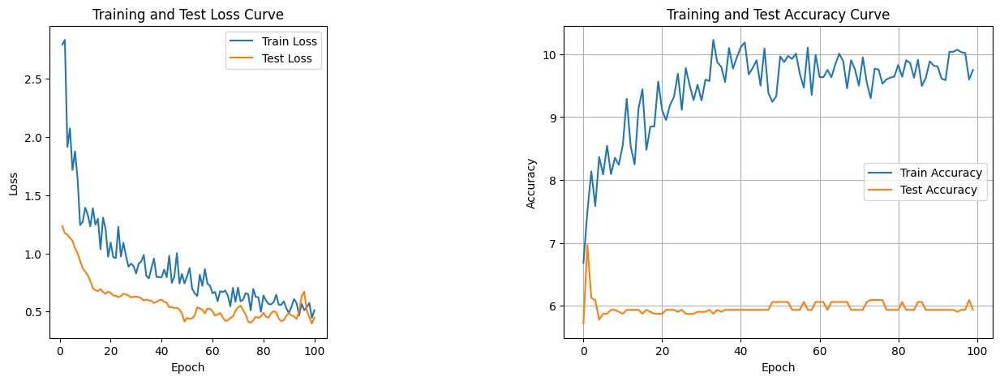

./saved_modelsmodel_14.pth
15


Training Process: 100%|██████████| 100/100 [00:02<00:00, 38.40it/s]


Total Epochs: 100
Train loss start: 1.8116137981414795, Train loss end: 0.3136220872402191
Highest Train Accuracy: 14.375
Test loss start: 1.3082599639892578, Test loss end: 0.5270956754684448
Highest Test Accuracy: 12.0


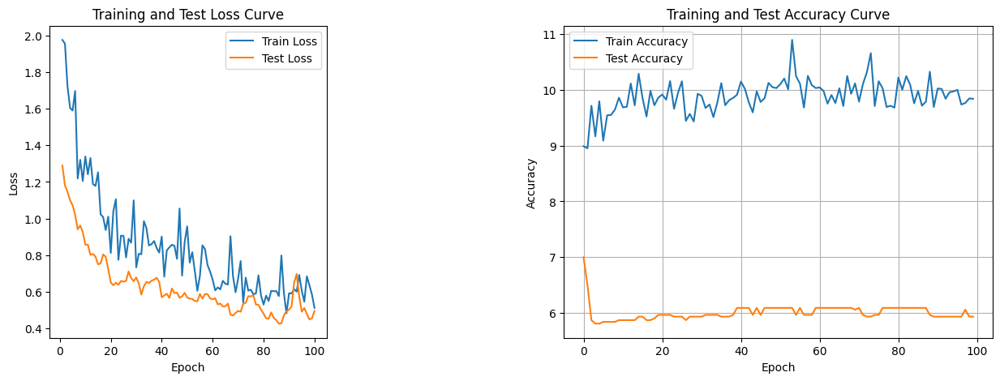

./saved_modelsmodel_15.pth
16


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.87it/s]


Total Epochs: 100
Train loss start: 2.4061362743377686, Train loss end: 0.390855997800827
Highest Train Accuracy: 14.28125
Test loss start: 1.3455288410186768, Test loss end: 0.45454180240631104
Highest Test Accuracy: 10.6875


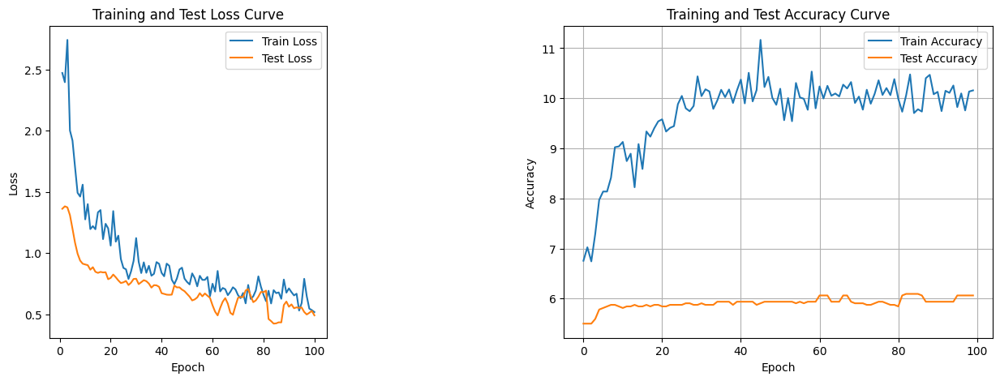

./saved_modelsmodel_16.pth
17


Training Process: 100%|██████████| 100/100 [00:02<00:00, 37.27it/s]


Total Epochs: 100
Train loss start: 2.452996253967285, Train loss end: 0.3735012412071228
Highest Train Accuracy: 13.90625
Test loss start: 1.2020421028137207, Test loss end: 0.7299259305000305
Highest Test Accuracy: 10.6875


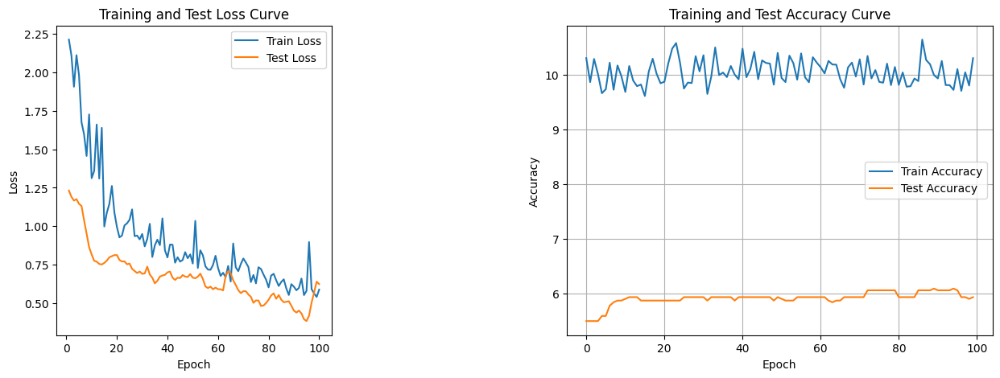

./saved_modelsmodel_17.pth
18


Training Process: 100%|██████████| 100/100 [00:02<00:00, 38.23it/s]


Total Epochs: 100
Train loss start: 3.2919883728027344, Train loss end: 0.6208992004394531
Highest Train Accuracy: 16.96875
Test loss start: 1.4380162954330444, Test loss end: 0.6845768094062805
Highest Test Accuracy: 12.0


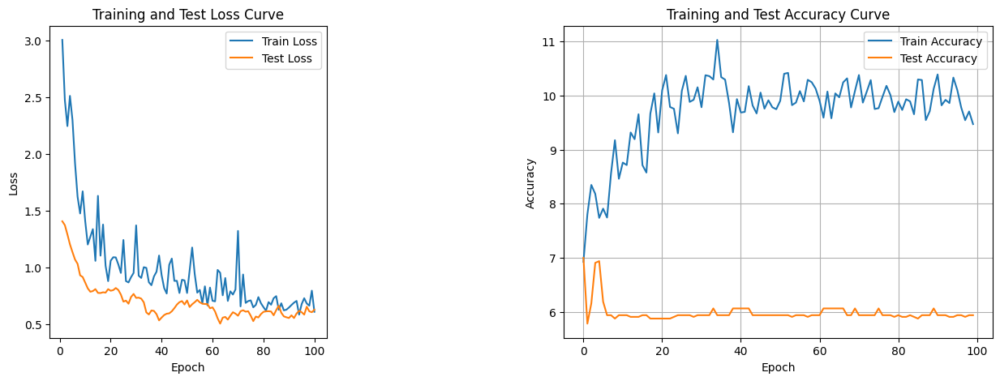

./saved_modelsmodel_18.pth
19


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.55it/s]


Total Epochs: 100
Train loss start: 4.356669902801514, Train loss end: 0.671896755695343
Highest Train Accuracy: 14.90625
Test loss start: 1.2720489501953125, Test loss end: 0.5731911063194275
Highest Test Accuracy: 12.0


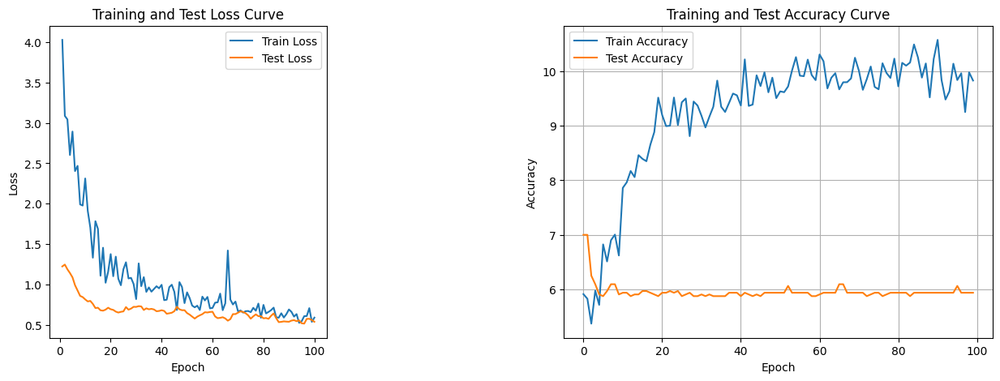

./saved_modelsmodel_19.pth
20


Training Process: 100%|██████████| 100/100 [00:02<00:00, 34.89it/s]


Total Epochs: 100
Train loss start: 3.32138991355896, Train loss end: 0.7820871472358704
Highest Train Accuracy: 14.78125
Test loss start: 1.3348057270050049, Test loss end: 0.6191044449806213
Highest Test Accuracy: 10.6875


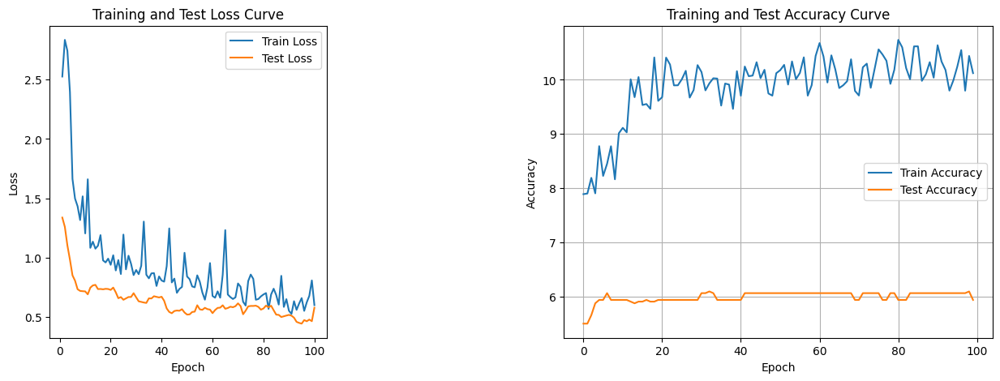

./saved_modelsmodel_20.pth
21


Training Process: 100%|██████████| 100/100 [00:02<00:00, 38.97it/s]


Total Epochs: 100
Train loss start: 2.7175405025482178, Train loss end: 0.2962702810764313
Highest Train Accuracy: 14.125
Test loss start: 1.406544804573059, Test loss end: 0.8105441331863403
Highest Test Accuracy: 12.0


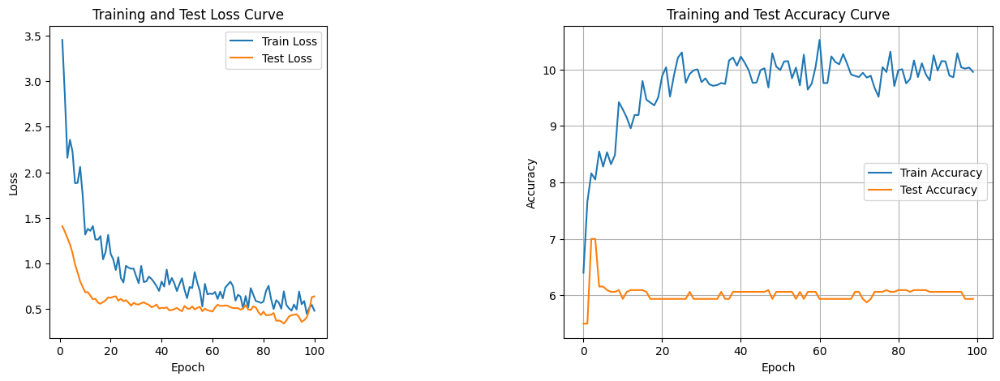

./saved_modelsmodel_21.pth
22


Training Process: 100%|██████████| 100/100 [00:02<00:00, 37.38it/s]


Total Epochs: 100
Train loss start: 2.76841402053833, Train loss end: 0.5063582062721252
Highest Train Accuracy: 14.25
Test loss start: 1.5020198822021484, Test loss end: 0.4531143605709076
Highest Test Accuracy: 10.75


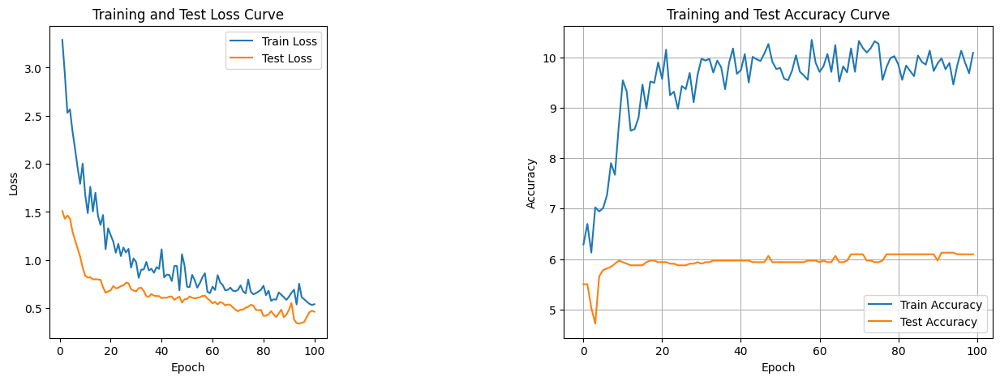

./saved_modelsmodel_22.pth
23


Training Process: 100%|██████████| 100/100 [00:02<00:00, 38.96it/s]


Total Epochs: 100
Train loss start: 2.639248847961426, Train loss end: 0.45003557205200195
Highest Train Accuracy: 13.53125
Test loss start: 1.2721420526504517, Test loss end: 0.5167402029037476
Highest Test Accuracy: 11.5625


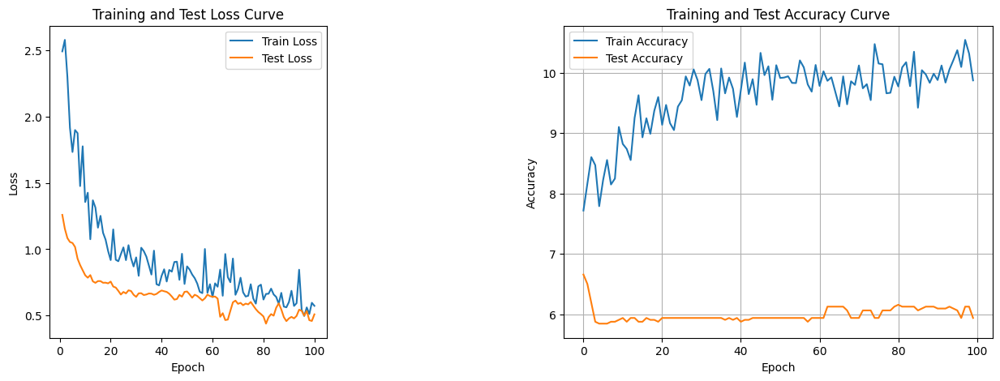

./saved_modelsmodel_23.pth
24


Training Process: 100%|██████████| 100/100 [00:02<00:00, 35.18it/s]


Total Epochs: 100
Train loss start: 2.6510889530181885, Train loss end: 0.31725409626960754
Highest Train Accuracy: 14.5625
Test loss start: 1.528847575187683, Test loss end: 0.6341260075569153
Highest Test Accuracy: 10.625


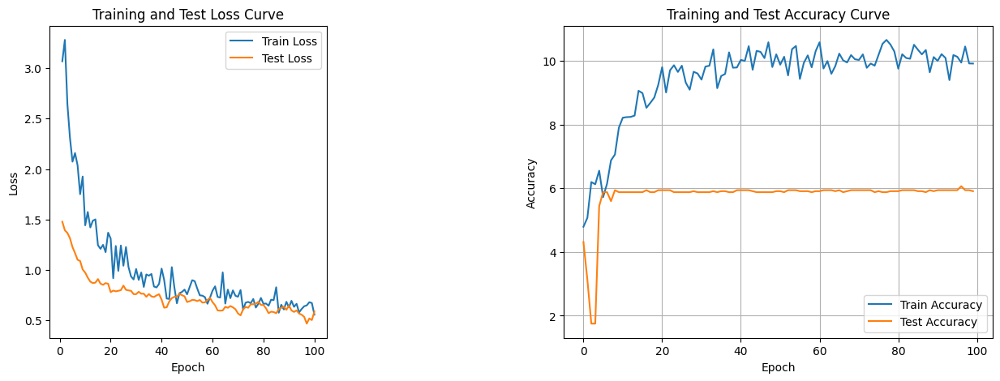

./saved_modelsmodel_24.pth
25


Training Process: 100%|██████████| 100/100 [00:02<00:00, 37.50it/s]


Total Epochs: 100
Train loss start: 3.388225555419922, Train loss end: 0.3836960792541504
Highest Train Accuracy: 14.0
Test loss start: 1.5281264781951904, Test loss end: 0.49069204926490784
Highest Test Accuracy: 10.625


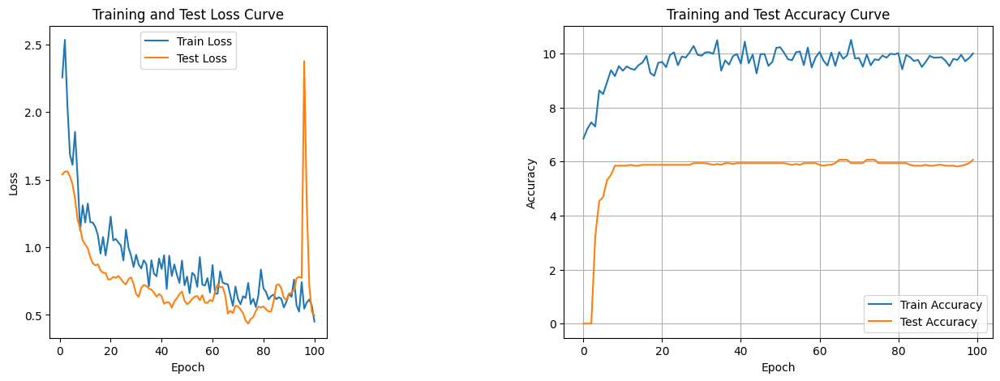

./saved_modelsmodel_25.pth
26


Training Process: 100%|██████████| 100/100 [00:02<00:00, 39.30it/s]


Total Epochs: 100
Train loss start: 2.1187829971313477, Train loss end: 0.19333186745643616
Highest Train Accuracy: 15.1875
Test loss start: 1.4629673957824707, Test loss end: 0.6710948944091797
Highest Test Accuracy: 12.0


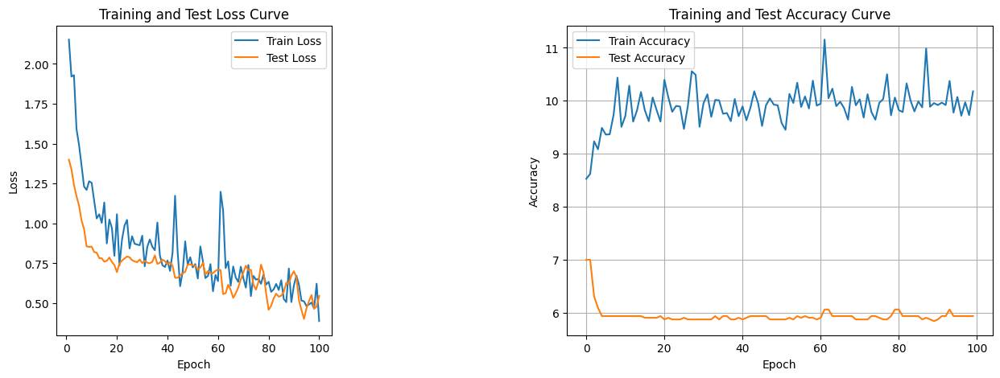

./saved_modelsmodel_26.pth
27


Training Process: 100%|██████████| 100/100 [00:03<00:00, 32.74it/s]


Total Epochs: 100
Train loss start: 2.5642380714416504, Train loss end: 0.40414032340049744
Highest Train Accuracy: 14.5625
Test loss start: 1.3657286167144775, Test loss end: 0.5369784235954285
Highest Test Accuracy: 12.0


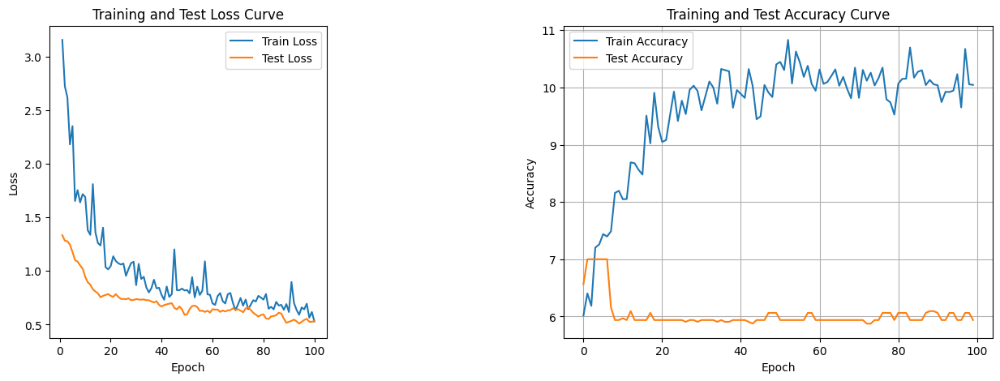

./saved_modelsmodel_27.pth
28


Training Process: 100%|██████████| 100/100 [00:02<00:00, 33.36it/s]


Total Epochs: 100
Train loss start: 3.20797061920166, Train loss end: 1.6920478343963623
Highest Train Accuracy: 14.34375
Test loss start: 1.3463562726974487, Test loss end: 0.575046956539154
Highest Test Accuracy: 12.0


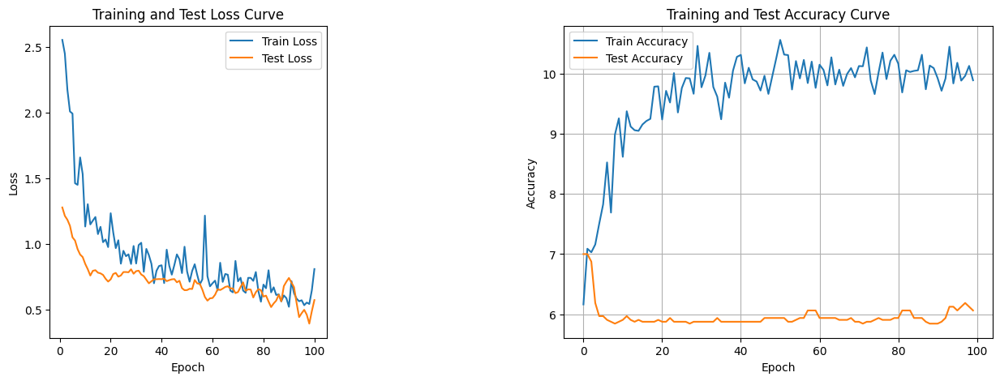

./saved_modelsmodel_28.pth
29


Training Process: 100%|██████████| 100/100 [00:02<00:00, 39.19it/s]


Total Epochs: 100
Train loss start: 1.869483232498169, Train loss end: 0.6798068284988403
Highest Train Accuracy: 15.53125
Test loss start: 1.2817002534866333, Test loss end: 1.1281284093856812
Highest Test Accuracy: 10.75


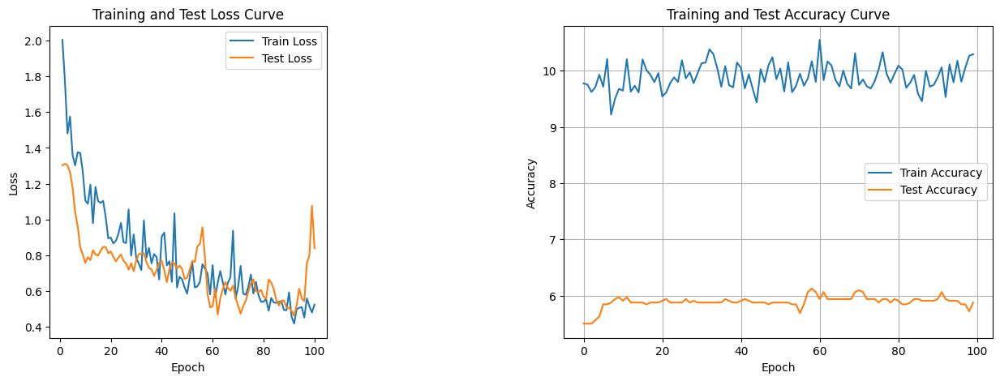

./saved_modelsmodel_29.pth
30


Training Process: 100%|██████████| 100/100 [00:02<00:00, 35.03it/s]


Total Epochs: 100
Train loss start: 3.335935592651367, Train loss end: 0.5132372975349426
Highest Train Accuracy: 14.46875
Test loss start: 1.6599012613296509, Test loss end: 0.49827393889427185
Highest Test Accuracy: 10.6875


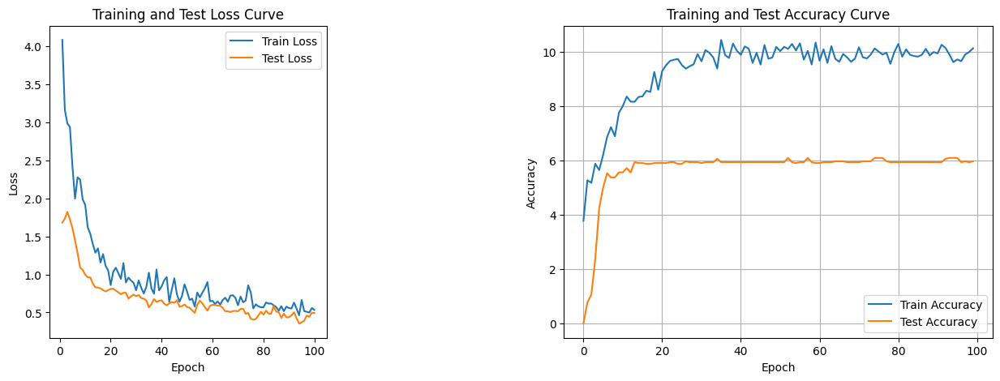

./saved_modelsmodel_30.pth
31


Training Process: 100%|██████████| 100/100 [00:02<00:00, 37.57it/s]


Total Epochs: 100
Train loss start: 3.369150161743164, Train loss end: 0.45145052671432495
Highest Train Accuracy: 14.28125
Test loss start: 1.4055436849594116, Test loss end: 0.40666401386260986
Highest Test Accuracy: 10.75


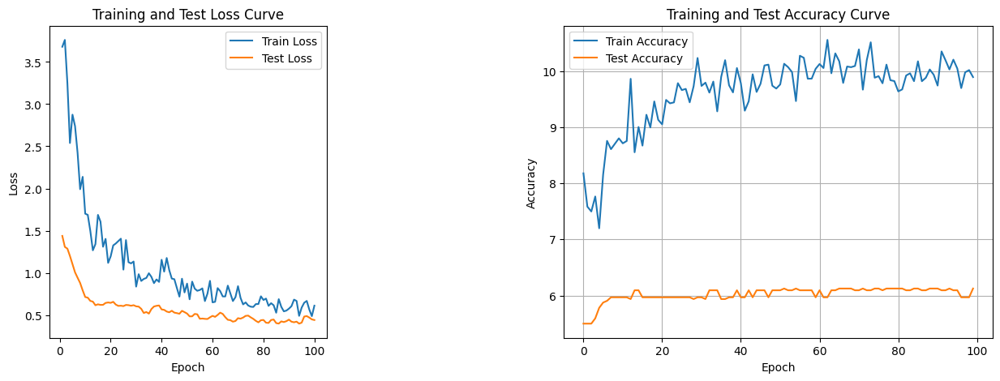

./saved_modelsmodel_31.pth
32


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.58it/s]


Total Epochs: 100
Train loss start: 2.680372714996338, Train loss end: 0.6671014428138733
Highest Train Accuracy: 14.25
Test loss start: 1.4778025150299072, Test loss end: 0.48837870359420776
Highest Test Accuracy: 10.625


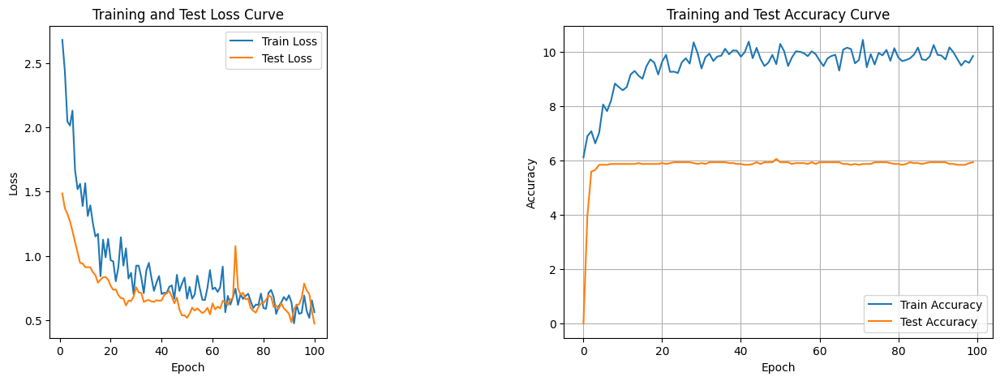

./saved_modelsmodel_32.pth
33


Training Process: 100%|██████████| 100/100 [00:02<00:00, 35.18it/s]


Total Epochs: 100
Train loss start: 4.469956874847412, Train loss end: 0.38818222284317017
Highest Train Accuracy: 14.9375
Test loss start: 1.3328255414962769, Test loss end: 0.5832027196884155
Highest Test Accuracy: 10.6875


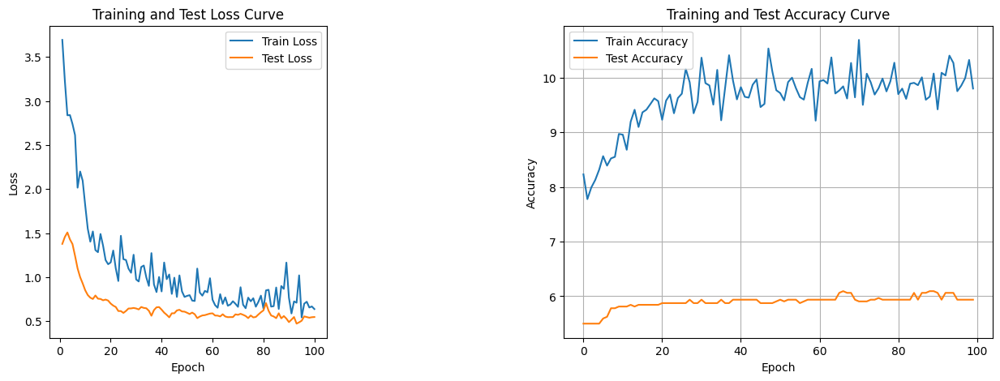

./saved_modelsmodel_33.pth
34


Training Process: 100%|██████████| 100/100 [00:02<00:00, 38.21it/s]


Total Epochs: 100
Train loss start: 5.340447902679443, Train loss end: 0.4550664722919464
Highest Train Accuracy: 14.84375
Test loss start: 1.5805195569992065, Test loss end: 0.49352002143859863
Highest Test Accuracy: 10.6875


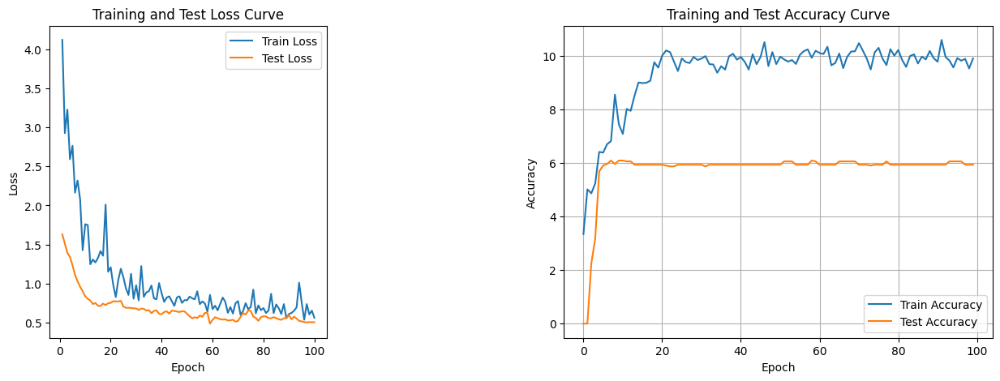

./saved_modelsmodel_34.pth
35


Training Process: 100%|██████████| 100/100 [00:02<00:00, 35.71it/s]


Total Epochs: 100
Train loss start: 3.7284820079803467, Train loss end: 0.5089179277420044
Highest Train Accuracy: 13.875
Test loss start: 1.3526138067245483, Test loss end: 0.3871747851371765
Highest Test Accuracy: 10.75


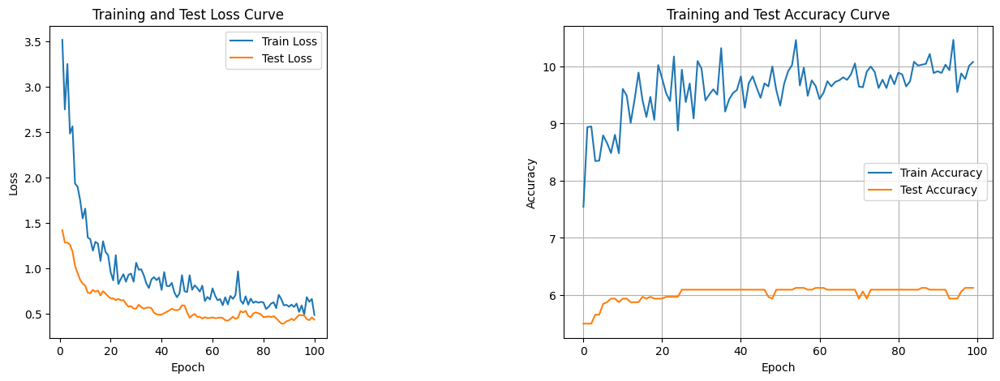

./saved_modelsmodel_35.pth
36


Training Process: 100%|██████████| 100/100 [00:02<00:00, 37.03it/s]


Total Epochs: 100
Train loss start: 2.777916193008423, Train loss end: 0.7753368020057678
Highest Train Accuracy: 13.6875
Test loss start: 1.2733299732208252, Test loss end: 0.6245949864387512
Highest Test Accuracy: 12.0


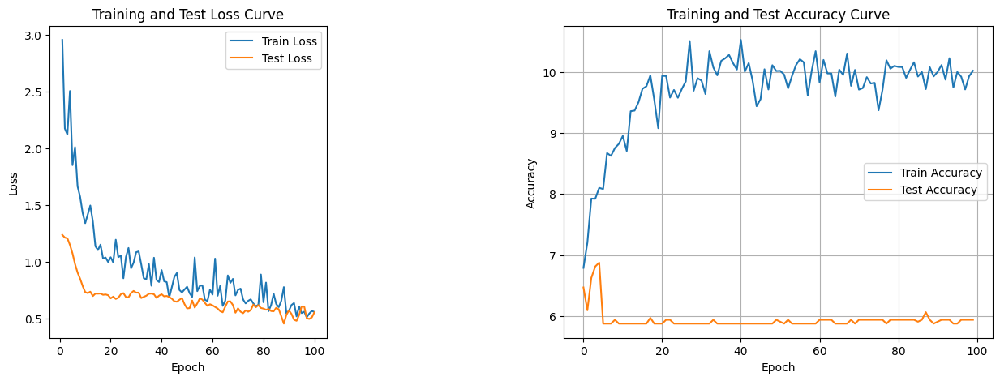

./saved_modelsmodel_36.pth
37


Training Process: 100%|██████████| 100/100 [00:02<00:00, 38.96it/s]


Total Epochs: 100
Train loss start: 3.065406322479248, Train loss end: 0.6859269738197327
Highest Train Accuracy: 15.25
Test loss start: 1.5507841110229492, Test loss end: 0.44807904958724976
Highest Test Accuracy: 12.0


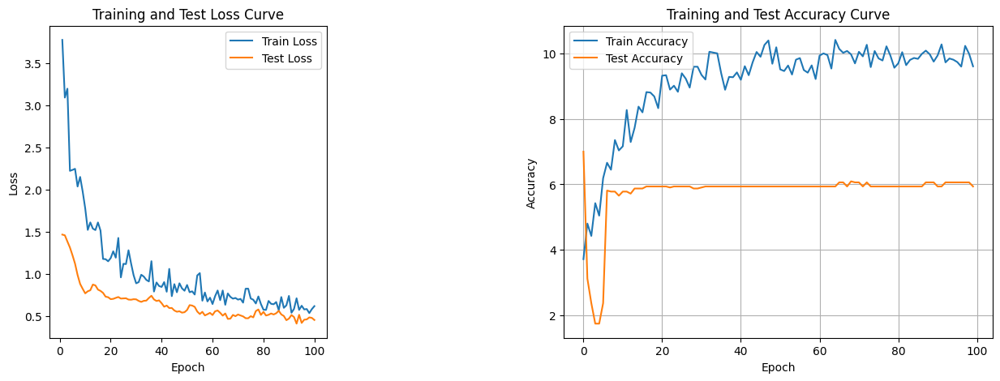

./saved_modelsmodel_37.pth
38


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.28it/s]


Total Epochs: 100
Train loss start: 4.159960746765137, Train loss end: 1.0485374927520752
Highest Train Accuracy: 14.125
Test loss start: 1.2799237966537476, Test loss end: 0.6074995398521423
Highest Test Accuracy: 10.625


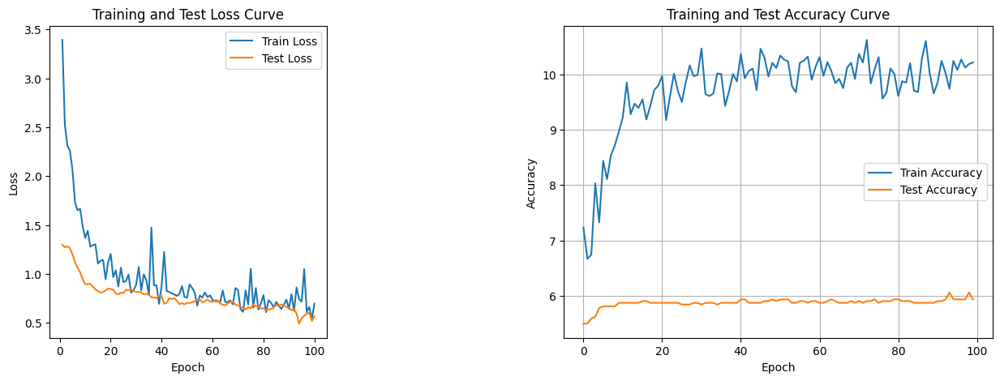

./saved_modelsmodel_38.pth
39


Training Process: 100%|██████████| 100/100 [00:02<00:00, 34.38it/s]


Total Epochs: 100
Train loss start: 3.6216044425964355, Train loss end: 0.41530194878578186
Highest Train Accuracy: 13.53125
Test loss start: 1.3722784519195557, Test loss end: 0.4418577253818512
Highest Test Accuracy: 10.75


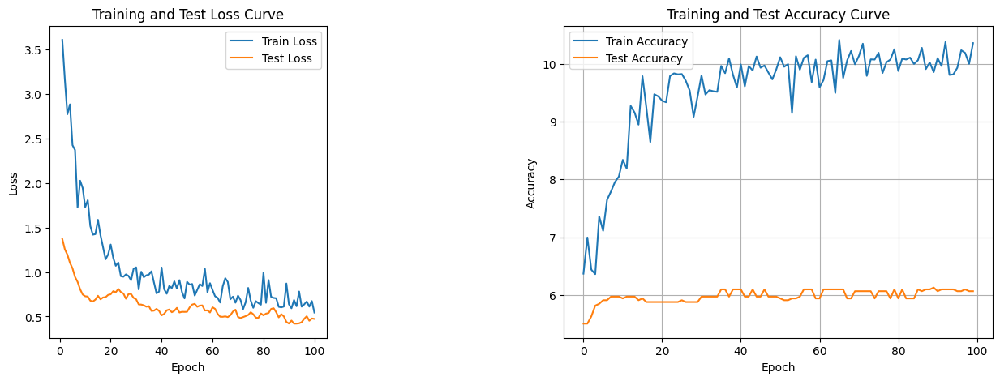

./saved_modelsmodel_39.pth
40


Training Process: 100%|██████████| 100/100 [00:02<00:00, 39.21it/s]


Total Epochs: 100
Train loss start: 3.055229663848877, Train loss end: 0.8243538737297058
Highest Train Accuracy: 13.21875
Test loss start: 1.467132329940796, Test loss end: 0.4497464597225189
Highest Test Accuracy: 10.75


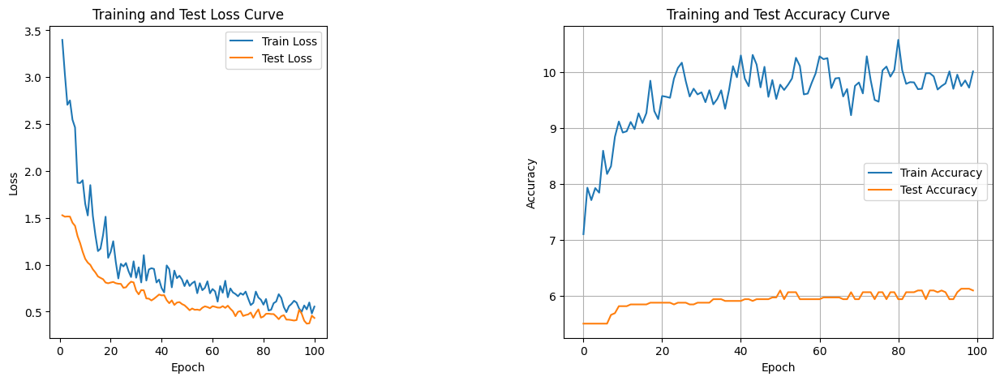

./saved_modelsmodel_40.pth
41


Training Process: 100%|██████████| 100/100 [00:02<00:00, 37.03it/s]


Total Epochs: 100
Train loss start: 3.016310214996338, Train loss end: 0.4831986427307129
Highest Train Accuracy: 13.53125
Test loss start: 1.7415215969085693, Test loss end: 0.6226723194122314
Highest Test Accuracy: 10.6875


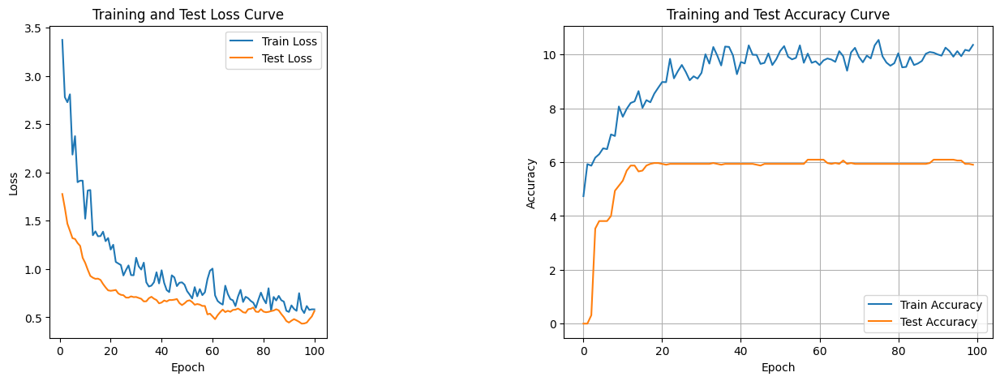

./saved_modelsmodel_41.pth
42


Training Process: 100%|██████████| 100/100 [00:02<00:00, 35.66it/s]


Total Epochs: 100
Train loss start: 3.5373973846435547, Train loss end: 0.5826903581619263
Highest Train Accuracy: 14.0625
Test loss start: 1.6660490036010742, Test loss end: 0.6101029515266418
Highest Test Accuracy: 12.0


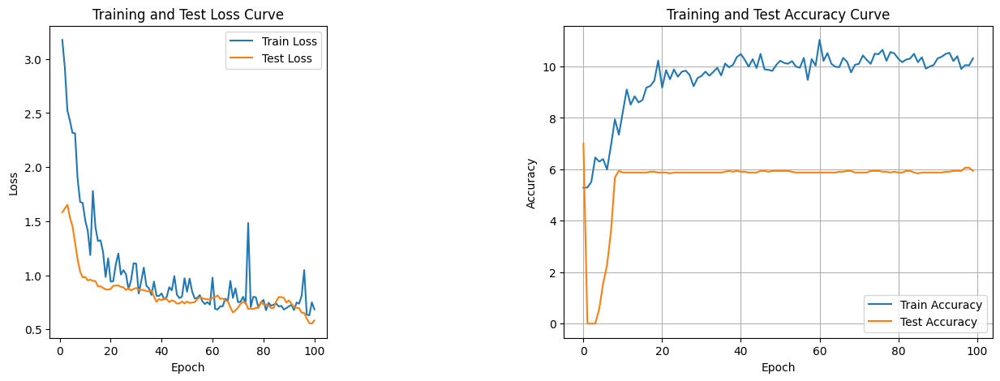

./saved_modelsmodel_42.pth
43


Training Process: 100%|██████████| 100/100 [00:02<00:00, 35.93it/s]


Total Epochs: 100
Train loss start: 3.977922201156616, Train loss end: 0.8240558505058289
Highest Train Accuracy: 13.84375
Test loss start: 1.7003473043441772, Test loss end: 0.46706297993659973
Highest Test Accuracy: 10.75


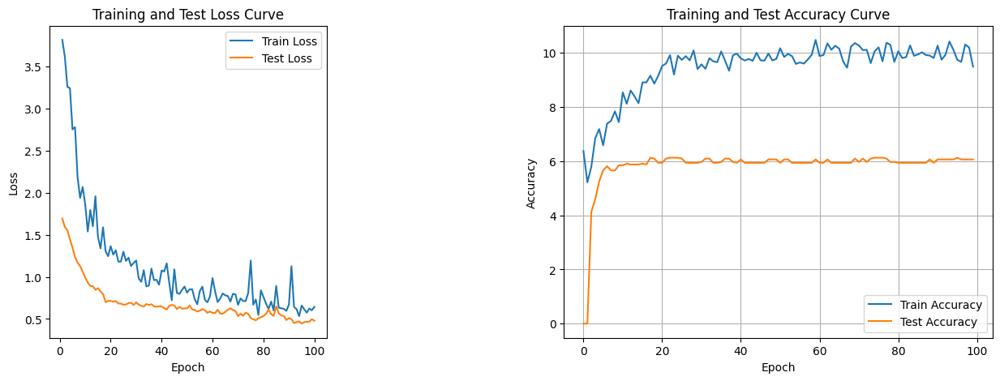

./saved_modelsmodel_43.pth
44


Training Process: 100%|██████████| 100/100 [00:02<00:00, 37.27it/s]


Total Epochs: 100
Train loss start: 3.2494308948516846, Train loss end: 0.40066903829574585
Highest Train Accuracy: 13.8125
Test loss start: 1.4211820363998413, Test loss end: 0.3420577049255371
Highest Test Accuracy: 10.6875


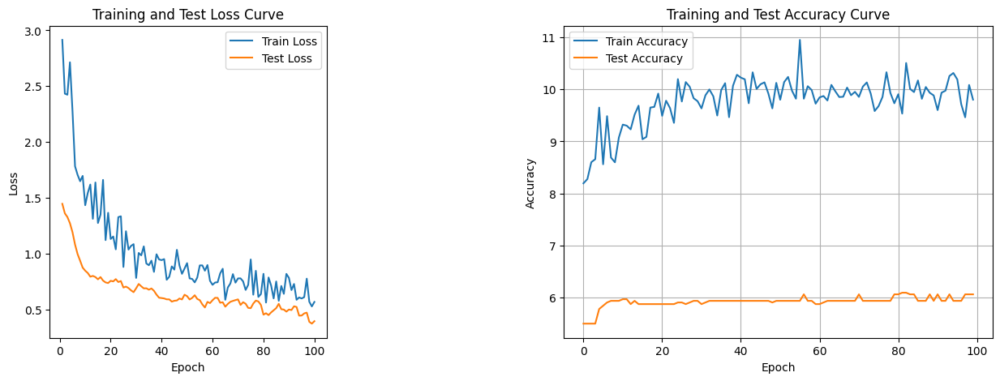

./saved_modelsmodel_44.pth
45


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.14it/s]


Total Epochs: 100
Train loss start: 2.2087583541870117, Train loss end: 0.6380966305732727
Highest Train Accuracy: 13.71875
Test loss start: 1.4315756559371948, Test loss end: 0.8042793273925781
Highest Test Accuracy: 10.75


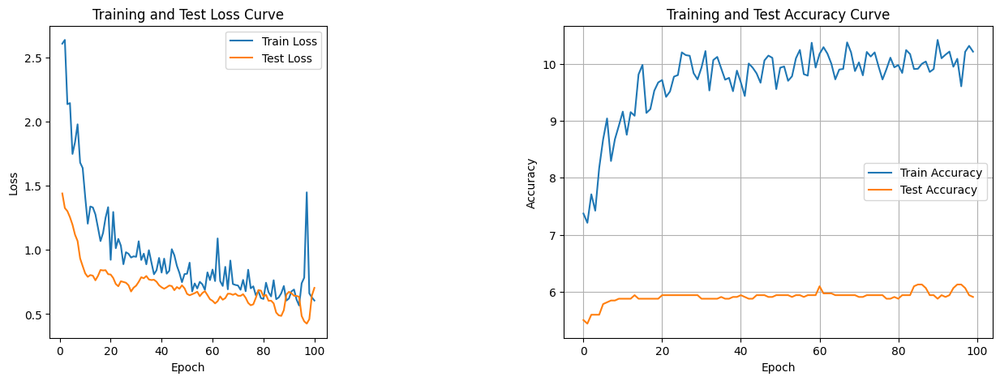

./saved_modelsmodel_45.pth
46


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.73it/s]


Total Epochs: 100
Train loss start: 1.9632644653320312, Train loss end: 0.363209992647171
Highest Train Accuracy: 14.96875
Test loss start: 1.385246992111206, Test loss end: 0.5713827013969421
Highest Test Accuracy: 12.0


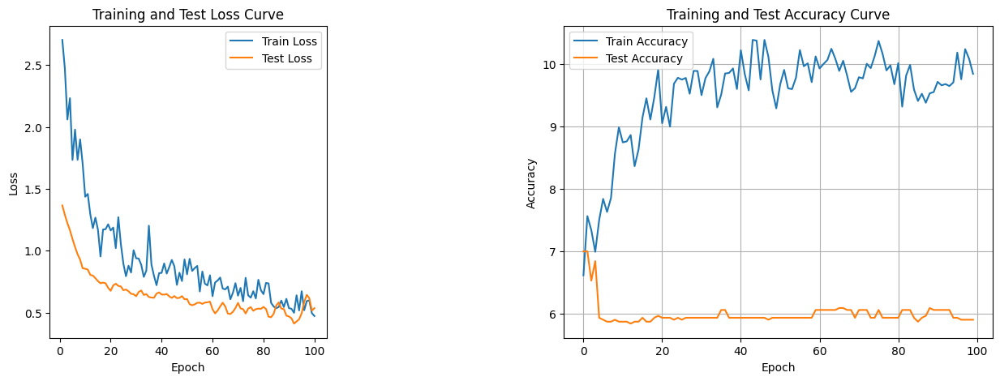

./saved_modelsmodel_46.pth
47


Training Process: 100%|██████████| 100/100 [00:02<00:00, 35.71it/s]


Total Epochs: 100
Train loss start: 2.901282787322998, Train loss end: 0.47792938351631165
Highest Train Accuracy: 15.3125
Test loss start: 1.1987519264221191, Test loss end: 0.5890925526618958
Highest Test Accuracy: 10.625


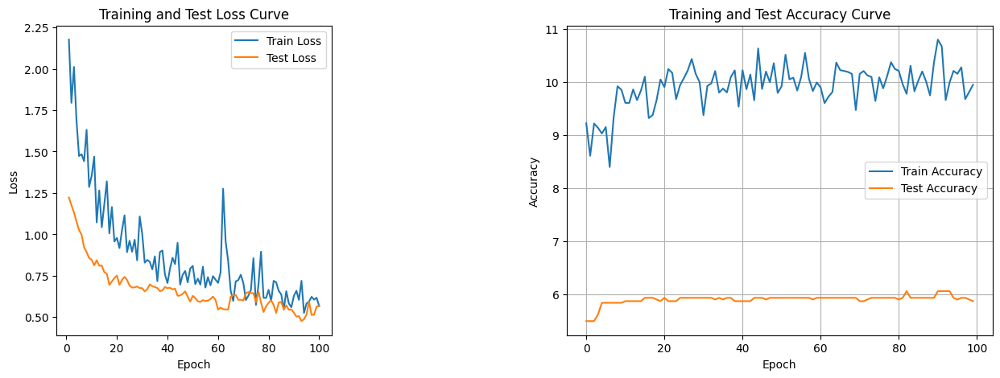

./saved_modelsmodel_47.pth
48


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.44it/s]


Total Epochs: 100
Train loss start: 3.260774612426758, Train loss end: 0.6367926597595215
Highest Train Accuracy: 13.875
Test loss start: 1.5195361375808716, Test loss end: 0.6552035808563232
Highest Test Accuracy: 12.0


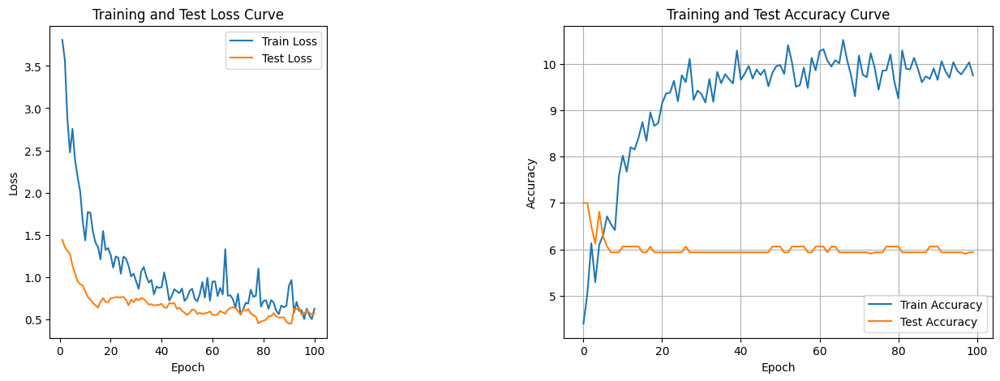

./saved_modelsmodel_48.pth
49


Training Process: 100%|██████████| 100/100 [00:02<00:00, 34.48it/s]


Total Epochs: 100
Train loss start: 2.3360178470611572, Train loss end: 0.1457267850637436
Highest Train Accuracy: 15.53125
Test loss start: 1.4416379928588867, Test loss end: 0.39515984058380127
Highest Test Accuracy: 10.75


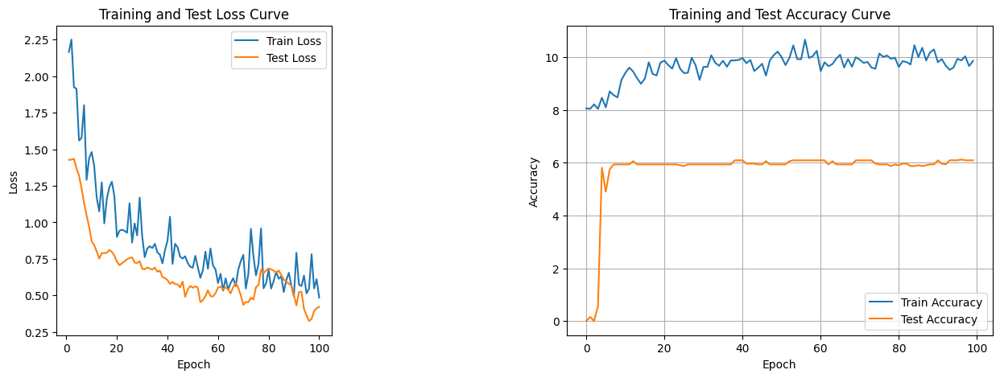

./saved_modelsmodel_49.pth
50


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.60it/s]


Total Epochs: 100
Train loss start: 2.8734302520751953, Train loss end: 2.3620457649230957
Highest Train Accuracy: 13.34375
Test loss start: 1.4801535606384277, Test loss end: 0.5150048732757568
Highest Test Accuracy: 10.6875


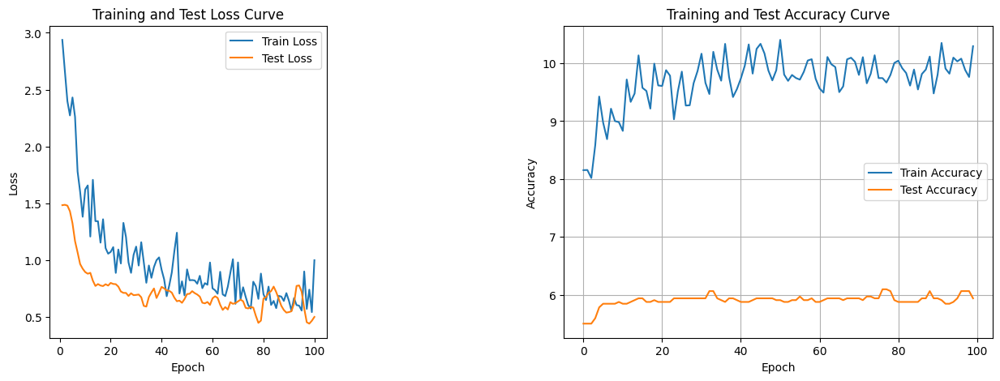

./saved_modelsmodel_50.pth
51


Training Process: 100%|██████████| 100/100 [00:02<00:00, 35.30it/s]


Total Epochs: 100
Train loss start: 2.5656673908233643, Train loss end: 0.8173860907554626
Highest Train Accuracy: 15.625
Test loss start: 1.3477587699890137, Test loss end: 0.44008785486221313
Highest Test Accuracy: 10.75


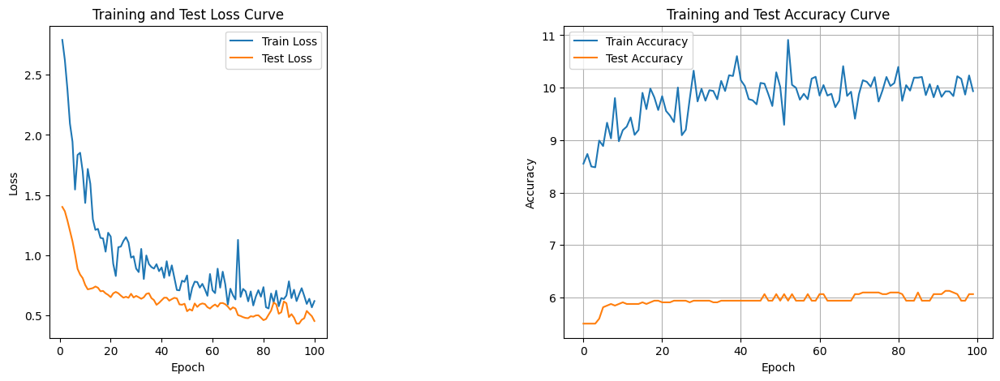

./saved_modelsmodel_51.pth
52


Training Process: 100%|██████████| 100/100 [00:02<00:00, 34.23it/s]


Total Epochs: 100
Train loss start: 2.998267412185669, Train loss end: 0.3341381549835205
Highest Train Accuracy: 14.375
Test loss start: 1.7391170263290405, Test loss end: 0.4705173671245575
Highest Test Accuracy: 10.6875


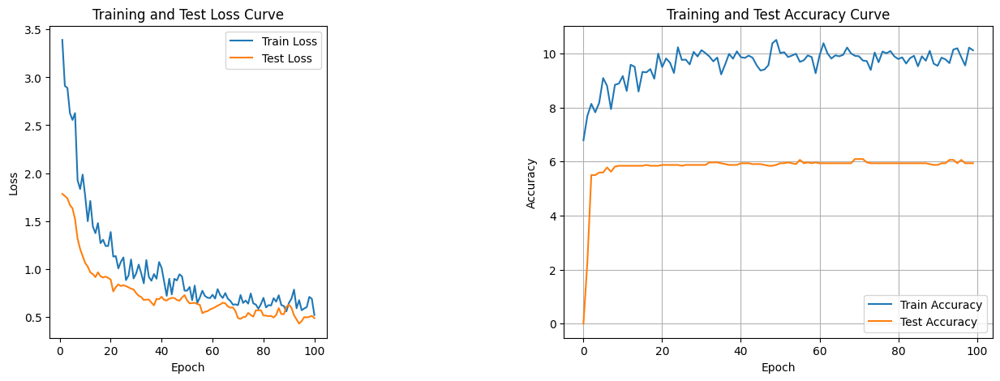

./saved_modelsmodel_52.pth
53


Training Process: 100%|██████████| 100/100 [00:02<00:00, 37.73it/s]


Total Epochs: 100
Train loss start: 3.3587446212768555, Train loss end: 0.2589780390262604
Highest Train Accuracy: 14.375
Test loss start: 1.2376246452331543, Test loss end: 0.4616152048110962
Highest Test Accuracy: 10.8125


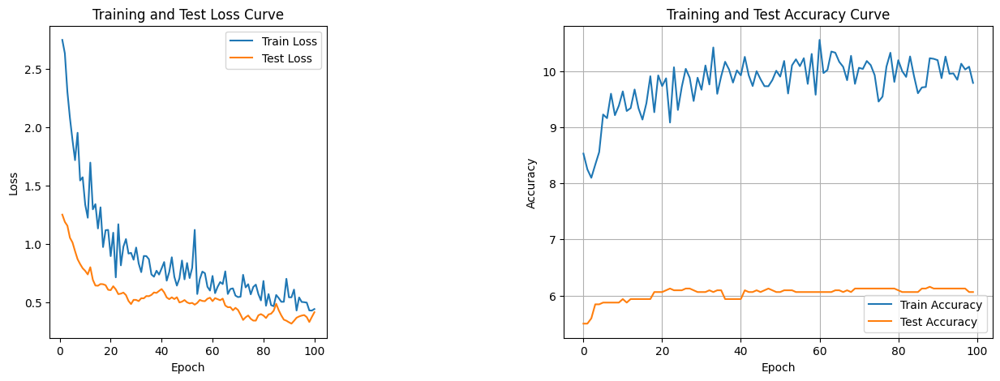

./saved_modelsmodel_53.pth
54


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.43it/s]


Total Epochs: 100
Train loss start: 3.5804948806762695, Train loss end: 0.6508764624595642
Highest Train Accuracy: 16.15625
Test loss start: 1.4895633459091187, Test loss end: 0.6307688355445862
Highest Test Accuracy: 10.6875


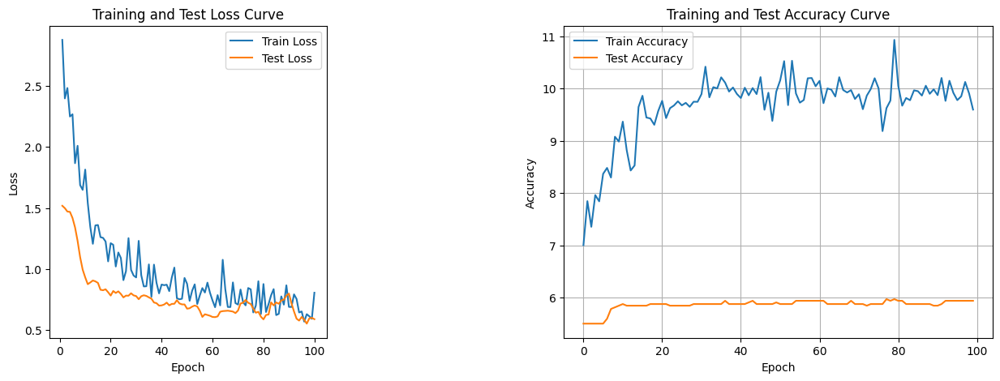

./saved_modelsmodel_54.pth
55


Training Process: 100%|██████████| 100/100 [00:03<00:00, 32.43it/s]


Total Epochs: 100
Train loss start: 3.4978652000427246, Train loss end: 1.235309362411499
Highest Train Accuracy: 16.40625
Test loss start: 1.5821610689163208, Test loss end: 0.6098073720932007
Highest Test Accuracy: 12.0


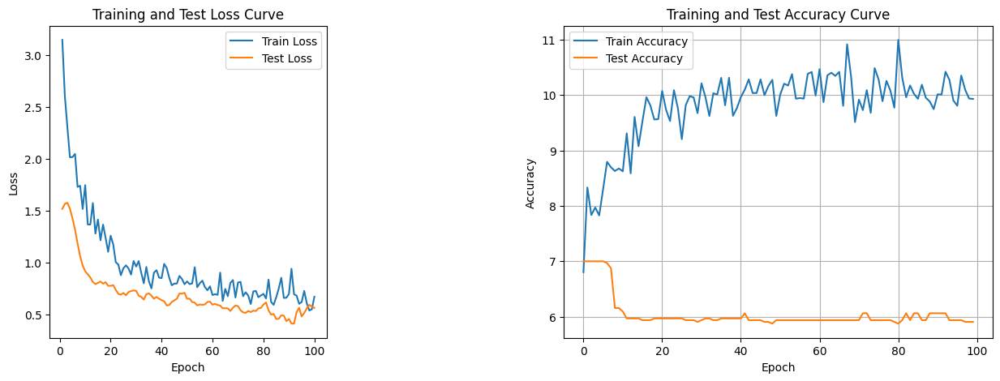

./saved_modelsmodel_55.pth
56


Training Process: 100%|██████████| 100/100 [00:03<00:00, 33.17it/s]


Total Epochs: 100
Train loss start: 3.0697073936462402, Train loss end: 0.9346887469291687
Highest Train Accuracy: 15.625
Test loss start: 1.4031150341033936, Test loss end: 0.27889546751976013
Highest Test Accuracy: 10.75


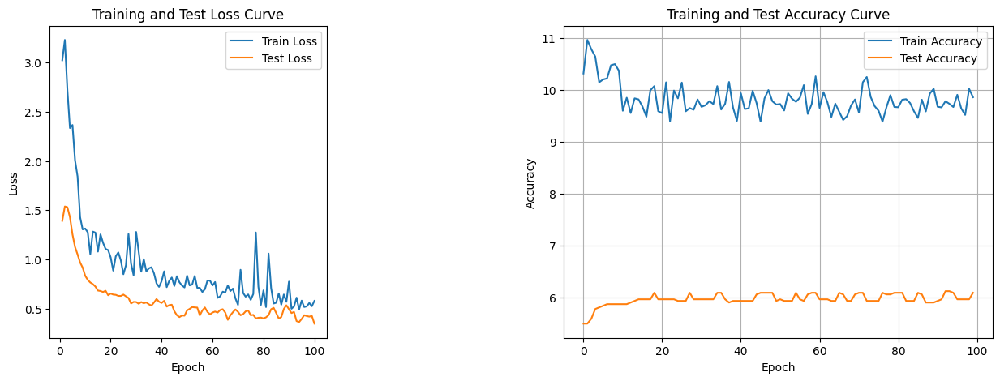

./saved_modelsmodel_56.pth
57


Training Process: 100%|██████████| 100/100 [00:02<00:00, 35.93it/s]


Total Epochs: 100
Train loss start: 3.704946756362915, Train loss end: 0.53183913230896
Highest Train Accuracy: 13.5625
Test loss start: 1.580263614654541, Test loss end: 0.6791927814483643
Highest Test Accuracy: 10.875


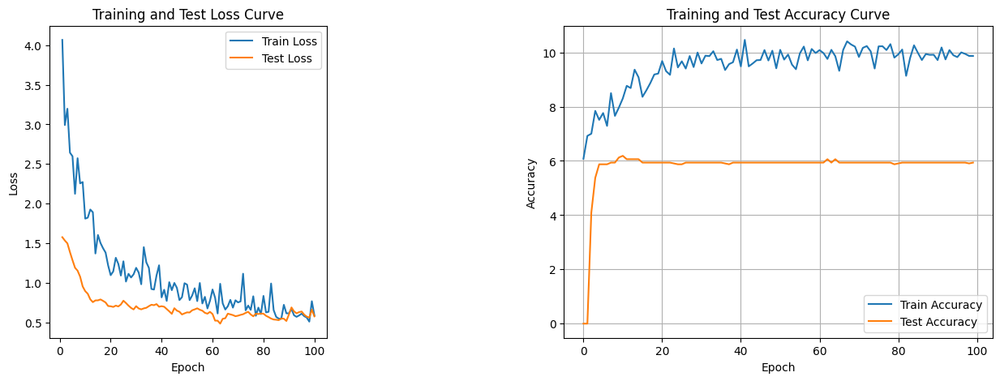

./saved_modelsmodel_57.pth
58


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.36it/s]


Total Epochs: 100
Train loss start: 3.062950372695923, Train loss end: 0.7429729700088501
Highest Train Accuracy: 14.625
Test loss start: 1.5115766525268555, Test loss end: 0.5249890089035034
Highest Test Accuracy: 10.625


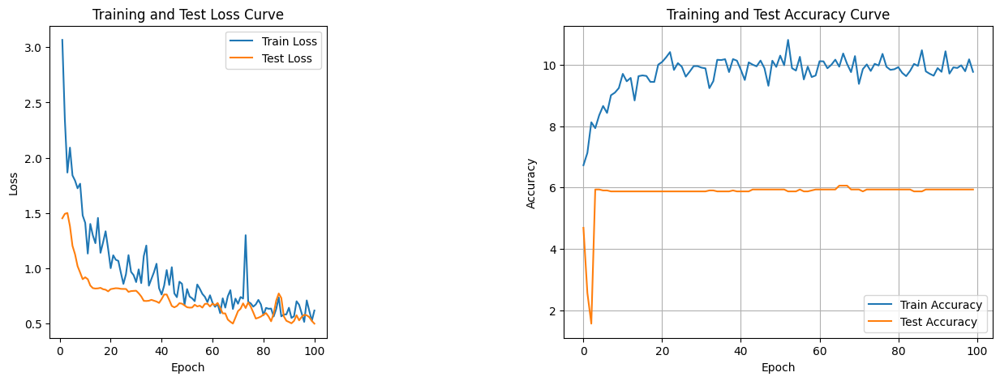

./saved_modelsmodel_58.pth
59


Training Process: 100%|██████████| 100/100 [00:02<00:00, 33.91it/s]


Total Epochs: 100
Train loss start: 2.73432993888855, Train loss end: 0.2418597936630249
Highest Train Accuracy: 15.4375
Test loss start: 1.499720573425293, Test loss end: 0.25252509117126465
Highest Test Accuracy: 10.875


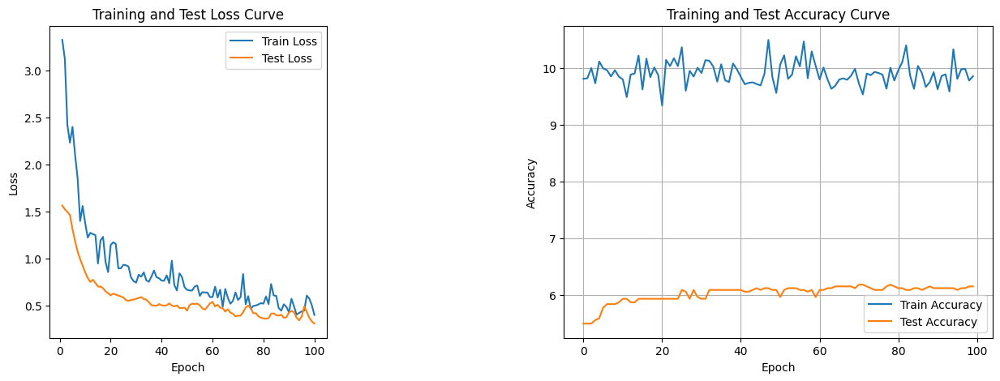

./saved_modelsmodel_59.pth
60


Training Process: 100%|██████████| 100/100 [00:02<00:00, 33.70it/s]


Total Epochs: 100
Train loss start: 2.514409303665161, Train loss end: 0.3797449767589569
Highest Train Accuracy: 14.25
Test loss start: 1.3323695659637451, Test loss end: 0.6793529987335205
Highest Test Accuracy: 11.8125


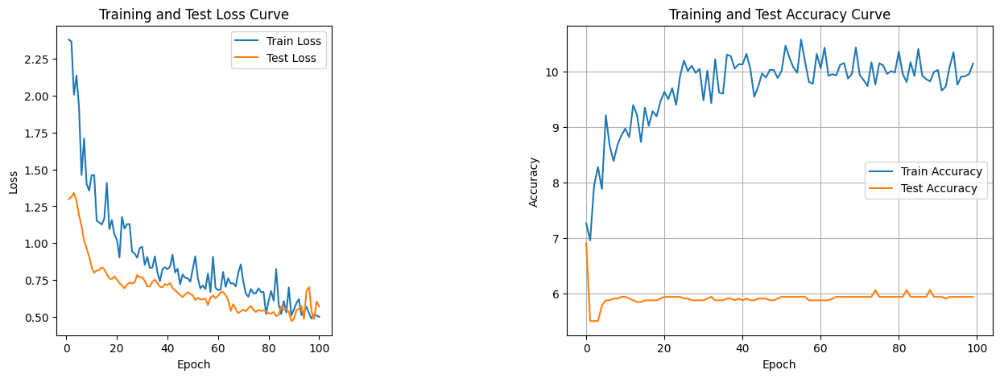

./saved_modelsmodel_60.pth
61


Training Process: 100%|██████████| 100/100 [00:02<00:00, 35.93it/s]


Total Epochs: 100
Train loss start: 3.128150701522827, Train loss end: 0.33098074793815613
Highest Train Accuracy: 14.3125
Test loss start: 1.2770106792449951, Test loss end: 0.30529510974884033
Highest Test Accuracy: 12.0


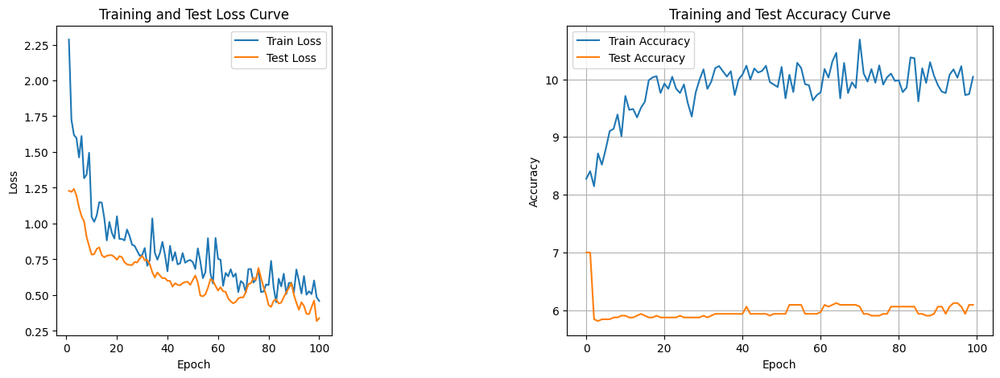

./saved_modelsmodel_61.pth
62


Training Process: 100%|██████████| 100/100 [00:02<00:00, 35.40it/s]


Total Epochs: 100
Train loss start: 3.8296399116516113, Train loss end: 0.6080549359321594
Highest Train Accuracy: 15.21875
Test loss start: 1.26229727268219, Test loss end: 0.6725371479988098
Highest Test Accuracy: 10.625


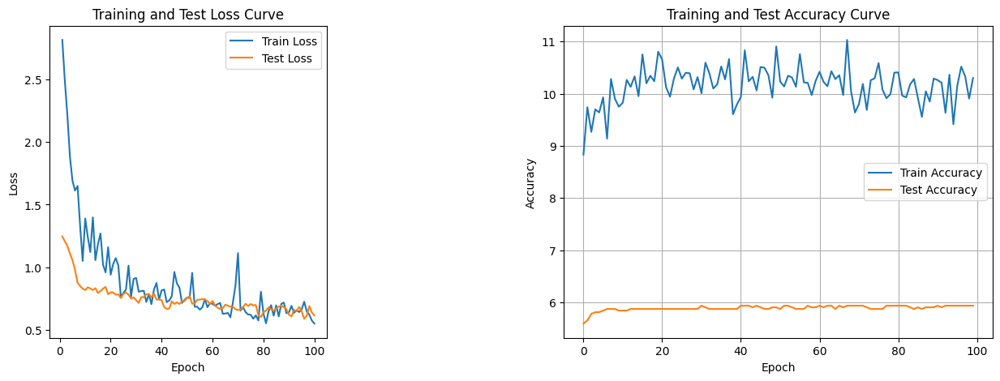

./saved_modelsmodel_62.pth
63


Training Process: 100%|██████████| 100/100 [00:02<00:00, 34.25it/s]


Total Epochs: 100
Train loss start: 2.9494781494140625, Train loss end: 1.4995906352996826
Highest Train Accuracy: 14.40625
Test loss start: 1.297025203704834, Test loss end: 0.6010963916778564
Highest Test Accuracy: 12.0


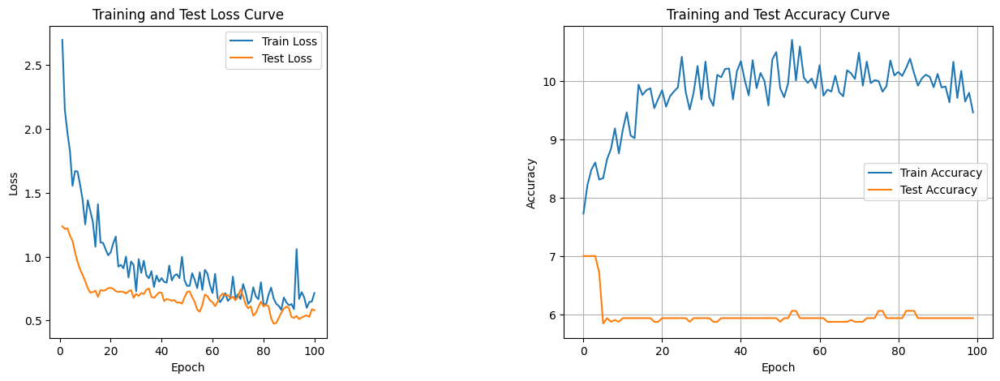

./saved_modelsmodel_63.pth
64


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.57it/s]


Total Epochs: 100
Train loss start: 2.799151659011841, Train loss end: 0.34855732321739197
Highest Train Accuracy: 14.34375
Test loss start: 1.4697426557540894, Test loss end: 0.4556020200252533
Highest Test Accuracy: 12.0


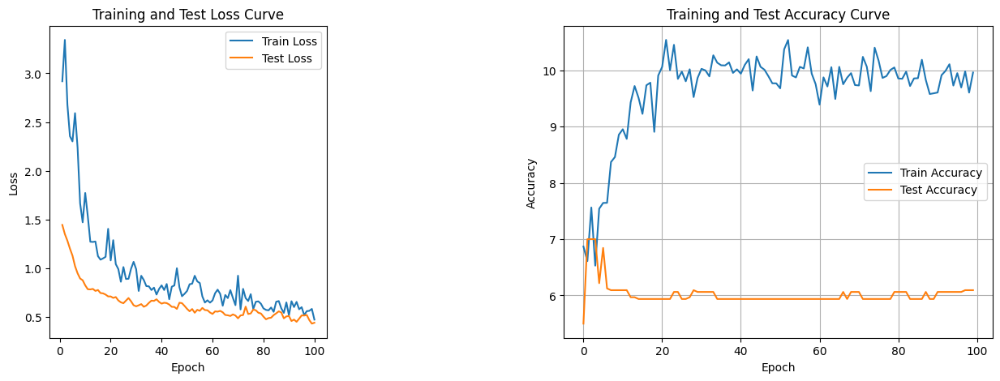

./saved_modelsmodel_64.pth
71


Training Process: 100%|██████████| 100/100 [00:02<00:00, 39.50it/s]


Total Epochs: 100
Train loss start: 0.5324389934539795, Train loss end: 0.08080480992794037
Highest Train Accuracy: 14.1875
Test loss start: 0.48548129200935364, Test loss end: 0.30709344148635864
Highest Test Accuracy: 10.8125


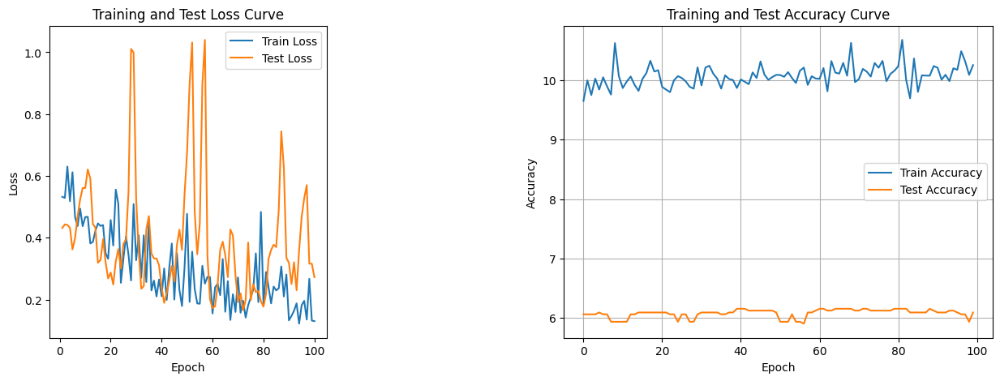

./saved_modelsmodel_71.pth
72


Training Process: 100%|██████████| 100/100 [00:02<00:00, 35.45it/s]


Total Epochs: 100
Train loss start: 0.3776789605617523, Train loss end: 1.0544521808624268
Highest Train Accuracy: 13.96875
Test loss start: 0.549470067024231, Test loss end: 1.325282335281372
Highest Test Accuracy: 11.0625


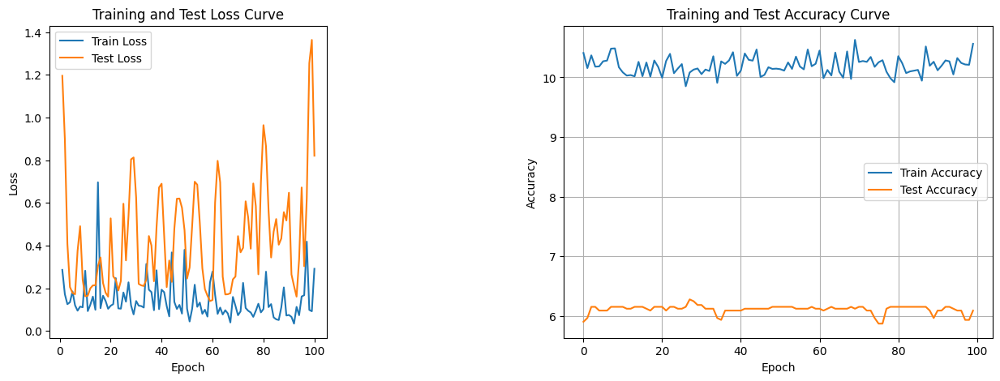

./saved_modelsmodel_72.pth
70


Training Process: 100%|██████████| 100/100 [00:02<00:00, 35.14it/s]


Total Epochs: 100
Train loss start: 0.15483364462852478, Train loss end: 0.00907067023217678
Highest Train Accuracy: 14.8125
Test loss start: 0.3788096308708191, Test loss end: 1.464730978012085
Highest Test Accuracy: 10.875


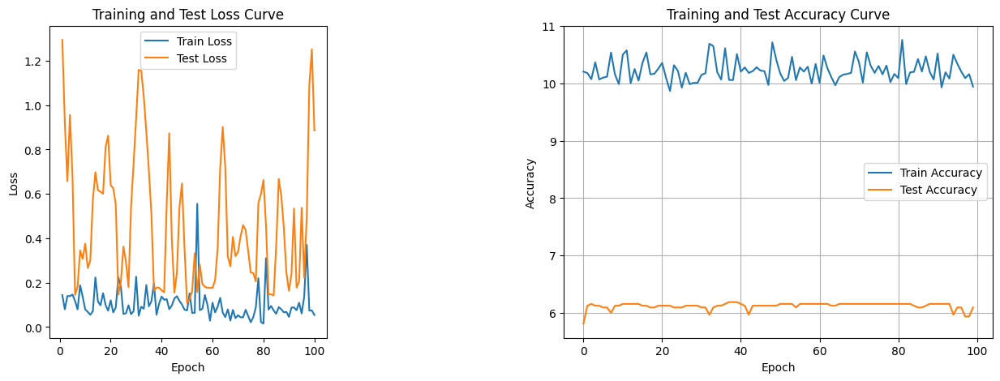

./saved_modelsmodel_70.pth
72


Training Process: 100%|██████████| 100/100 [00:02<00:00, 33.98it/s]


Total Epochs: 100
Train loss start: 0.016504965722560883, Train loss end: 0.013860635459423065
Highest Train Accuracy: 14.8125
Test loss start: 0.2899910807609558, Test loss end: 1.5119162797927856
Highest Test Accuracy: 10.8125


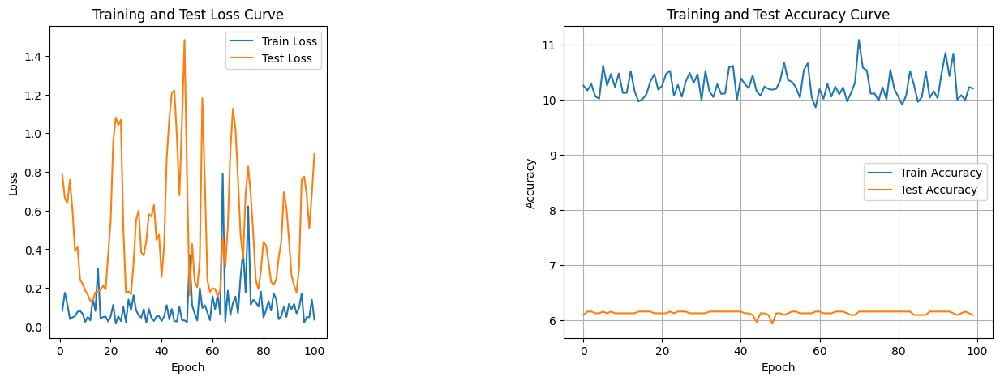

./saved_modelsmodel_72.pth
73


Training Process: 100%|██████████| 100/100 [00:03<00:00, 33.10it/s]


Total Epochs: 100
Train loss start: 0.1429985761642456, Train loss end: 0.0074571226723492146
Highest Train Accuracy: 14.75
Test loss start: 0.17731128633022308, Test loss end: 1.520854115486145
Highest Test Accuracy: 10.8125


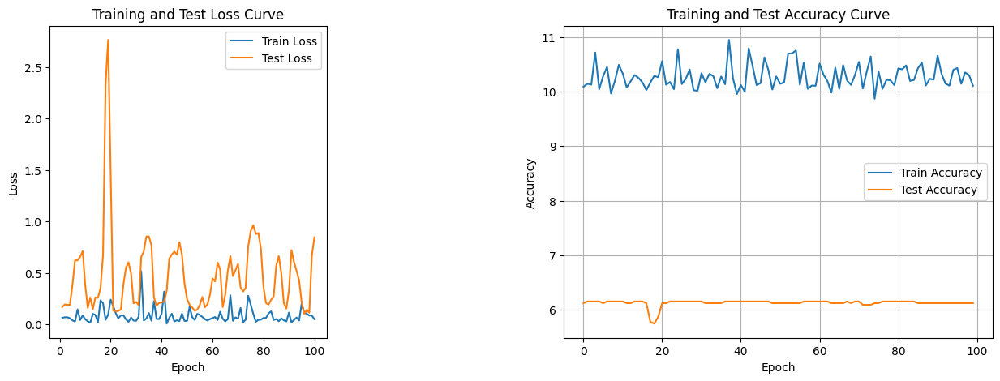

./saved_modelsmodel_73.pth
71


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.47it/s]


Total Epochs: 100
Train loss start: 0.01439668983221054, Train loss end: 0.29122355580329895
Highest Train Accuracy: 14.75
Test loss start: 0.19882628321647644, Test loss end: 1.4329254627227783
Highest Test Accuracy: 10.875


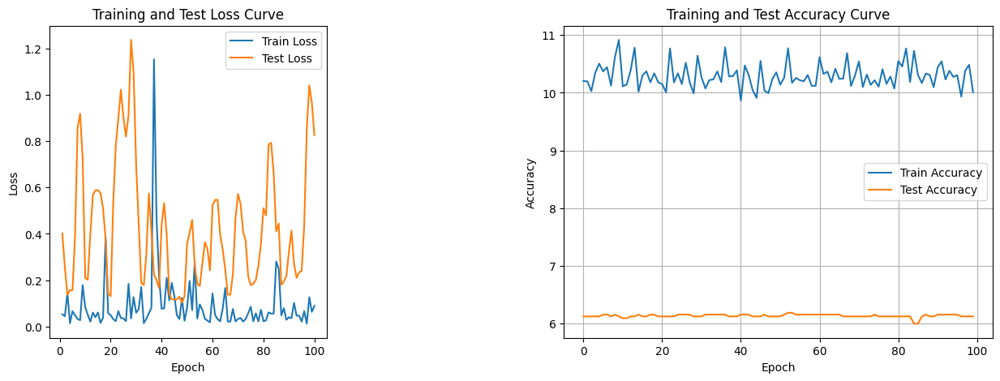

./saved_modelsmodel_71.pth
69


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.79it/s]


Total Epochs: 100
Train loss start: 0.19919444620609283, Train loss end: 0.01655135117471218
Highest Train Accuracy: 14.34375
Test loss start: 0.31299224495887756, Test loss end: 0.021932965144515038
Highest Test Accuracy: 10.8125


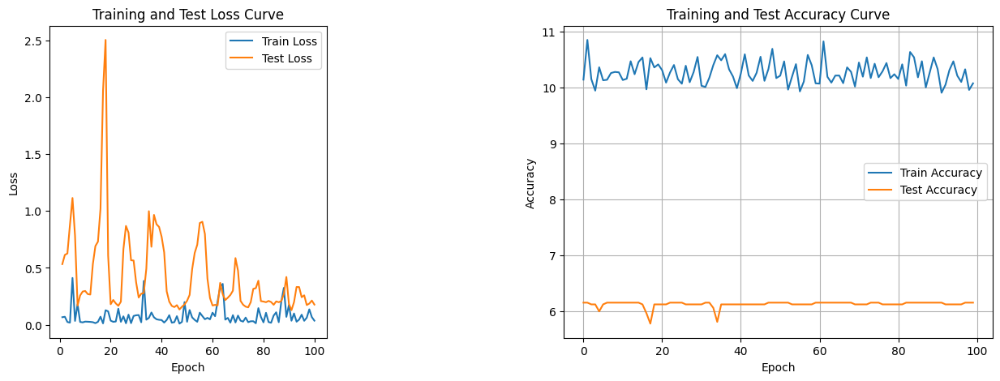

./saved_modelsmodel_69.pth
72


Training Process: 100%|██████████| 100/100 [00:02<00:00, 34.48it/s]


Total Epochs: 100
Train loss start: 0.018833065405488014, Train loss end: 0.10936114937067032
Highest Train Accuracy: 15.6875
Test loss start: 0.2240978479385376, Test loss end: 1.7316889762878418
Highest Test Accuracy: 10.875


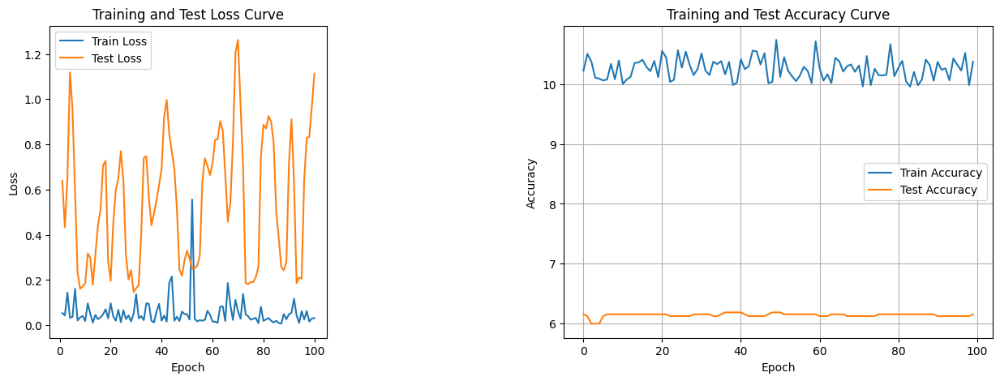

./saved_modelsmodel_72.pth
73


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.08it/s]


Total Epochs: 100
Train loss start: 0.0008170241490006447, Train loss end: 0.23907028138637543
Highest Train Accuracy: 14.8125
Test loss start: 0.4723086357116699, Test loss end: 0.07337061315774918
Highest Test Accuracy: 10.8125


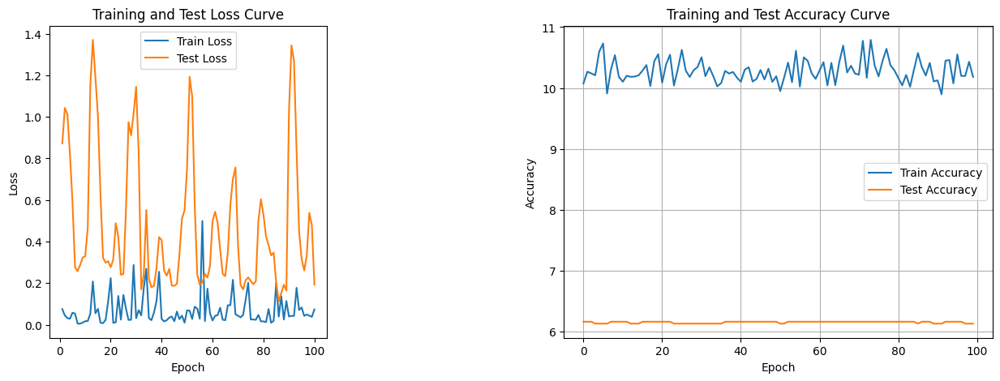

./saved_modelsmodel_73.pth
71


Training Process: 100%|██████████| 100/100 [00:02<00:00, 34.92it/s]


Total Epochs: 100
Train loss start: 0.010567436926066875, Train loss end: 0.0034806393086910248
Highest Train Accuracy: 14.8125
Test loss start: 0.29581645131111145, Test loss end: 0.04435576871037483
Highest Test Accuracy: 10.875


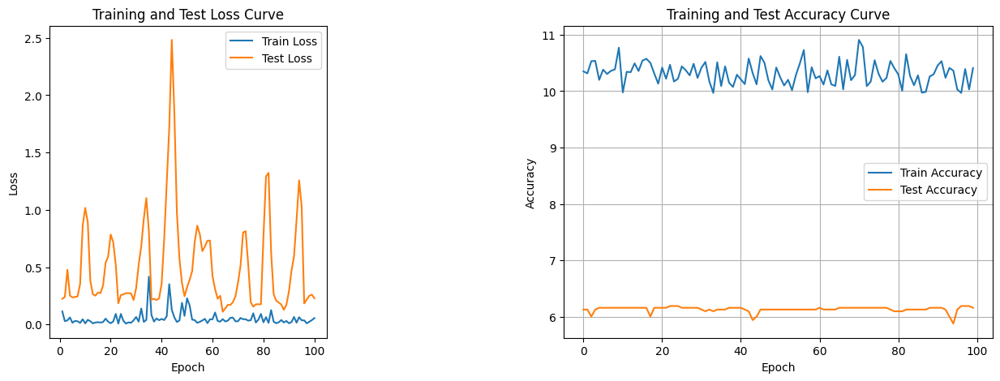

./saved_modelsmodel_71.pth
73


Training Process: 100%|██████████| 100/100 [00:02<00:00, 35.14it/s]


Total Epochs: 100
Train loss start: 0.024895718321204185, Train loss end: 0.014712668024003506
Highest Train Accuracy: 15.0
Test loss start: 0.23917721211910248, Test loss end: 2.0185203552246094
Highest Test Accuracy: 10.8125


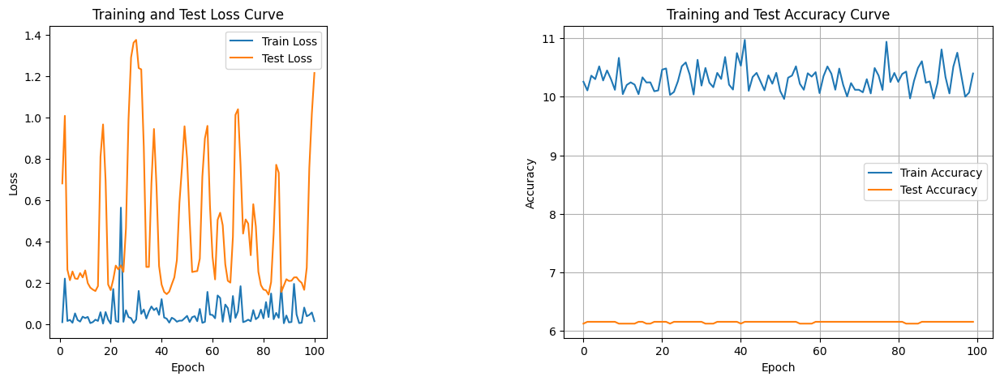

./saved_modelsmodel_73.pth
74


Training Process: 100%|██████████| 100/100 [00:02<00:00, 34.06it/s]


Total Epochs: 100
Train loss start: 0.0011161873117089272, Train loss end: 0.09871993958950043
Highest Train Accuracy: 14.9375
Test loss start: 0.286993145942688, Test loss end: 0.037779565900564194
Highest Test Accuracy: 10.8125


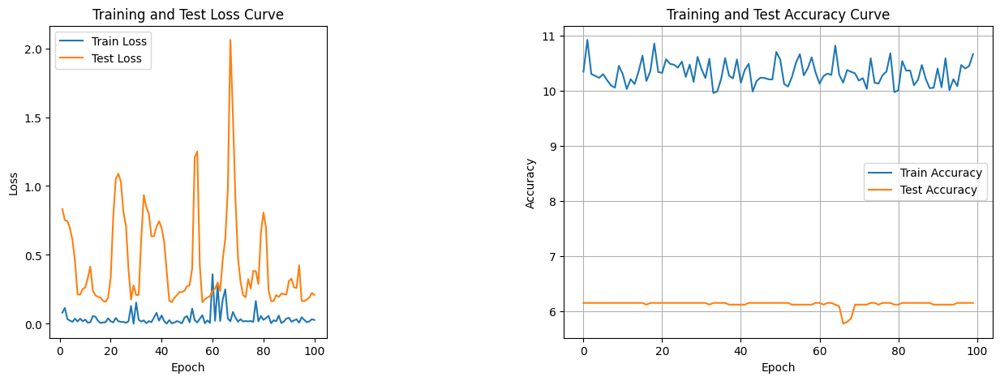

./saved_modelsmodel_74.pth
72


Training Process: 100%|██████████| 100/100 [00:03<00:00, 32.25it/s]


Total Epochs: 100
Train loss start: 0.013159382157027721, Train loss end: 0.0012045750627294183
Highest Train Accuracy: 16.75
Test loss start: 0.4024076759815216, Test loss end: 0.029906995594501495
Highest Test Accuracy: 10.8125


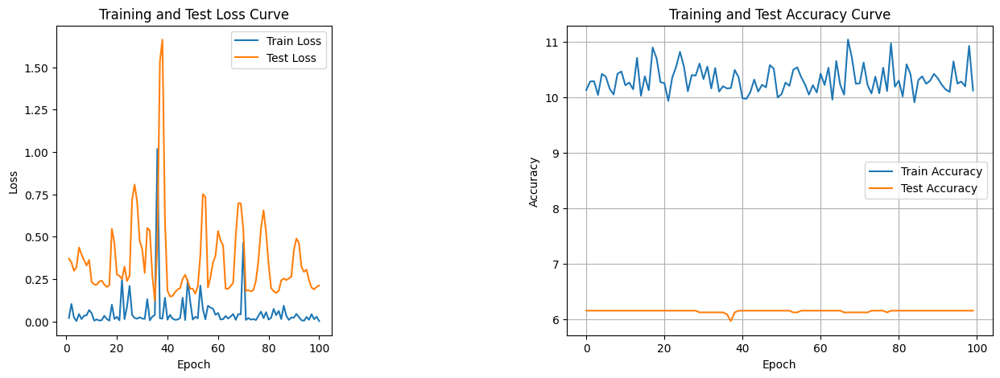

./saved_modelsmodel_72.pth
70


Training Process: 100%|██████████| 100/100 [00:02<00:00, 35.76it/s]


Total Epochs: 100
Train loss start: 0.012201417237520218, Train loss end: 0.0021404915023595095
Highest Train Accuracy: 14.75
Test loss start: 0.3256518840789795, Test loss end: 0.3922273814678192
Highest Test Accuracy: 10.875


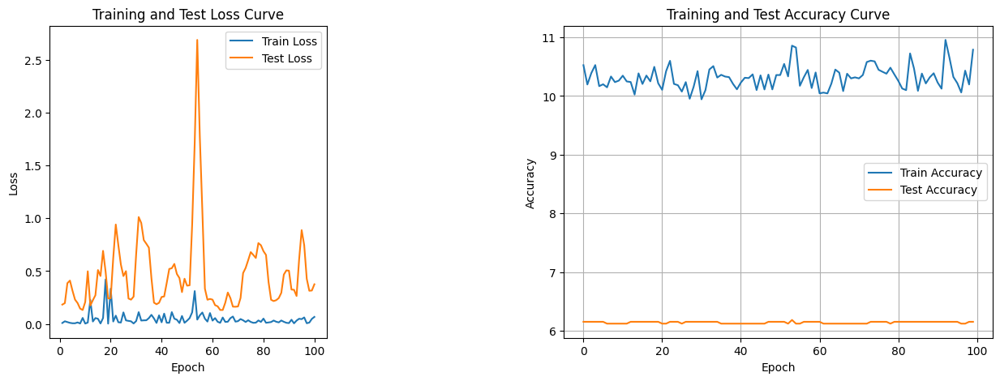

./saved_modelsmodel_70.pth
68


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.26it/s]


Total Epochs: 100
Train loss start: 0.004520050715655088, Train loss end: 0.003917038906365633
Highest Train Accuracy: 15.21875
Test loss start: 0.2849844694137573, Test loss end: 0.14681796729564667
Highest Test Accuracy: 10.875


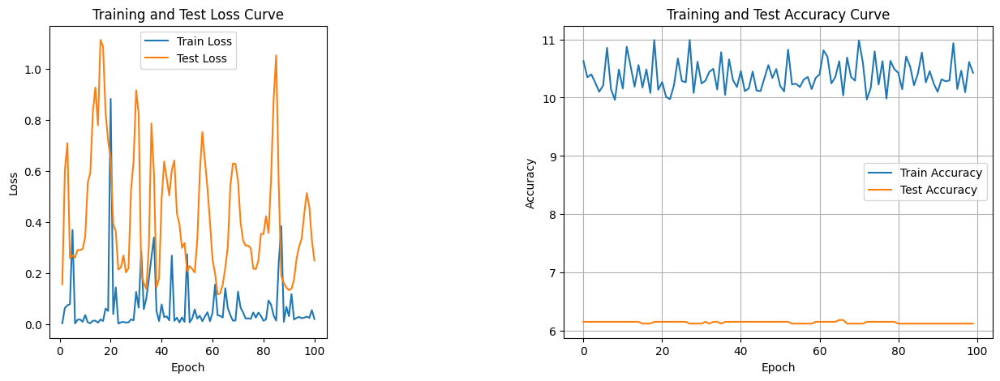

./saved_modelsmodel_68.pth
72


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.81it/s]


Total Epochs: 100
Train loss start: 0.07149506360292435, Train loss end: 0.006146552972495556
Highest Train Accuracy: 16.75
Test loss start: 0.3237796127796173, Test loss end: 1.1235145330429077
Highest Test Accuracy: 10.875


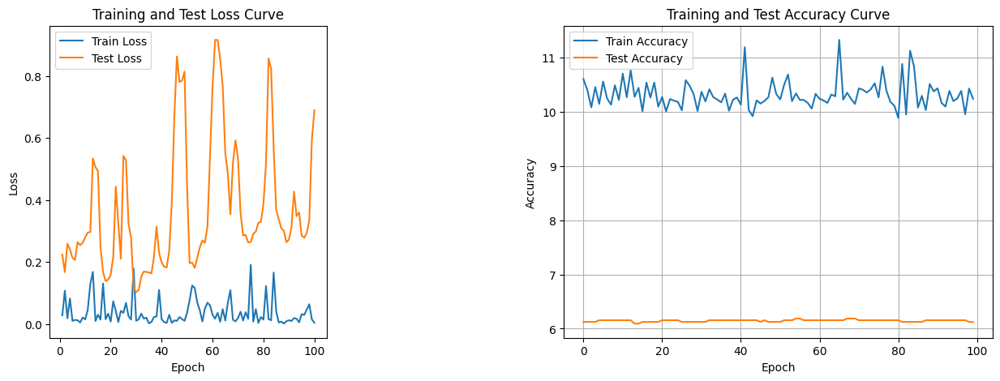

./saved_modelsmodel_72.pth
73


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.84it/s]


Total Epochs: 100
Train loss start: 0.14129744470119476, Train loss end: 0.03445282578468323
Highest Train Accuracy: 14.9375
Test loss start: 0.31734442710876465, Test loss end: 0.5129895806312561
Highest Test Accuracy: 10.8125


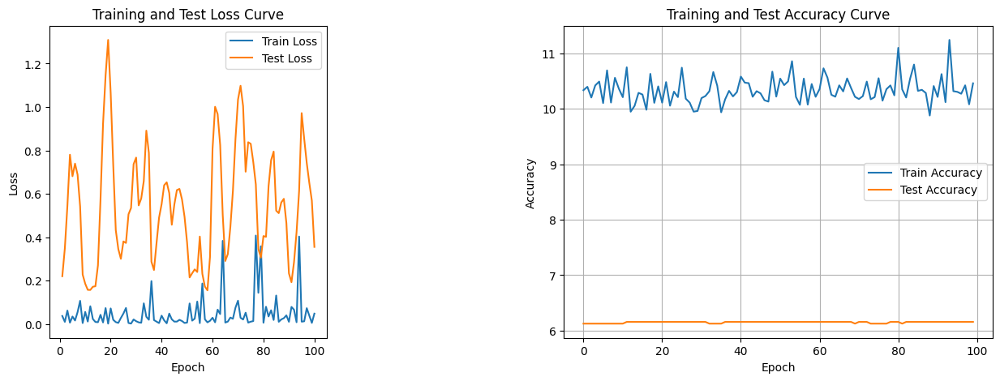

./saved_modelsmodel_73.pth
71


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.54it/s]


Total Epochs: 100
Train loss start: 0.0034971449058502913, Train loss end: 0.00036703477962873876
Highest Train Accuracy: 15.0
Test loss start: 0.32064390182495117, Test loss end: 1.6566680669784546
Highest Test Accuracy: 10.875


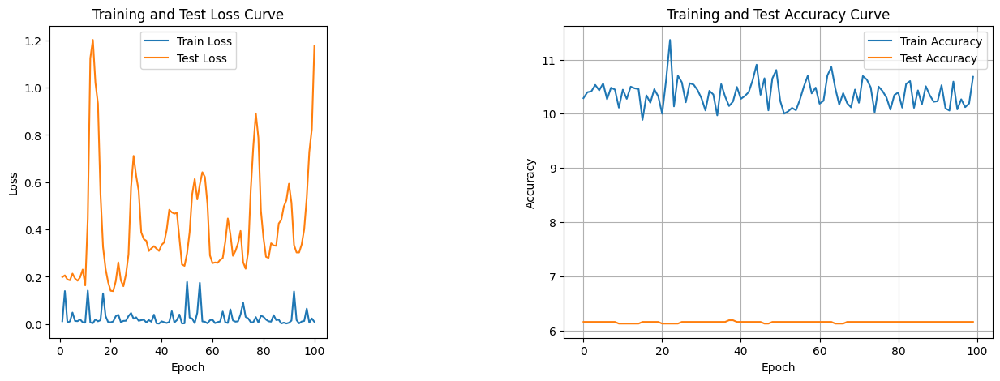

./saved_modelsmodel_71.pth
73


Training Process: 100%|██████████| 100/100 [00:02<00:00, 38.15it/s]


Total Epochs: 100
Train loss start: 0.0036185134667903185, Train loss end: 0.0002086818276438862
Highest Train Accuracy: 14.65625
Test loss start: 0.3975580632686615, Test loss end: 0.2478277087211609
Highest Test Accuracy: 10.875


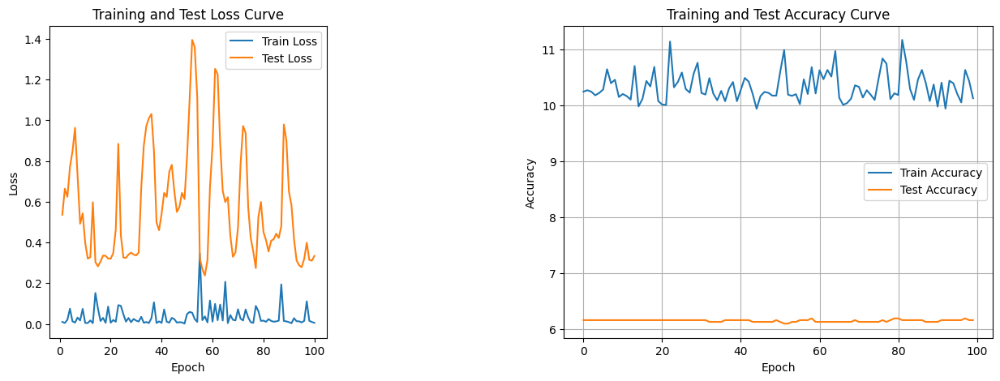

./saved_modelsmodel_73.pth
74


Training Process: 100%|██████████| 100/100 [00:02<00:00, 35.76it/s]


Total Epochs: 100
Train loss start: 0.0001304454926867038, Train loss end: 0.03204522654414177
Highest Train Accuracy: 15.6875
Test loss start: 0.3694288730621338, Test loss end: 0.5482891201972961
Highest Test Accuracy: 10.8125


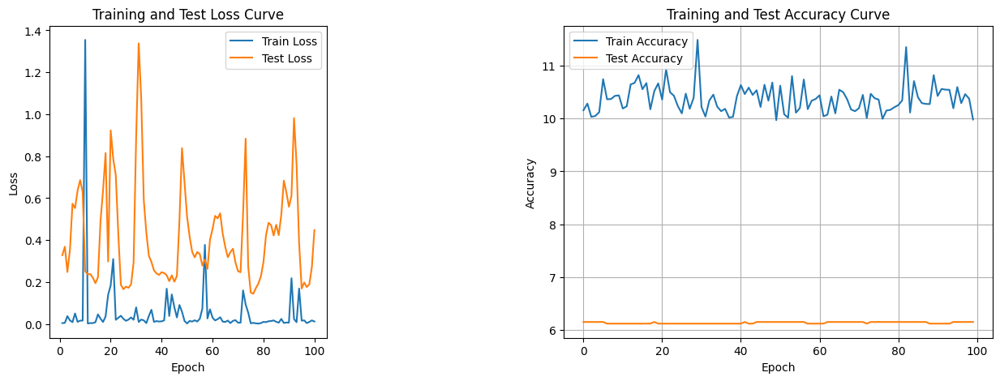

./saved_modelsmodel_74.pth
72


Training Process: 100%|██████████| 100/100 [00:02<00:00, 37.97it/s]


Total Epochs: 100
Train loss start: 0.009006376378238201, Train loss end: 0.0012666527181863785
Highest Train Accuracy: 14.8125
Test loss start: 0.34707921743392944, Test loss end: 0.24421286582946777
Highest Test Accuracy: 10.875


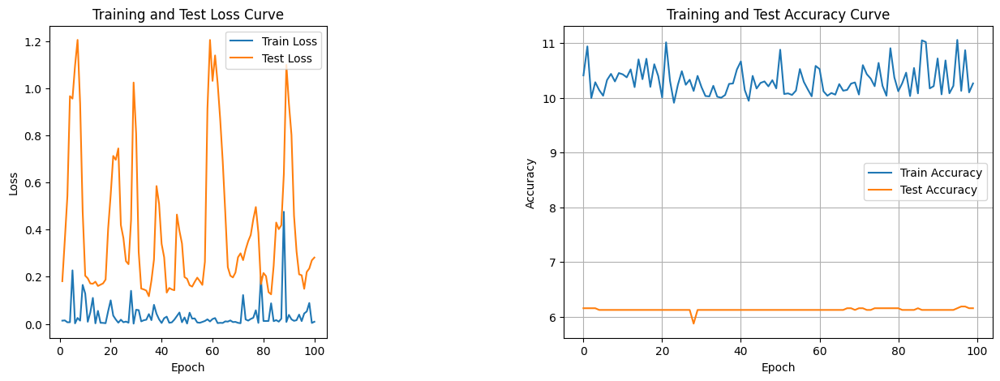

./saved_modelsmodel_72.pth
70


Training Process: 100%|██████████| 100/100 [00:02<00:00, 33.72it/s]


Total Epochs: 100
Train loss start: 0.03062419965863228, Train loss end: 0.12924757599830627
Highest Train Accuracy: 15.8125
Test loss start: 0.4149739742279053, Test loss end: 0.02861919440329075
Highest Test Accuracy: 10.8125


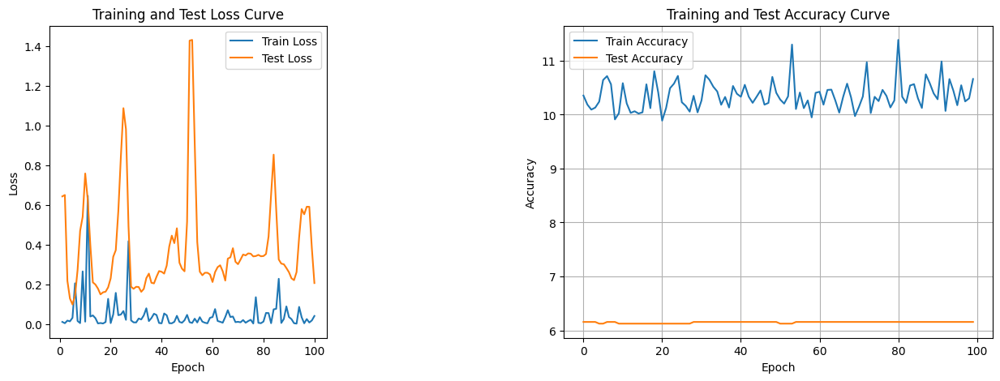

./saved_modelsmodel_70.pth
73


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.38it/s]


Total Epochs: 100
Train loss start: 0.008270222693681717, Train loss end: 0.0003122191410511732
Highest Train Accuracy: 15.8125
Test loss start: 0.32058584690093994, Test loss end: 2.2384705543518066
Highest Test Accuracy: 10.875


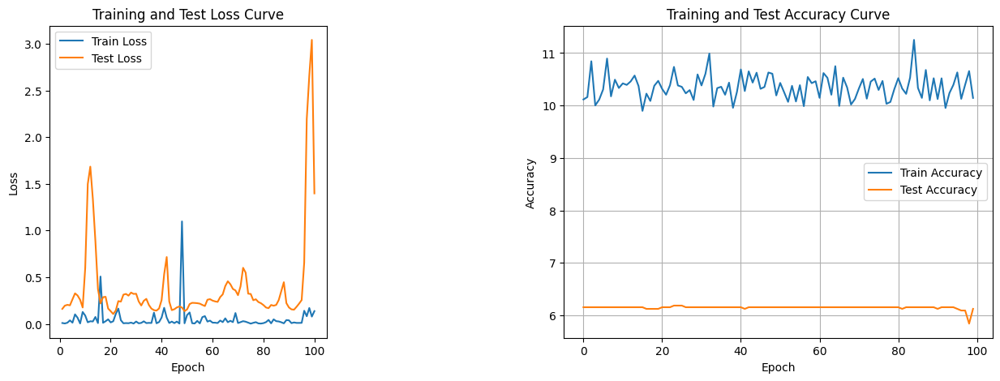

./saved_modelsmodel_73.pth
74


Training Process: 100%|██████████| 100/100 [00:02<00:00, 35.19it/s]


Total Epochs: 100
Train loss start: 0.012726563028991222, Train loss end: 0.12094169855117798
Highest Train Accuracy: 15.3125
Test loss start: 0.37243297696113586, Test loss end: 0.09398434311151505
Highest Test Accuracy: 10.875


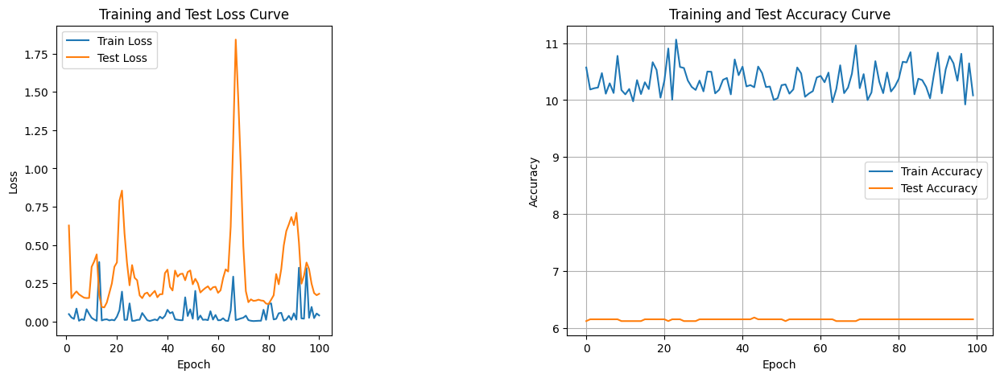

./saved_modelsmodel_74.pth
72


Training Process: 100%|██████████| 100/100 [00:02<00:00, 35.18it/s]


Total Epochs: 100
Train loss start: 0.0012176077580079436, Train loss end: 0.05538923293352127
Highest Train Accuracy: 14.8125
Test loss start: 0.2987568974494934, Test loss end: 0.8186473250389099
Highest Test Accuracy: 10.8125


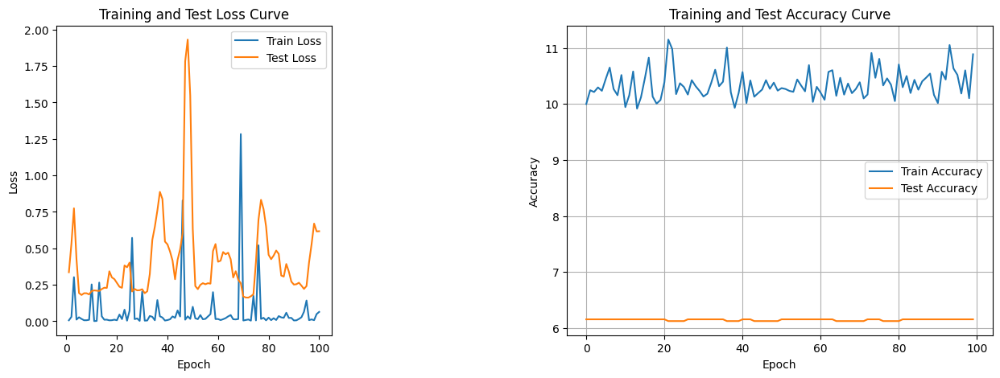

./saved_modelsmodel_72.pth
74


Training Process: 100%|██████████| 100/100 [00:02<00:00, 35.21it/s]


Total Epochs: 100
Train loss start: 0.009435759857296944, Train loss end: 0.0037182781379669905
Highest Train Accuracy: 15.21875
Test loss start: 0.29730653762817383, Test loss end: 0.07626990228891373
Highest Test Accuracy: 10.8125


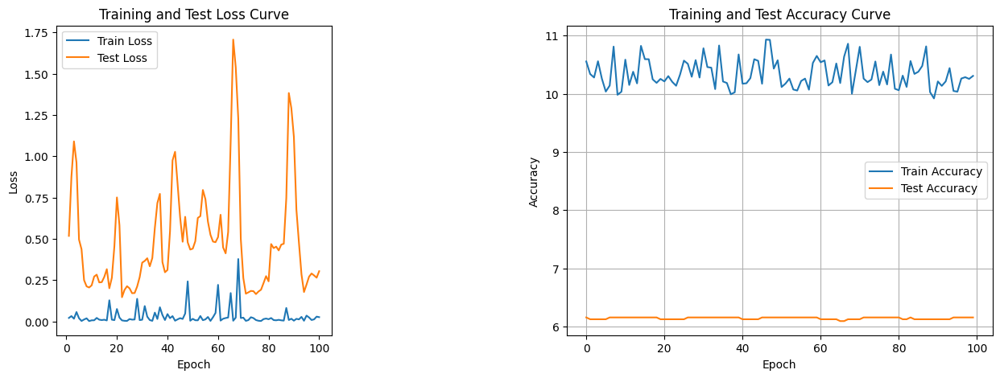

./saved_modelsmodel_74.pth
75


Training Process: 100%|██████████| 100/100 [00:02<00:00, 35.09it/s]


Total Epochs: 100
Train loss start: 0.009085827507078648, Train loss end: 0.0011301216436550021
Highest Train Accuracy: 15.5
Test loss start: 0.3775132894515991, Test loss end: 0.2624395489692688
Highest Test Accuracy: 10.875


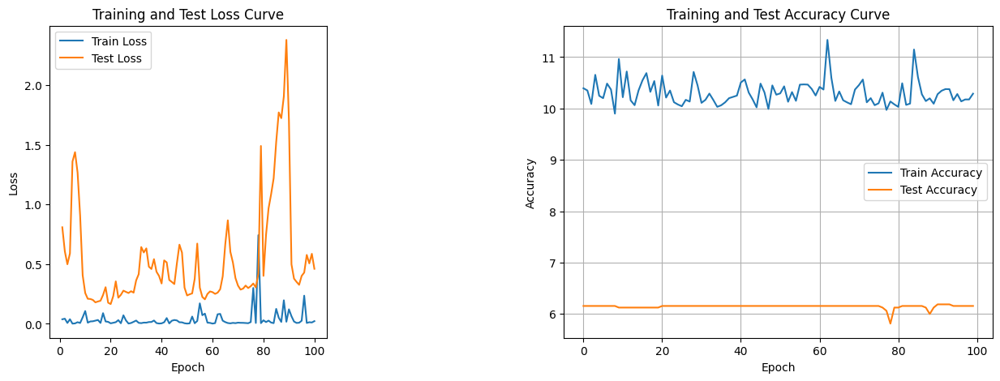

./saved_modelsmodel_75.pth
73


Training Process: 100%|██████████| 100/100 [00:02<00:00, 34.03it/s]


Total Epochs: 100
Train loss start: 0.012065151706337929, Train loss end: 0.008278991095721722
Highest Train Accuracy: 14.78125
Test loss start: 0.45363306999206543, Test loss end: 0.21464794874191284
Highest Test Accuracy: 10.8125


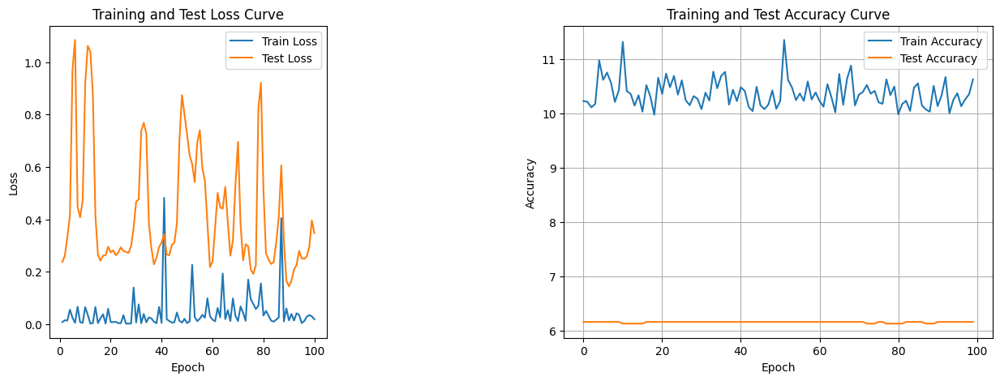

./saved_modelsmodel_73.pth
71


Training Process: 100%|██████████| 100/100 [00:02<00:00, 37.07it/s]


Total Epochs: 100
Train loss start: 0.001518837409093976, Train loss end: 0.004629303701221943
Highest Train Accuracy: 14.8125
Test loss start: 0.4645059406757355, Test loss end: 0.0008368011331185699
Highest Test Accuracy: 10.8125


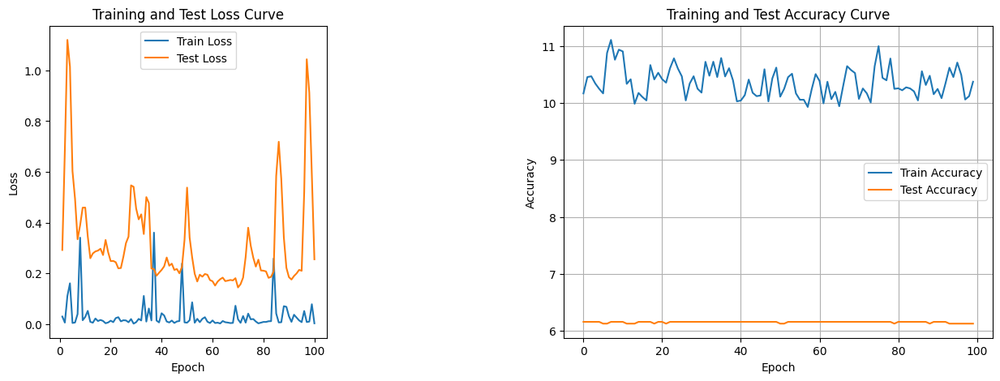

./saved_modelsmodel_71.pth
69


Training Process: 100%|██████████| 100/100 [00:02<00:00, 33.45it/s]


Total Epochs: 100
Train loss start: 0.007559760008007288, Train loss end: 0.009140117093920708
Highest Train Accuracy: 15.3125
Test loss start: 0.47144806385040283, Test loss end: 2.216289520263672
Highest Test Accuracy: 10.875


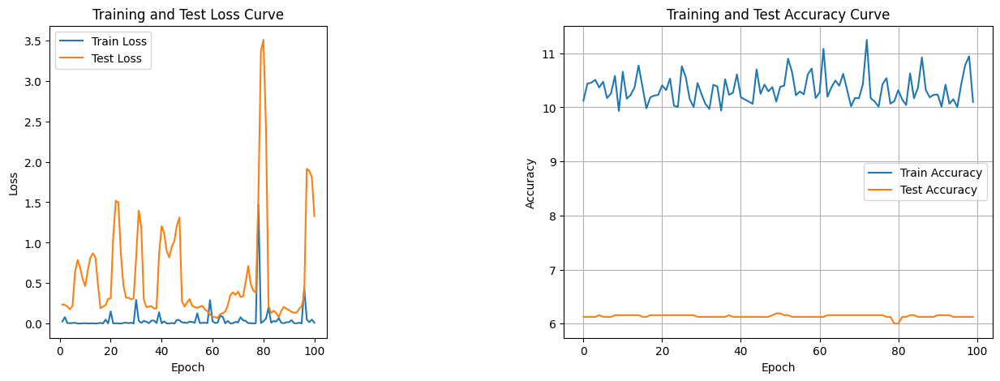

./saved_modelsmodel_69.pth
67


Training Process: 100%|██████████| 100/100 [00:02<00:00, 37.56it/s]


Total Epochs: 100
Train loss start: 0.008119831793010235, Train loss end: 0.0010830237297341228
Highest Train Accuracy: 15.65625
Test loss start: 0.45095476508140564, Test loss end: 0.023007722571492195
Highest Test Accuracy: 10.8125


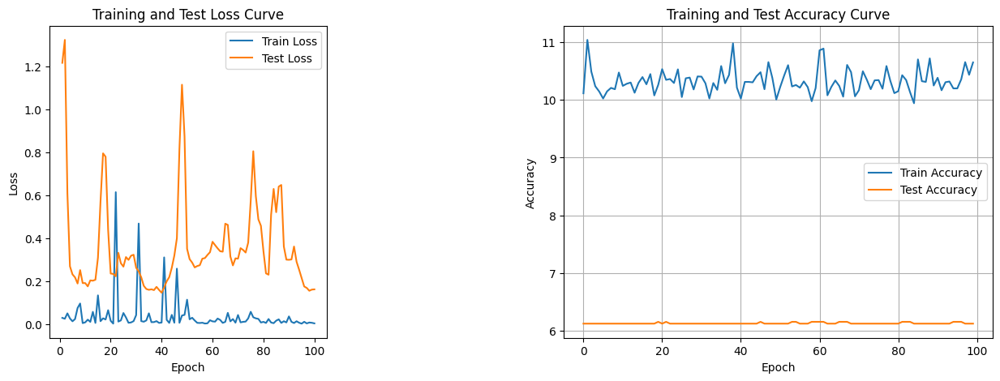

./saved_modelsmodel_67.pth
72


Training Process: 100%|██████████| 100/100 [00:03<00:00, 32.31it/s]


Total Epochs: 100
Train loss start: 0.0014885476557537913, Train loss end: 0.4169212877750397
Highest Train Accuracy: 15.8125
Test loss start: 0.4265483021736145, Test loss end: 2.9746429920196533
Highest Test Accuracy: 10.875


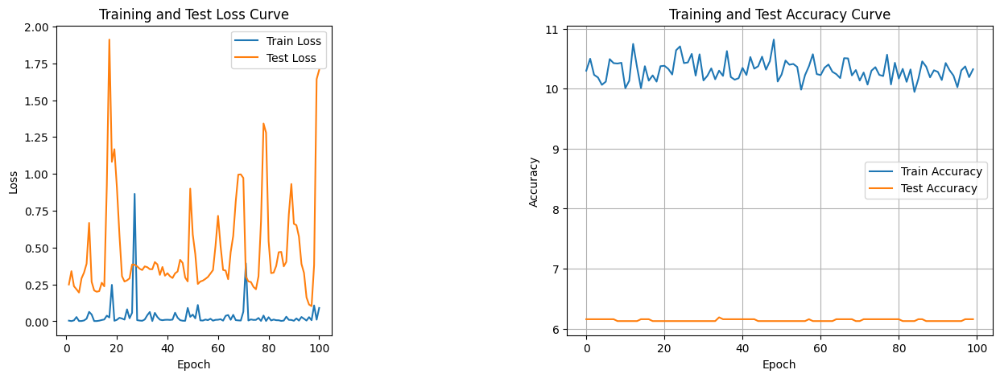

./saved_modelsmodel_72.pth
73


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.21it/s]


Total Epochs: 100
Train loss start: 1.4851620107947383e-05, Train loss end: 0.0038606084417551756
Highest Train Accuracy: 14.8125
Test loss start: 0.4340498447418213, Test loss end: 0.027059493586421013
Highest Test Accuracy: 10.8125


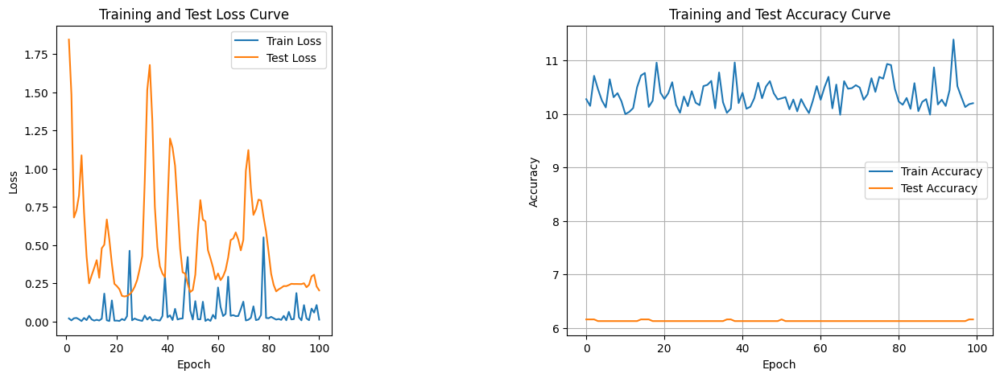

./saved_modelsmodel_73.pth
71


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.82it/s]


Total Epochs: 100
Train loss start: 0.0048170085065066814, Train loss end: 0.000505915901158005
Highest Train Accuracy: 14.6875
Test loss start: 0.4302697777748108, Test loss end: 0.020968284457921982
Highest Test Accuracy: 10.8125


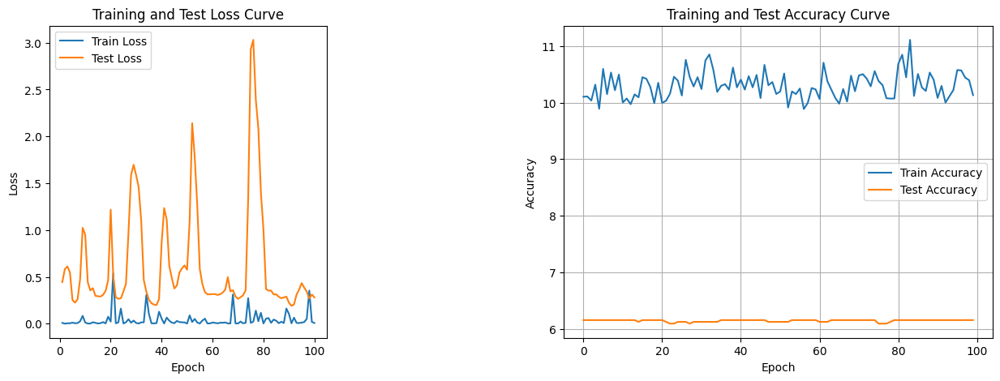

./saved_modelsmodel_71.pth
73


Training Process: 100%|██████████| 100/100 [00:02<00:00, 34.75it/s]


Total Epochs: 100
Train loss start: 0.02239019051194191, Train loss end: 0.004960087593644857
Highest Train Accuracy: 15.1875
Test loss start: 0.4327366054058075, Test loss end: 0.1807611733675003
Highest Test Accuracy: 10.8125


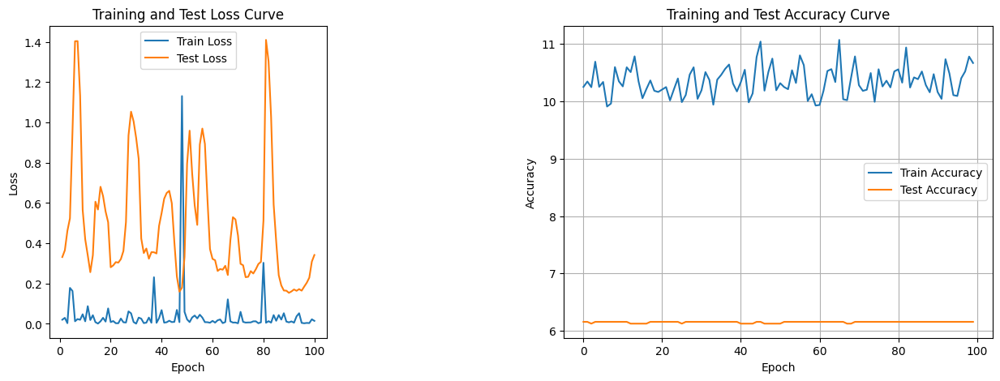

./saved_modelsmodel_73.pth
74


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.37it/s]


Total Epochs: 100
Train loss start: 0.00018551330140326172, Train loss end: 5.633906841278076
Highest Train Accuracy: 16.15625
Test loss start: 0.4108925461769104, Test loss end: 1.2324881553649902
Highest Test Accuracy: 10.8125


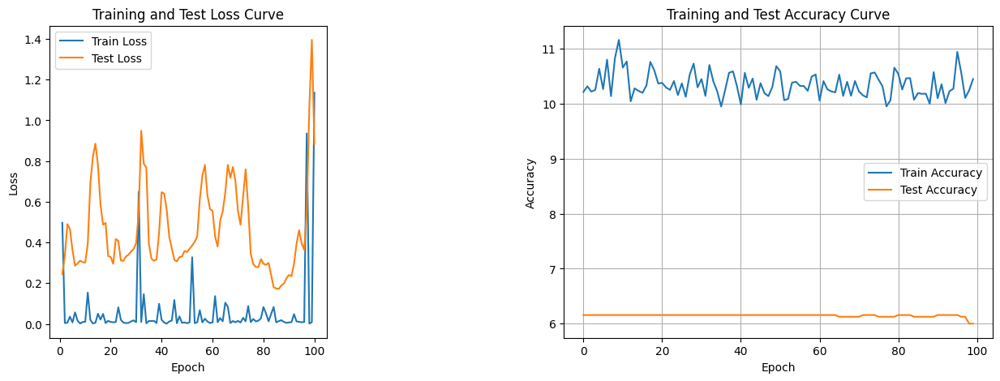

./saved_modelsmodel_74.pth
72


Training Process: 100%|██████████| 100/100 [00:02<00:00, 35.70it/s]


Total Epochs: 100
Train loss start: 0.014324560761451721, Train loss end: 0.034813206642866135
Highest Train Accuracy: 15.0
Test loss start: 0.41217127442359924, Test loss end: 0.5545123219490051
Highest Test Accuracy: 10.875


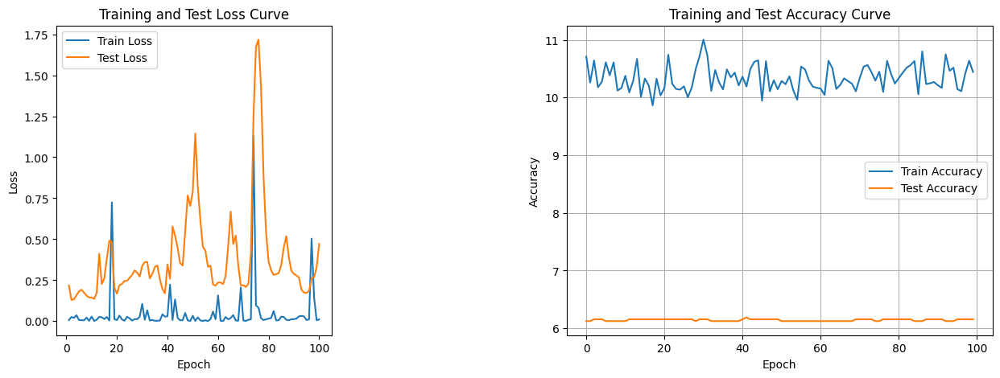

./saved_modelsmodel_72.pth
70


Training Process: 100%|██████████| 100/100 [00:02<00:00, 37.74it/s]


Total Epochs: 100
Train loss start: 0.028699830174446106, Train loss end: 0.00500086834654212
Highest Train Accuracy: 16.34375
Test loss start: 0.5945649147033691, Test loss end: 0.012673558667302132
Highest Test Accuracy: 10.8125


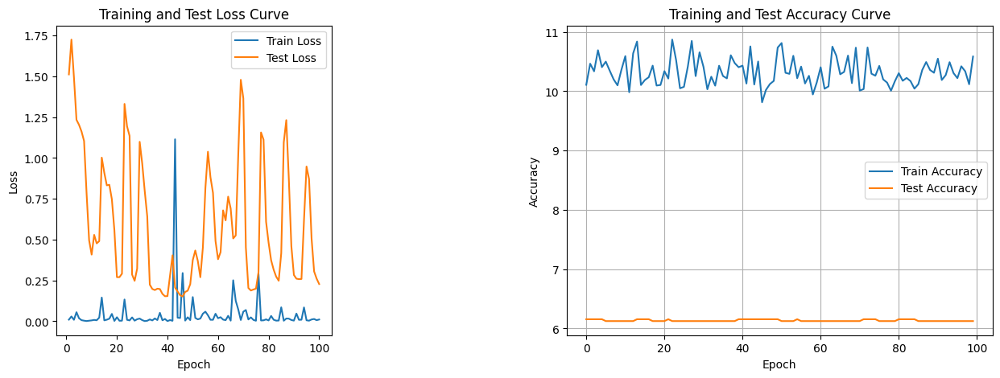

./saved_modelsmodel_70.pth
73


Training Process: 100%|██████████| 100/100 [00:02<00:00, 35.95it/s]


Total Epochs: 100
Train loss start: 0.010589594952762127, Train loss end: 0.06391986459493637
Highest Train Accuracy: 16.5
Test loss start: 0.3937709629535675, Test loss end: 0.363689661026001
Highest Test Accuracy: 10.8125


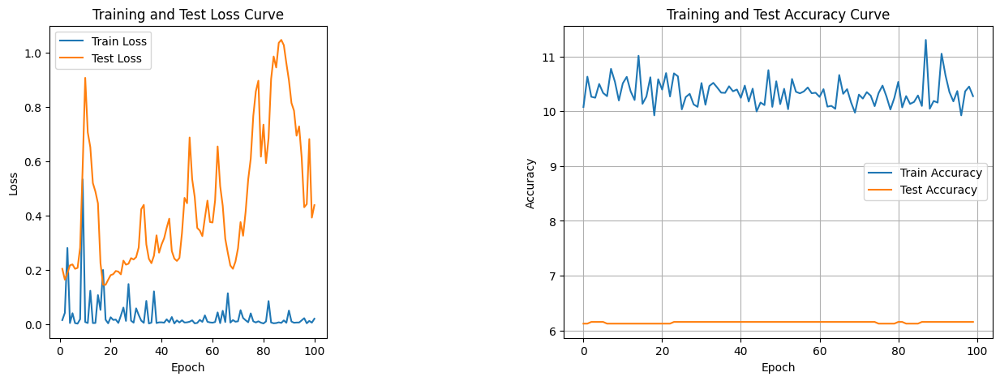

./saved_modelsmodel_73.pth
74


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.32it/s]


Total Epochs: 100
Train loss start: 0.000776920816861093, Train loss end: 0.001377509324811399
Highest Train Accuracy: 16.6875
Test loss start: 0.47497498989105225, Test loss end: 0.2714749574661255
Highest Test Accuracy: 10.875


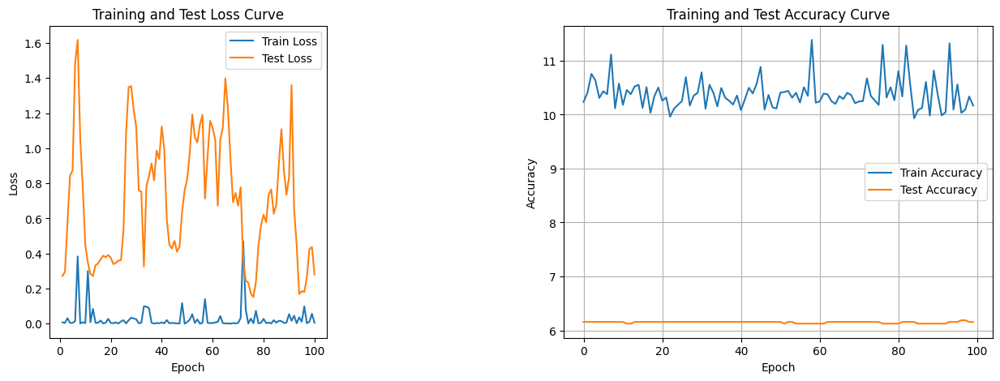

./saved_modelsmodel_74.pth
72


Training Process: 100%|██████████| 100/100 [00:02<00:00, 33.52it/s]


Total Epochs: 100
Train loss start: 0.004086748231202364, Train loss end: 0.0001581818942213431
Highest Train Accuracy: 15.8125
Test loss start: 0.18255174160003662, Test loss end: 0.07499625533819199
Highest Test Accuracy: 10.8125


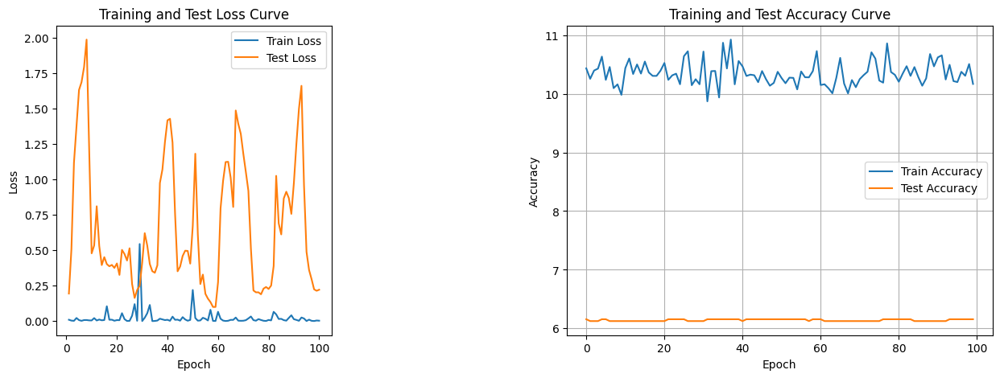

./saved_modelsmodel_72.pth
74


Training Process: 100%|██████████| 100/100 [00:02<00:00, 35.72it/s]


Total Epochs: 100
Train loss start: 0.010468317195773125, Train loss end: 0.0004288821655791253
Highest Train Accuracy: 15.6875
Test loss start: 0.3378218710422516, Test loss end: 0.15988358855247498
Highest Test Accuracy: 10.875


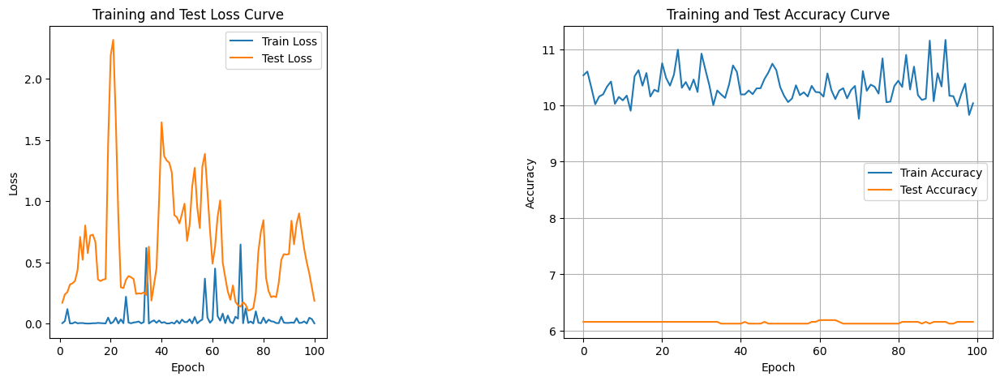

./saved_modelsmodel_74.pth
75


Training Process: 100%|██████████| 100/100 [00:02<00:00, 35.35it/s]


Total Epochs: 100
Train loss start: 0.0063126469030976295, Train loss end: 0.024707172065973282
Highest Train Accuracy: 14.8125
Test loss start: 0.16800475120544434, Test loss end: 0.1904565840959549
Highest Test Accuracy: 10.8125


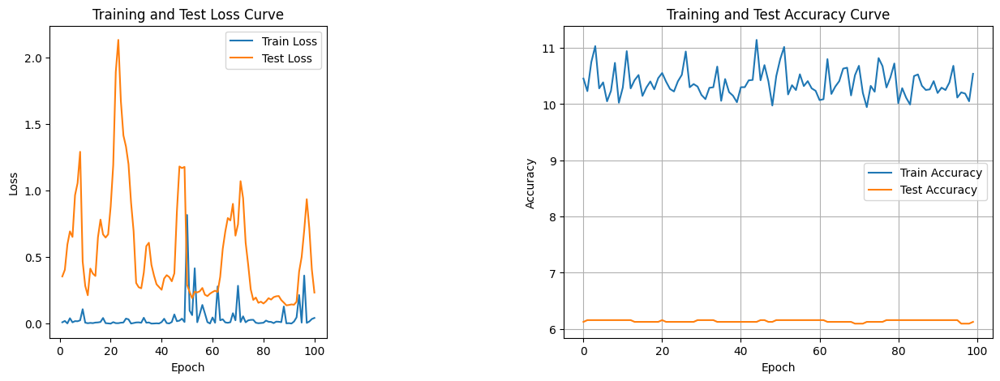

./saved_modelsmodel_75.pth
73


Training Process: 100%|██████████| 100/100 [00:02<00:00, 34.61it/s]


Total Epochs: 100
Train loss start: 0.003664571326225996, Train loss end: 0.42578020691871643
Highest Train Accuracy: 15.8125
Test loss start: 0.30932891368865967, Test loss end: 0.7804732918739319
Highest Test Accuracy: 10.8125


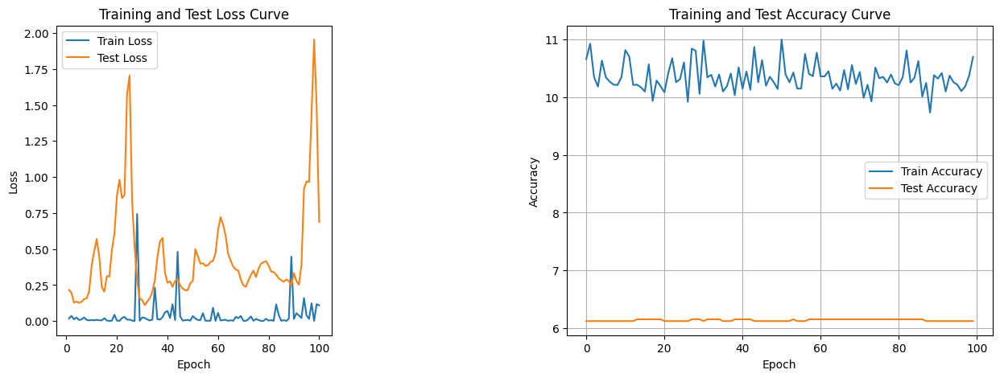

./saved_modelsmodel_73.pth
71


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.43it/s]


Total Epochs: 100
Train loss start: 0.013719594106078148, Train loss end: 0.0025889442767947912
Highest Train Accuracy: 15.4375
Test loss start: 0.48213180899620056, Test loss end: 0.0016850850079208612
Highest Test Accuracy: 10.8125


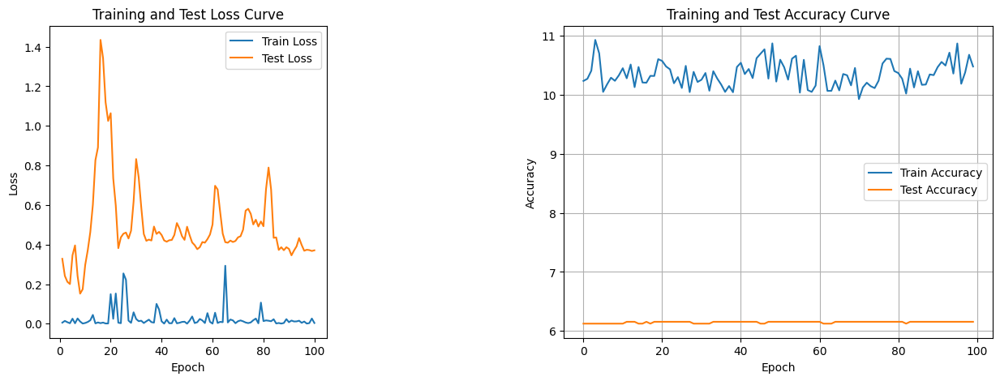

./saved_modelsmodel_71.pth
69


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.87it/s]


Total Epochs: 100
Train loss start: 0.003498780308291316, Train loss end: 0.00041251894435845315
Highest Train Accuracy: 15.8125
Test loss start: 0.7978322505950928, Test loss end: 0.36816027760505676
Highest Test Accuracy: 10.875


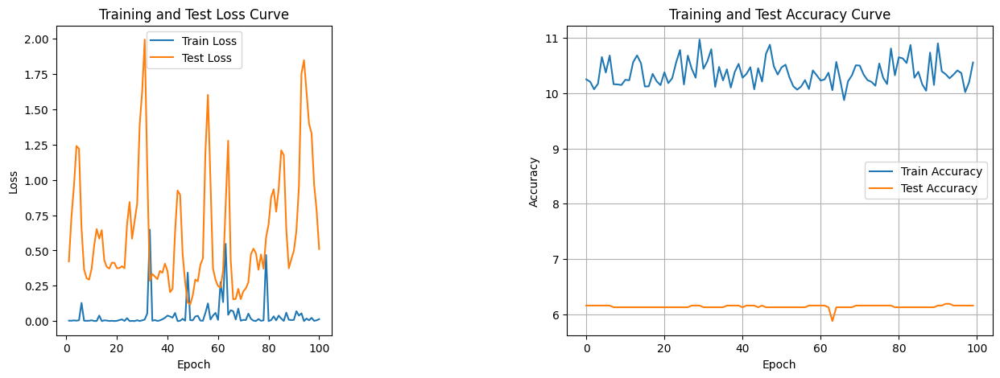

./saved_modelsmodel_69.pth
73


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.52it/s]


Total Epochs: 100
Train loss start: 0.00043869431829079986, Train loss end: 0.07644923031330109
Highest Train Accuracy: 16.9375
Test loss start: 0.8087173700332642, Test loss end: 1.8201392889022827
Highest Test Accuracy: 10.8125


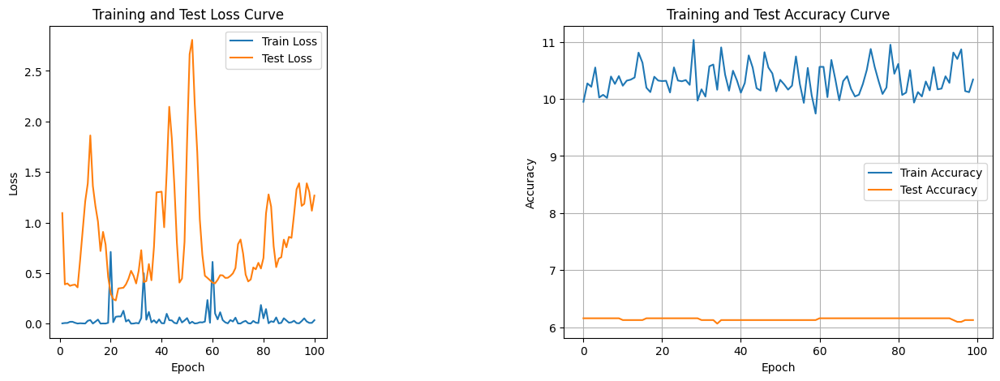

./saved_modelsmodel_73.pth
74


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.59it/s]


Total Epochs: 100
Train loss start: 0.010307292453944683, Train loss end: 0.002626517554745078
Highest Train Accuracy: 16.4375
Test loss start: 0.6970340609550476, Test loss end: 2.051081657409668
Highest Test Accuracy: 10.875


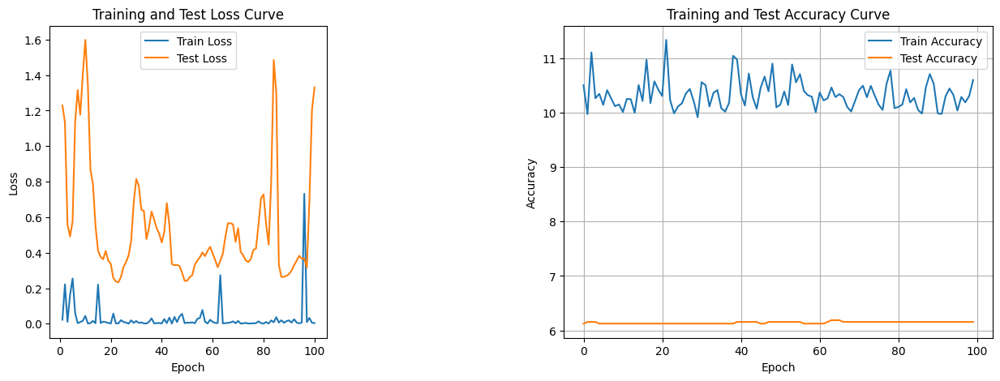

./saved_modelsmodel_74.pth
72


Training Process: 100%|██████████| 100/100 [00:02<00:00, 34.00it/s]


Total Epochs: 100
Train loss start: 0.002278136322274804, Train loss end: 0.009641326032578945
Highest Train Accuracy: 15.6875
Test loss start: 0.5237101912498474, Test loss end: 0.003637206507846713
Highest Test Accuracy: 10.8125


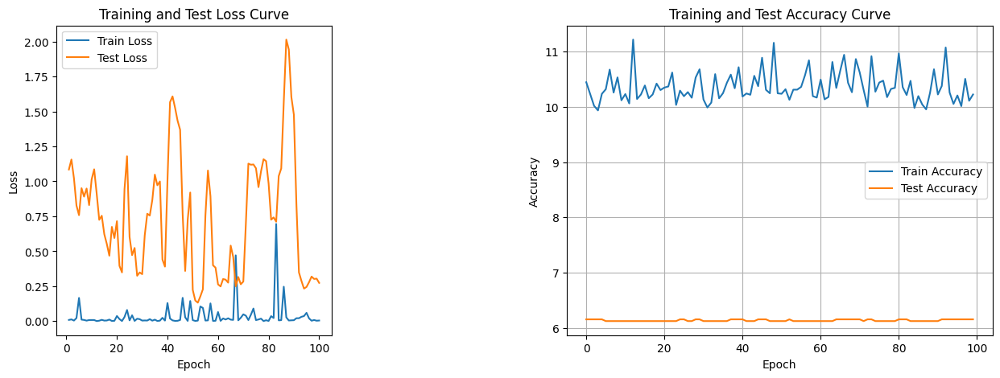

./saved_modelsmodel_72.pth
74


Training Process: 100%|██████████| 100/100 [00:02<00:00, 34.13it/s]


Total Epochs: 100
Train loss start: 0.0035549921449273825, Train loss end: 0.00354753783904016
Highest Train Accuracy: 15.71875
Test loss start: 0.4351952373981476, Test loss end: 0.908646821975708
Highest Test Accuracy: 10.875


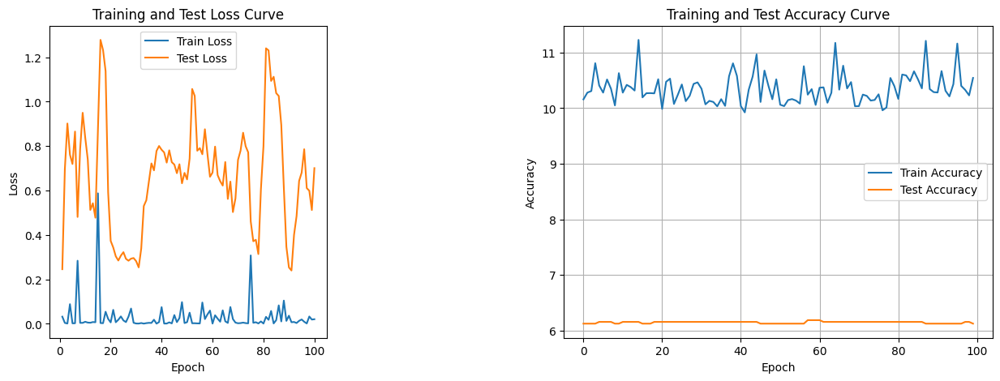

./saved_modelsmodel_74.pth
75


Training Process: 100%|██████████| 100/100 [00:02<00:00, 36.34it/s]


Total Epochs: 100
Train loss start: 0.0002961610443890095, Train loss end: 1.0300577878952026
Highest Train Accuracy: 15.6875
Test loss start: 0.3811689019203186, Test loss end: 1.2518996000289917
Highest Test Accuracy: 10.8125


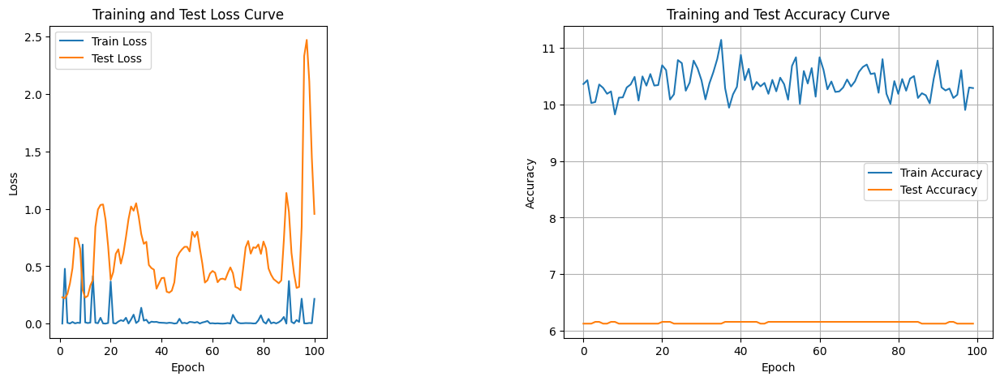

./saved_modelsmodel_75.pth
73


Training Process: 100%|██████████| 100/100 [00:02<00:00, 34.99it/s]


Total Epochs: 100
Train loss start: 0.27341485023498535, Train loss end: 0.5248022675514221
Highest Train Accuracy: 16.0625
Test loss start: 0.583053708076477, Test loss end: 0.704866886138916
Highest Test Accuracy: 10.8125


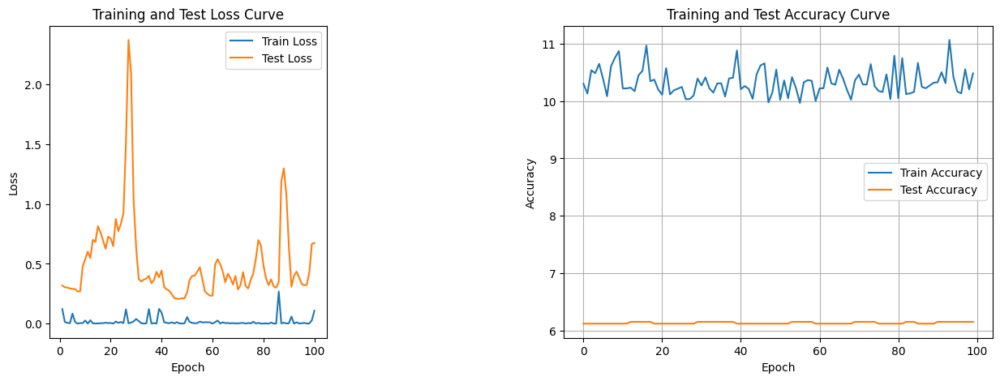

./saved_modelsmodel_73.pth
71


Training Process: 100%|██████████| 100/100 [00:03<00:00, 31.12it/s]


Total Epochs: 100
Train loss start: 0.0017778382170945406, Train loss end: 6.534095882670954e-05
Highest Train Accuracy: 15.0
Test loss start: 0.7474300265312195, Test loss end: 0.9360774755477905
Highest Test Accuracy: 10.875


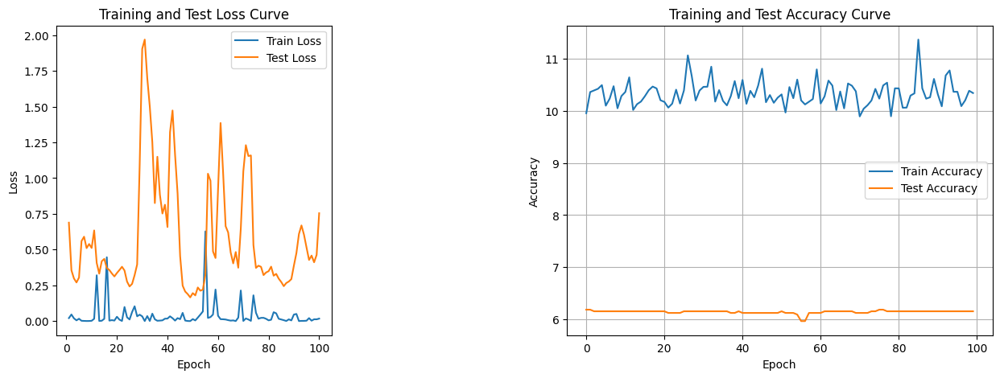

./saved_modelsmodel_71.pth
74


Training Process: 100%|██████████| 100/100 [00:02<00:00, 34.73it/s]


Total Epochs: 100
Train loss start: 0.0007108360296115279, Train loss end: 1.048984813678544e-05
Highest Train Accuracy: 16.75
Test loss start: 0.5577426552772522, Test loss end: 0.0008331011631526053
Highest Test Accuracy: 10.8125


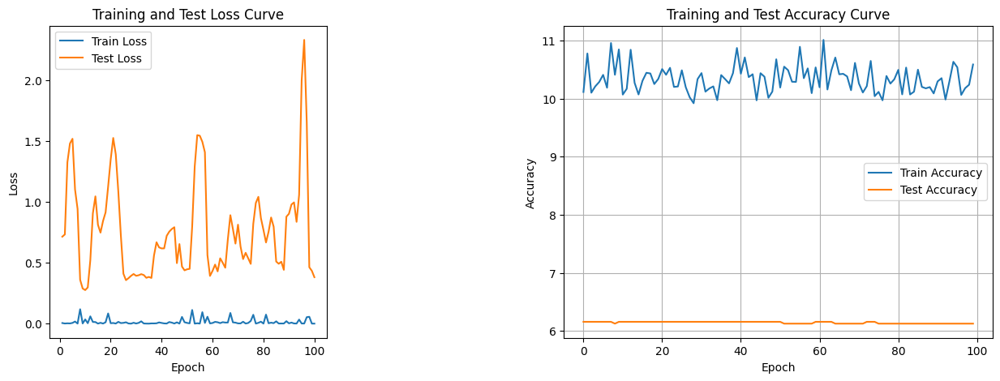

./saved_modelsmodel_74.pth
75


Training Process: 100%|██████████| 100/100 [00:02<00:00, 33.85it/s]


Total Epochs: 100
Train loss start: 3.399076376808807e-05, Train loss end: 0.00019760674331337214
Highest Train Accuracy: 15.3125
Test loss start: 0.8290400505065918, Test loss end: 0.8132466673851013
Highest Test Accuracy: 10.8125


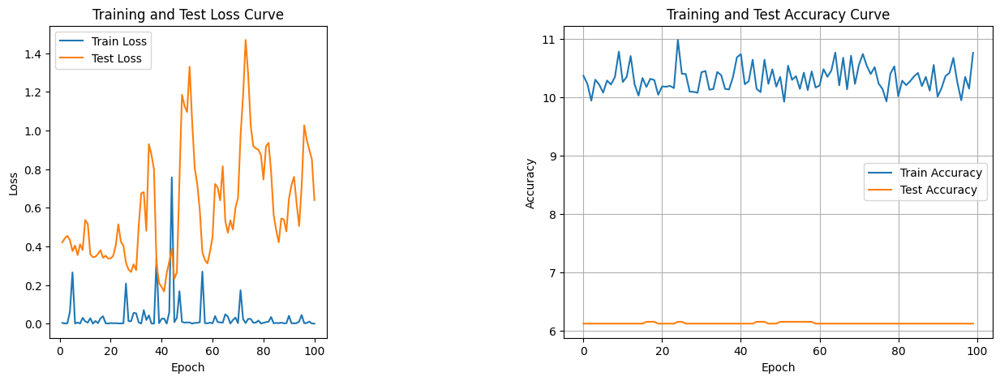

./saved_modelsmodel_75.pth
73


Training Process: 100%|██████████| 100/100 [00:02<00:00, 34.04it/s]


Total Epochs: 100
Train loss start: 0.0018968163058161736, Train loss end: 0.0011814807076007128
Highest Train Accuracy: 15.8125
Test loss start: 0.3469753861427307, Test loss end: 0.3137088716030121
Highest Test Accuracy: 10.8125


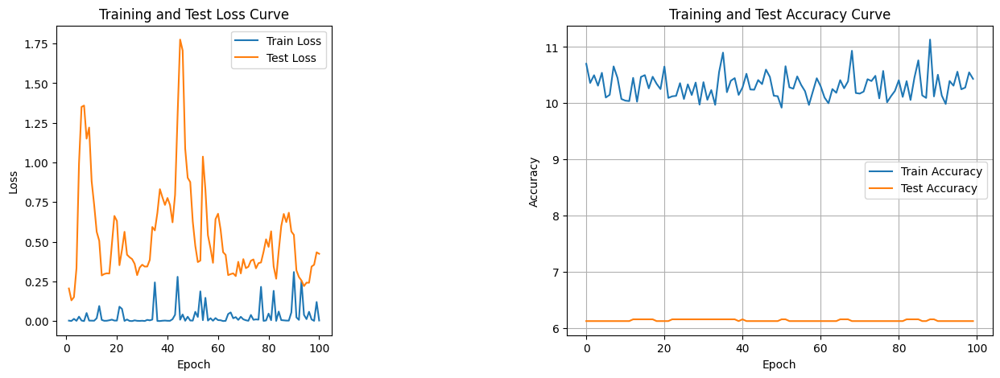

./saved_modelsmodel_73.pth
75


Training Process: 100%|██████████| 100/100 [00:02<00:00, 34.15it/s]


Total Epochs: 100
Train loss start: 0.0062642404809594154, Train loss end: 2.66048991761636e-05
Highest Train Accuracy: 16.6875
Test loss start: 0.5455547571182251, Test loss end: 4.586655616760254
Highest Test Accuracy: 10.8125


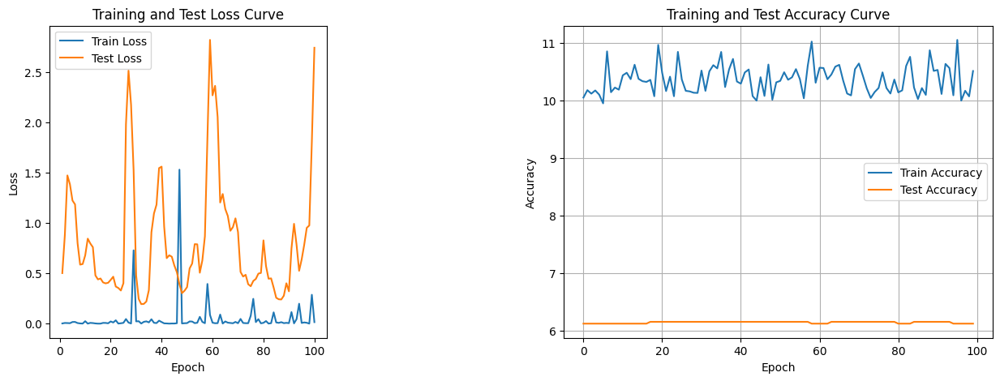

./saved_modelsmodel_75.pth
76


Training Process: 100%|██████████| 100/100 [00:02<00:00, 34.03it/s]


Total Epochs: 100
Train loss start: 0.001603649347089231, Train loss end: 0.0016645335126668215
Highest Train Accuracy: 14.8125
Test loss start: 0.5124578475952148, Test loss end: 0.010608667507767677
Highest Test Accuracy: 10.8125


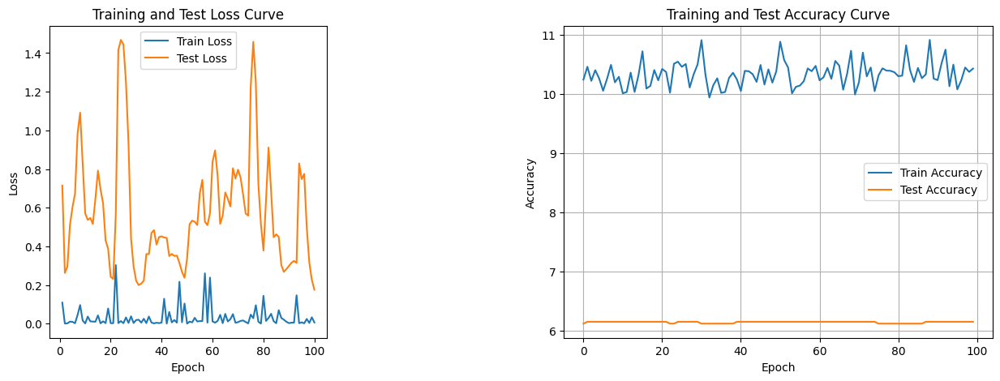

./saved_modelsmodel_76.pth
74


Training Process: 100%|██████████| 100/100 [00:03<00:00, 32.75it/s]


Total Epochs: 100
Train loss start: 0.0009508543880656362, Train loss end: 0.0001490296417614445
Highest Train Accuracy: 15.3125
Test loss start: 0.350862979888916, Test loss end: 0.6872499585151672
Highest Test Accuracy: 10.8125


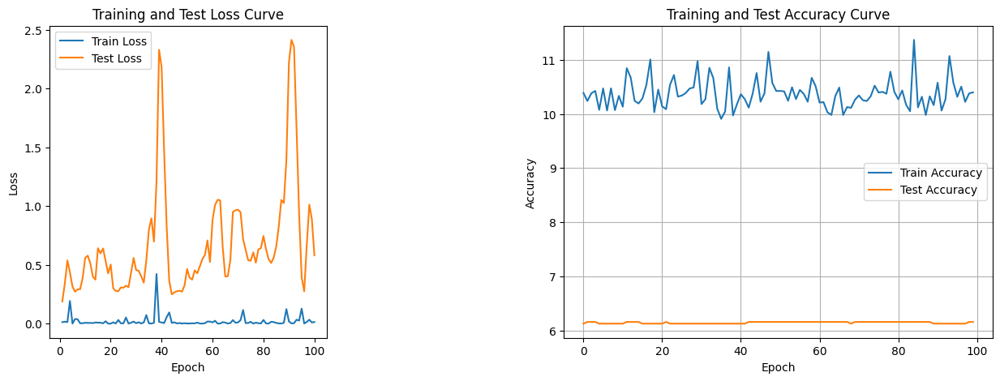

./saved_modelsmodel_74.pth
72


Training Process: 100%|██████████| 100/100 [00:02<00:00, 35.11it/s]


Total Epochs: 100
Train loss start: 0.0015518601285293698, Train loss end: 0.03799876198172569
Highest Train Accuracy: 15.1875
Test loss start: 0.387927383184433, Test loss end: 1.4481415748596191
Highest Test Accuracy: 10.8125


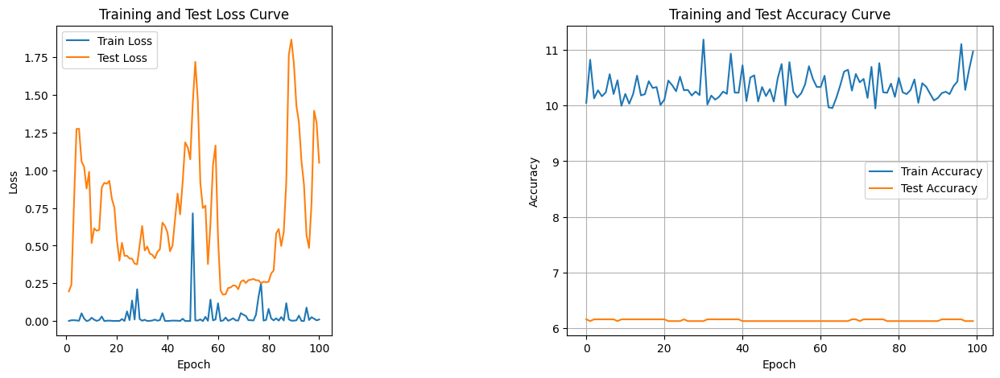

./saved_modelsmodel_72.pth
70


Training Process: 100%|██████████| 100/100 [00:02<00:00, 33.66it/s]


Total Epochs: 100
Train loss start: 0.0010088018607348204, Train loss end: 5.3100047807674855e-05
Highest Train Accuracy: 15.0
Test loss start: 0.587315559387207, Test loss end: 0.9390105605125427
Highest Test Accuracy: 10.8125


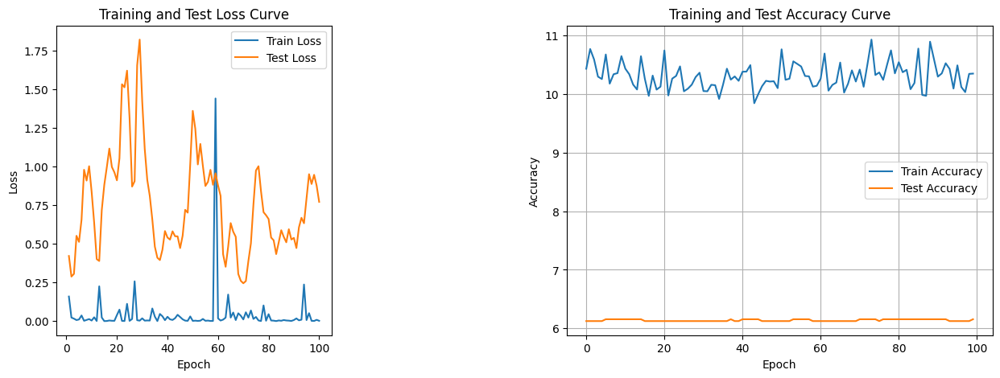

./saved_modelsmodel_70.pth
68


Training Process: 100%|██████████| 100/100 [00:02<00:00, 34.49it/s]


Total Epochs: 100
Train loss start: 0.005204308312386274, Train loss end: 0.00015847109898459166
Highest Train Accuracy: 15.8125
Test loss start: 0.6619958281517029, Test loss end: 1.3517837524414062
Highest Test Accuracy: 10.8125


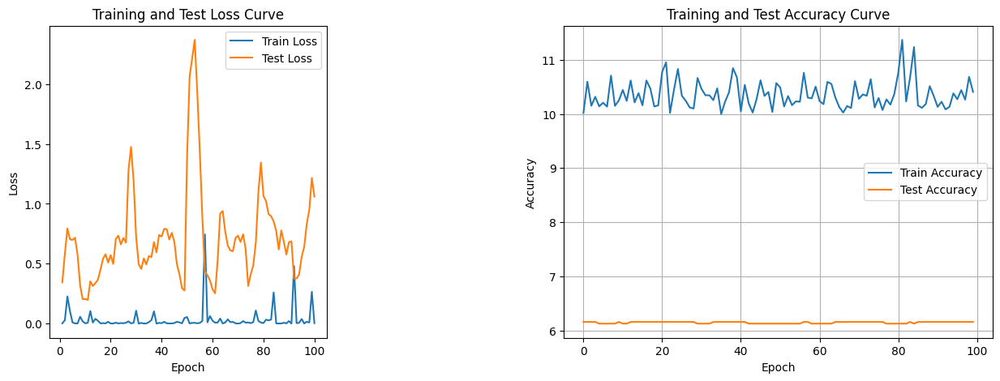

./saved_modelsmodel_68.pth
66


Training Process: 100%|██████████| 100/100 [00:03<00:00, 32.54it/s]


Total Epochs: 100
Train loss start: 0.005846652667969465, Train loss end: 0.0005332122673280537
Highest Train Accuracy: 16.6875
Test loss start: 0.850363552570343, Test loss end: 0.4968855679035187
Highest Test Accuracy: 10.8125


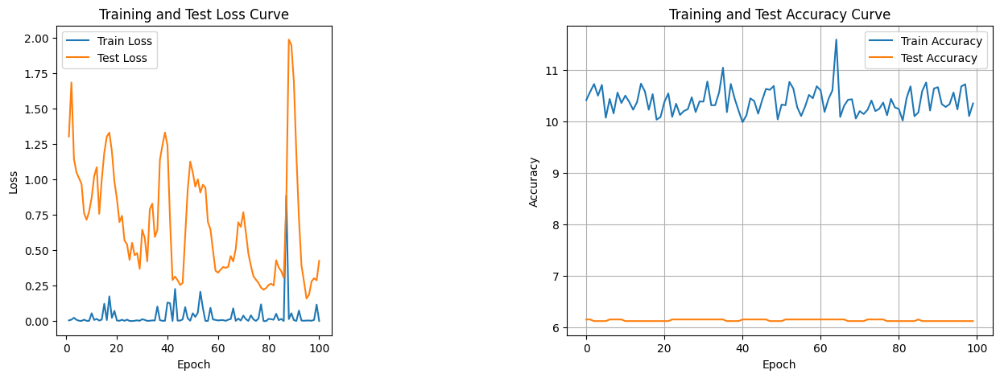

./saved_modelsmodel_66.pth


MLP(
  (layers): ModuleList(
    (0): Linear(in_features=13, out_features=256, bias=True)
    (1): Linear(in_features=256, out_features=128, bias=True)
    (2): Linear(in_features=128, out_features=64, bias=True)
    (3): Linear(in_features=64, out_features=32, bias=True)
  )
  (batch_norms): ModuleList(
    (0): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (output): Linear(in_features=32, out_features=4, bias=True)
  (dropout): Dropout(p=0.5, inplace=False)
)

In [ ]:
coverDTEmlp64b.train_DTE()